# __Part A: Generative Adversarial Networks__

<a class="anchor" id="1"></a>
## <font color='#71a1e3'> __Problem Understanding__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">


### __What is GAN?__

Gan represnts Generative Adversarial Networks which is all about creating here. Generally it is harder compared to other deep learning fields.

The main focus of GAN is to generate data be it images or videos or music from scratch and generally what does GAN consist of?

GAN are algorithic architectures that uses 2 neural networks, putting one against the other. This is to generate new, synthetic instances of data that can be pass as real data.

Generally, widely use in image generation, voice generation etc. 

GAN also work with competition of two different parts

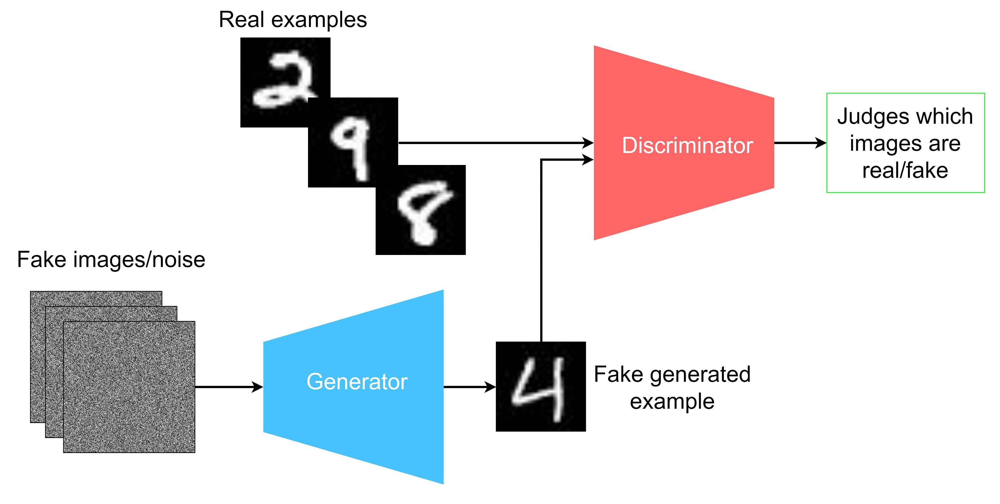

__Generator__
1. For this, you can input random images, known as random noise. This random images can be anything.
2. Through the generator, it will generate a sample that hopefully ends up like the real dataset if the generator and discrimintor and discriminator both are trained good enough
3. Output is sometimes refered to as latent space or a latent vector

What can we do to optimise?
1. Output must be pass through the generator through the discriminator, which then backpropagate and calculate the erros both the generator and discriminator 
2. Gan is also a form of decovolution and parameters, such as stride, padding, kernel size

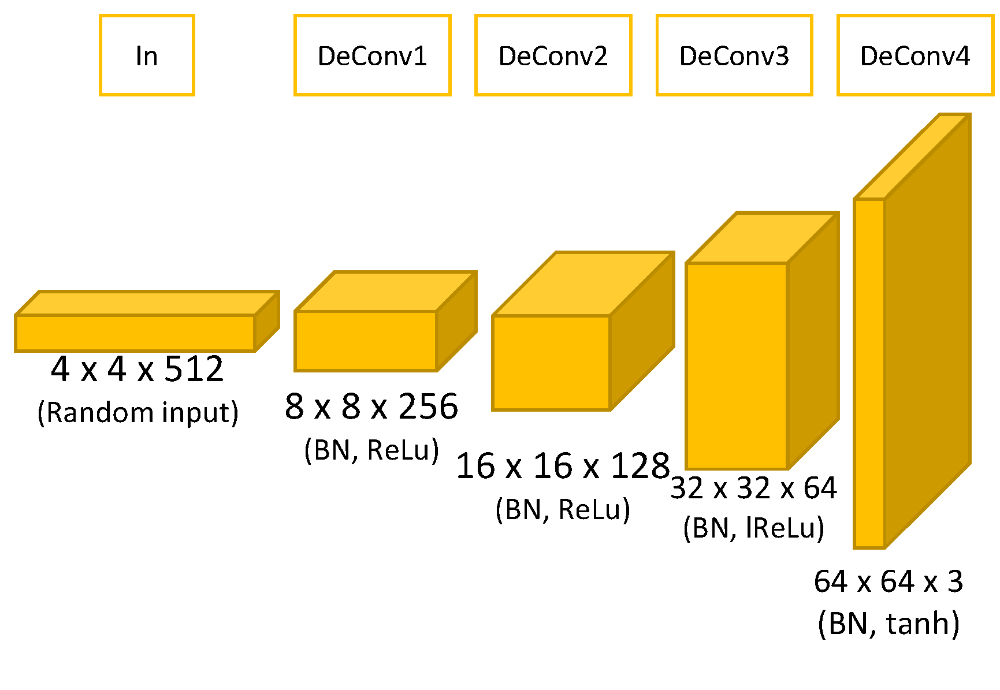

__Discriminator__ 
1. For this, input the real images from actual data tha needs to be generated like CIFAR1
2. Also, you input the output of generator into the discriminator
3. Convolutional layer of discrimnator is the normal convolution we are used to.
4. This are downscaled to the input that is suitable for classification. 

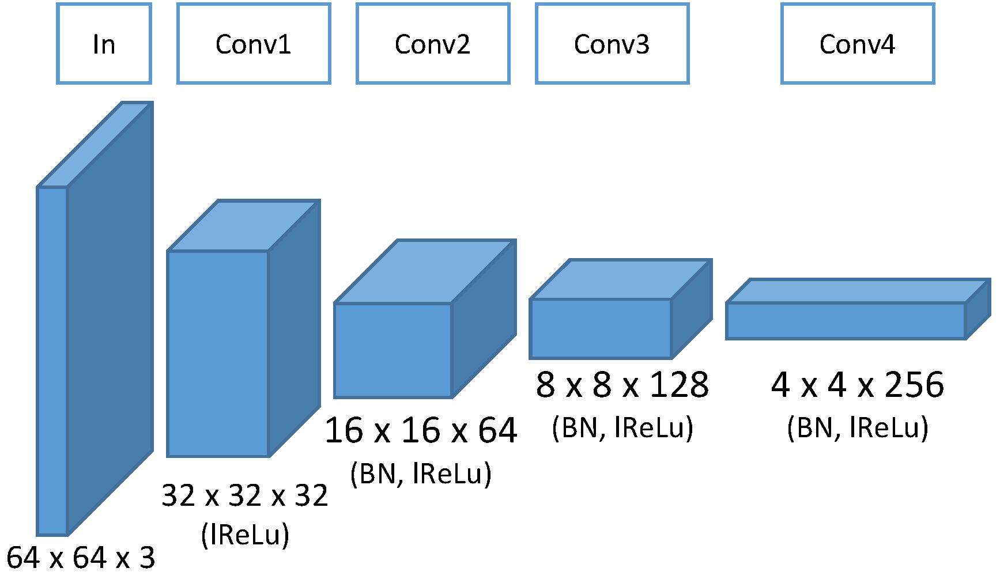


__How can we optimise both as a whole?__
After data is passed through both generator and discriminator, optimisation with backpropagation begins, the goal is to kepp improving at a level pace for both models to be good at its role, equilibrium point is exactly when the discriminator is leaning 50% to both sides, meaning that both images could either be real or fake, where the generator model tries to minimize the probability that the discriminator will predict the generator's output as fake. On the other side, the discriminator tries to maximize the probability that it will correctly classify both real and fake image

<a class="anchor" id="1"></a>
## <font color='#71a1e3'> __Import Libraries__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">


In [1]:
!pip install -q keras-tuner pandas matplotlib seaborn scikit-learn tqdm tensorflow_addons scikit-image 

You should consider upgrading via the '/usr/bin/python3 -m pip install --upgrade pip' command.


### Other Imports

In [2]:
import numpy as np
import pandas as pd

import seaborn as sns
from matplotlib import pyplot as plt

from sklearn.metrics import classification_report,accuracy_score, confusion_matrix
from sklearn.decomposition import PCA

from sklearn.preprocessing import Normalizer
from sklearn.metrics import classification_report, accuracy_score

import os, time, math, datetime, warnings, pytz, glob
from IPython.display import display
from functools import reduce
import absl.logging
from tqdm import tqdm
import logging
from scipy.linalg import sqrtm
from tqdm import tqdm
import matplotlib.pyplot as plt
from scipy.linalg import sqrtm
from skimage.transform import resize
import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec

absl.logging.set_verbosity(absl.logging.ERROR)
logging.getLogger('tensorflow').disabled = True
warnings.filterwarnings('ignore')

### Tensorflow Import

In [3]:
import tensorflow as tf
from tensorflow.keras.applications.inception_v3 import InceptionV3, preprocess_input
from tensorflow.keras.utils import Sequence, to_categorical
from tensorflow import expand_dims
from tensorflow.keras import Sequential
from tensorflow.keras import layers as L
from tensorflow.keras import backend as K
from tensorflow.image import random_flip_left_right, random_crop, resize_with_crop_or_pad
from tensorflow.keras.utils import to_categorical, plot_model
from tensorflow.keras.models import Model, load_model
from tensorflow.keras.layers import (Embedding, Dense, Input, InputLayer, Normalization, Flatten,BatchNormalization,
    Dropout,Conv2D, GlobalAveragePooling2D, MaxPooling2D, ReLU, Layer,Activation, Multiply, AveragePooling2D,
    Add, RandomRotation,Resizing, Rescaling, Reshape, Concatenate, concatenate, Lambda,LeakyReLU)
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, LearningRateScheduler, ReduceLROnPlateau, TerminateOnNaN, TensorBoard, CSVLogger, Callback
from tensorflow.keras.backend import clear_session
from tensorflow.keras.optimizers import RMSprop, SGD, Adam, Adagrad, Adamax
from tensorflow.keras.regularizers import l2, L2
from tensorflow.keras.optimizers.schedules import *
from tensorflow.keras.metrics import FalseNegatives, categorical_crossentropy, sparse_categorical_crossentropy,BinaryCrossentropy
from tensorflow.keras.regularizers import l2
from tensorflow.keras.losses import CategoricalCrossentropy
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.image import *
from tensorflow_addons.optimizers import SWA
from tensorflow.keras.layers import Dense, Reshape, LeakyReLU, UpSampling2D, Conv2D
from tensorflow.keras.optimizers import Adam
from sklearn.metrics.pairwise import pairwise_kernels
from tensorflow.keras.applications.efficientnet import EfficientNetB0, preprocess_input
from tensorflow.keras.models import Model
from tensorflow.keras.layers import PReLU,Dense, GlobalAveragePooling2D, Input, Conv2DTranspose
from tensorflow.keras.utils import to_categorical
import tensorflow as tf
from tensorflow.keras.applications.resnet50 import ResNet50, preprocess_input
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Input
from tensorflow.keras.layers import Input, Conv2D, BatchNormalization, LeakyReLU, GlobalAveragePooling2D, Dense, Concatenate
from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.initializers import RandomNormal
from tensorflow_addons.layers import SpectralNormalization
import tensorflow as tf
from tensorflow.keras.applications.inception_v3 import InceptionV3, preprocess_input

from tensorflow.keras.datasets import cifar10
from kerastuner.tuners import Hyperband
from kerastuner import HyperModel
# Setting a seaborn style
sns.set(style="whitegrid")







### Set the seed of this notebook

In [4]:
seed = 32
tf.random.set_seed(seed)
np.random.seed(seed)

<a class="anchor" id="3"></a>
## <font color='#71a1e3'>__Check for GPU__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">

Here is check the available GPUs and set the memory growth

In [5]:
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        for gpu in gpus:
            tf.config.experimental.set_memory_growth(gpu, True)

        logical_gpus = tf.config.experimental.list_logical_devices('GPU')
        print(f"{len(gpus)} Physical GPUs, {len(logical_gpus)} Logical GPU")
    except RuntimeError as e:
        print(e)

1 Physical GPUs, 1 Logical GPU


In [6]:
!nvidia-smi

Wed Jan 31 08:37:34 2024       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.129.03             Driver Version: 535.129.03   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA GeForce RTX 4090        On  | 00000000:03:00.0 Off |                  Off |
|  0%   59C    P2             140W / 450W |   3971MiB / 24564MiB |     23%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

<a class="anchor" id="3"></a>
## <font color='#71a1e3'>__Import Dataset__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">


In [7]:
data = tf.keras.datasets.cifar10.load_data()
(x_train, y_train) , (x_test, y_test) = data

In [8]:
y_train = to_categorical(y_train)

In [9]:
x_train.shape

(50000, 32, 32, 3)

### Set the labels for the Classes

This is so that we are able to use it for EDA and model training later on

In [10]:
cifarLab = ["airplane", "automobile", "bird", "cat", "deer", "dog", "frog", "horse", "ship", "truck"]
class_labels = {idx: label for idx, label in enumerate(cifarLab)}
print(class_labels)

{0: 'airplane', 1: 'automobile', 2: 'bird', 3: 'cat', 4: 'deer', 5: 'dog', 6: 'frog', 7: 'horse', 8: 'ship', 9: 'truck'}


<a class="anchor" id="3"></a>
## <font color='#71a1e3'>__Feature Engineering__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">


Below is the idea of feature engineering

1. **Convert Data Type**:
    ```python
    x_train = x_train.astype('float32')
    ```
    This line converts the data type of `x_train` elements to `float32`. It's a standard practice to use floating-point numbers in computations involving neural networks due to their capability to represent decimal values, which are crucial for the granularity of learning.

2. **Scale the Data**:
    ```python
    x_train /= (255/2)
    ```
    Here, the pixel values of the images (assuming `x_train` contains image data) are scaled. Usually, image data comes in the format of integers ranging from 0 to 255 (8-bit representation). This operation scales the data to a new range. Dividing by `(255/2)` scales the data to a range of [0, 2].

3. **Shift the Data**:
    ```python
    x_train -= 1
    ```
    This operation shifts the data range from [0, 2] to [-1, 1]. Shifting data to be centered around zero (mean = 0) can significantly improve the convergence during training, as it ensures that the input features have similar scales.




In [11]:
x_train = x_train.astype('float32')
x_train /= (255/2)
x_train -= 1


<a class="anchor" id="3"></a>
## <font color='#71a1e3'>__Evaluation Metrics__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">


### KID (Kernel Inception Distance)
1. Metrics used for evaluting the quality of images generated by GAN. This measures the similarity between two sets of images by comparing the statistics of deep features. These uses the pre trained Inception model

   $$
   MMD^2 = \frac{1}{m^2} \sum_{i=1}^{m} \sum_{j=1}^{m} K(x_i, x_j) + \frac{1}{n^2} \sum_{i=1}^{n} \sum_{j=1}^{n} K(y_i, y_j) - \frac{2}{mn} \sum_{i=1}^{m} \sum_{j=1}^{n} K(x_i, y_j)
   $$

- Compute the kernel metrics using kernel function
- Calculate the mean Maximum Mean Discrepancy
- Final average KID values computed over entire dataset
### FID
- Metrics that compares the statistics of generated images to real images in the feature space of a deep learning model (Inception model) and calculate the distance betwen the feature vectors of the real and generated images, lower FID implies that better quality of generated images

$$
FID = ||\mu_x - \mu_y||^2 + Tr(\Sigma_x + \Sigma_y - 2(\Sigma_x \Sigma_y)^{1/2})
$$
- Includes the Euclidean distance between mean vectors of real and generated images
- Tr denotes the trace of matrix
$$
(\Sigma_x \Sigma_y)^{1/2}
$$
 Denotes the sqaure root of the product of the covariance matrices which is computed using methods eigen decomposition




In [12]:

class Evaluation:
    def __init__(self, generator, latent_dim, sizeOfBatch, sample_size, sizeOfBuffer):
        self.generator = generator
        self.latent_dim = latent_dim
        self.sizeOfBatch = sizeOfBatch
        self.sample_size = sample_size
        self.sizeOfBuffer = sizeOfBuffer

        self.inception_model = InceptionV3(include_top=False, pooling='avg', input_shape=(299, 299, 3))
        self.AUTO = tf.data.experimental.AUTOTUNE

    def generate_images(self, num_images,labels=None):
        print(labels)
        if labels is not None:
            random_latent_vectors = tf.random.normal(shape=(num_images, self.latent_dim))
            labels = tf.one_hot(labels, depth=10) 
            generated_images = self.generator.predict([random_latent_vectors, labels])
        else:
            random_latent_vectors = tf.random.normal(shape=(num_images, self.latent_dim))
            generated_images = self.generator.predict(random_latent_vectors)
        return generated_images

    def plot_loss_curve(self, history, title='Loss Curve'):
        plt.figure(figsize=(10, 5))
        plt.plot(history['g_loss'], label='Generator Loss')
        plt.plot(history['d_loss'], label='Discriminator Loss')
        plt.title(title)
        plt.xlabel('Epochs')
        plt.ylabel('Loss')
        plt.legend()
        plt.grid(True)
        plt.show()

    def compute_metrics(self, train_data,cgan=False):
        real_images = tf.data.Dataset.from_tensor_slices(train_data).shuffle(self.sizeOfBuffer).batch(self.sizeOfBatch).map(self.__scale_and_preprocess).prefetch(self.AUTO)
        
        if cgan:
            class_labels = np.arange(10)
            class_labels = np.repeat(class_labels, self.sample_size / 10).flatten()
            generated_images = self.generate_images(self.sample_size, class_labels)
            generated_images = tf.data.Dataset.from_tensor_slices(generated_images).batch(self.sizeOfBatch).map(self.__scale_and_preprocess).prefetch(self.AUTO)
        else:
            generated_images = self.generate_images(self.sample_size)
            generated_images = tf.data.Dataset.from_tensor_slices(generated_images).batch(self.sizeOfBatch).map(self.__scale_and_preprocess).prefetch(self.AUTO)
        real_embeddings = self.__compute_embeddings(real_images, math.ceil(len(train_data) / self.sizeOfBatch))
        generated_embeddings = self.__compute_embeddings(generated_images, math.ceil(self.sample_size / self.sizeOfBatch))

        # Calculate FID
        fid = self.__calculate_fid(real_embeddings, generated_embeddings)
        kid = self.__calculate_kid(real_embeddings, generated_embeddings)
        return fid, kid

        
    def __calculate_kid(self,real_embeddings, generated_embeddings):
        kernel_real = pairwise_kernels(real_embeddings, metric='polynomial', degree=3)
        kernel_gen = pairwise_kernels(generated_embeddings, metric='polynomial', degree=3)
        kernel_real_gen = pairwise_kernels(real_embeddings, generated_embeddings, metric='polynomial', degree=3)

        m = real_embeddings.shape[0]
        n = generated_embeddings.shape[0]
        kid = (np.sum(kernel_real) / (m * (m - 1)) +
               np.sum(kernel_gen) / (n * (n - 1)) -
               2 * np.sum(kernel_real_gen) / (m * n))
        return kid
    def __scale_and_preprocess(self, image):
        image = (image + 1) / 2 * 255.0
        image = preprocess_input(image)
        return tf.image.resize(image, (299, 299))

    def __compute_embeddings(self, dataloader, count):
        embeddings = []
        for batch in (dataloader.take(count)):
            batch_embeddings = self.inception_model.predict(batch, verbose=0)
            embeddings.extend(batch_embeddings)
        return np.array(embeddings)

    def __calculate_fid(self, real_embeddings, generated_embeddings):
        mu1, sigma1 = real_embeddings.mean(axis=0), np.cov(real_embeddings, rowvar=False)
        mu2, sigma2 = generated_embeddings.mean(axis=0), np.cov(generated_embeddings, rowvar=False)
        ssdiff = np.sum((mu1 - mu2)**2.0)
        covmean = sqrtm(sigma1.dot(sigma2))
        if np.iscomplexobj(covmean):
            covmean = covmean.real
        return ssdiff + np.trace(sigma1 + sigma2 - 2.0 * covmean)


### Visual Approach
1. Even with metrics above, human approach is required to be able to see and tell what the images is 
2. Below function is to generate 1000 images to be able to view the diversity and how well the image is representing the data

In [13]:
def generate_1000(generator, num_iterations=10, saveDisk=False):
    for iteration in range(num_iterations):
        latent_z = np.random.normal(size=(100, 128))
        imgs = generator.predict(latent_z)
        fig, axes = plt.subplots(10, 10, figsize=(30, 30)) 
        fig.patch.set_facecolor('#abdbe3')
        fig.subplots_adjust(left=0.05, right=0.95, bottom=0.05, top=0.95, hspace=0.1, wspace=0.1)
        
        for idx, ax in enumerate(axes.flatten()):
            ax.imshow((imgs[idx] + 1) / 2, interpolation='nearest')
            ax.axis('off')
    
        if saveDisk:
            plt.savefig(f'generated_images_set_{iteration + 1}.png', bbox_inches='tight', pad_inches=0.5)  # Adjust padding
        else:
            plt.show()

        plt.close(fig) 

In [15]:
import tensorflow as tf
model_c = tf.keras.models.load_model('efficientNetClassifier.h5')


<a class="anchor" id="3"></a>
## <font color='#71a1e3'>__Baseline Model (DCGAN)__</font>
<hr style="height:1.5px;border-width:0;background-color: #4c8c77">



## __Key Ideas__
- Uses convolutional and convolutional-transpose layers in the generator and discriminator, respectively
- Discriminator consists of strided convolution layers, batch normalization layers, and LeakyRelu as activation function
- Propose certain arc guidelines to stabalise the training of GAN
- The changes is generally on the model architecture itself rather than the training step here
- One of the most early methods
- Weights can be use as random noise too

Below shows how it generally looks like 

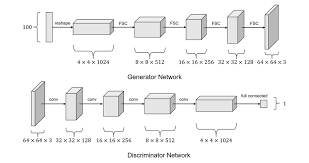






### Train Function

As the training is repetitive, i place the train gan function inside the a full function for ease of running later

In [14]:
def train_gan(d, g, latent_dim, model_name, data, e, learning_rate=2e-4, beta_1=0.5, use_multiprocessing=True, workers=16, callbacks=None):
    gan = DCGAN(discriminator=d,generator=g,latent_dim=128,model_name=model_name)
    gan.compile(
        d_optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1),
        g_optimizer=tf.keras.optimizers.Adam(learning_rate=learning_rate, beta_1=beta_1),
        loss_fn = BinaryCrossentropy(),
    )
    gan_hist = gan.fit(
        data,
        epochs=e,
        use_multiprocessing=True,
        workers=16,
        callbacks=callbacks
    )
    return gan_hist, gan


### Setting the full scores data

In [16]:
full_scores = pd.DataFrame()

### Defining the variables

In [17]:
sizeOfBatch = 64
AUTO = tf.data.AUTOTUNE
sizeOfBuffer = 1024
noise = 128
numberClass = 10
latent_dim = 128

### Creating the dataset

In [18]:
dataset = tf.data.Dataset.from_tensor_slices(x_train)
dataset = dataset.shuffle(buffer_size=sizeOfBuffer).batch(batch_size=sizeOfBatch, num_parallel_calls=AUTO).prefetch(AUTO)

### Training Loop and Callbacks

#### Model Training

- Below defines the DCGAN Model
- Standard approaches of training both discriminator and generator once each 
- Real and fake d loss was track together with d accuracy and g loss here

In [19]:
class DCGAN(tf.keras.Model):
    def __init__(self, model_name, discriminator, generator, latent_dim):
        super(DCGAN, self).__init__()
        self.model_name = model_name
        self.discriminator = discriminator
        self.generator = generator
        self.latent_dim = latent_dim
        self.d_fake_loss_metric = tf.keras.metrics.Mean(name="disc_fake_loss")
        self.d_real_loss_metric = tf.keras.metrics.Mean(name="disc_real_loss")
        self.g_loss_metric = tf.keras.metrics.Mean(name="gen_loss")
        self.d_acc_metric = tf.keras.metrics.BinaryAccuracy(name="disc_acc")

    def compile(self, d_optimizer, g_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.d_optimizer = d_optimizer
        self.g_optimizer = g_optimizer
        self.loss_fn = loss_fn
    
    def train_step(self, real_images):
        batch_s = tf.shape(real_images)[0]
        real_labels = tf.zeros((batch_s, 1))  

        # Training the discriminator
        with tf.GradientTape() as tape:
            real_predictions = self.discriminator(real_images)
            d_real_loss = self.loss_fn(real_labels, real_predictions)
            real_output = tf.reduce_mean(real_predictions)

        grads = tape.gradient(d_real_loss, self.discriminator.trainable_weights)
        self.d_optimizer.apply_gradients(zip(grads, self.discriminator.trainable_weights))

        # Training the generator
        random_latent_vectors = tf.random.normal(shape=(batch_s, self.latent_dim))
        generated_images = self.generator(random_latent_vectors)
        fake_labels = tf.ones((batch_s, 1)) 
        with tf.GradientTape() as tape:
            fake_predictions = self.discriminator(generated_images)
            d_fake_loss = self.loss_fn(fake_labels, fake_predictions)
            fake_output = tf.reduce_mean(fake_predictions)

        grads = tape.gradient(d_fake_loss, self.discriminator.trainable_weights)
        self.d_optimizer.apply_gradients(zip(grads, self.discriminator.trainable_weights))

        # Getting the prediction
        misleading_labels = tf.zeros((batch_s, 1))
        with tf.GradientTape() as tape:
            predictions = self.discriminator(self.generator(random_latent_vectors))
            g_loss = self.loss_fn(misleading_labels, predictions)

        grads = tape.gradient(g_loss, self.generator.trainable_weights)
        self.g_optimizer.apply_gradients(zip(grads, self.generator.trainable_weights))

        # Updating the metrics
        self.d_real_loss_metric.update_state(d_real_loss)
        self.d_fake_loss_metric.update_state(d_fake_loss)
        self.g_loss_metric.update_state(g_loss)
        self.d_acc_metric.update_state(tf.concat([real_labels, fake_labels], axis=0), tf.concat([real_predictions, fake_predictions], axis=0))

        return {
            "d_real_loss": self.d_real_loss_metric.result(),
            "d_fake_loss": self.d_fake_loss_metric.result(),
            "g_loss": self.g_loss_metric.result(),
            "d_acc": self.d_acc_metric.result(),
            "d_realO": real_output,
            "d_fakeO": fake_output
        }

#### Callback

- Two callback of image generation and checkpoint to save models was created here

In [20]:
class ImageGenerationCallback(tf.keras.callbacks.Callback):
    def __init__(self, num_img=10, noise=128,  vmin=-1, vmax=1):
        self.num_img = num_img
        self.noise = noise
        self.vmin = vmin
        self.vmax = vmax
        self.constant_noise = tf.random.normal(shape=(self.num_img, self.noise))
    
    # Generating the plot
    def generate_plot(self):
        generated_images = self.model.generator(self.constant_noise)
        generated_images = (generated_images - self.vmin) / (self.vmax - self.vmin)

        fig = plt.figure(figsize=(12, 6))
        gs = gridspec.GridSpec(2, 5)
        for i in range(self.num_img):
            ax = plt.subplot(gs[i])
            ax.imshow(generated_images[i, :, :, :])
            ax.axis('off')
        fig.patch.set_facecolor('#f0f0f0')  
        plt.suptitle("Generated Images", fontsize=16)
        plt.tight_layout(pad=0.4, w_pad=0.5, h_pad=1.0)
        plt.show()

    # Generate plots every 10 epoch
    def on_epoch_end(self, epoch, logs=None):
        if epoch % 10 == 0:
            self.generate_plot()

In [21]:
class ModelCheckpointCallback(tf.keras.callbacks.Callback):
    def __init__(self, save_freq=10, model_dir='GAN'):
        self.save_freq = save_freq
        self.model_dir = model_dir

    # Saving the weights
    def save(self, epoch=None):
        if epoch is not None:
            name = f'generator-{epoch}.h5'
            full_path = os.path.join(self.model_dir, name)
            os.makedirs(self.model_dir, exist_ok=True)
            self.model.generator.save(filepath=full_path, save_format='h5')
    
    # Saving after end 
    def on_train_end(self, logs=None):
        if not os.path.exists(self.model_dir):
            os.makedirs(self.model_dir)
        self.save('final')

    def on_epoch_end(self, epoch, logs=None):
        if epoch % self.save_freq == 0:
            self.save(epoch)



### First Model

##### Generator

__Key Ideas__
1. General approach is to create a generator that utilises upsample to see if results in a good model

__Model Arch__
 1. **Input and Reshape Layers**:
- **Dense Layer**: 
    - **Units**: 256 * 4 * 4
    - **Input**: `latent_dim` (the dimension of the latent space).

- **LeakyReLU**:
    - **Alpha**: 0.2

- **Reshape**:
    - **New Shape**: (4, 4, 256)

 2. **Convolutional Layers and Upsampling**:
- **UpSampling2D** (3 times):

- **Conv2D and LeakyReLU Pairs** (3 times):
    - **Filters**: 128 (for each Conv2D layer)
    - **Kernel Size**: (3, 3) (for each Conv2D layer)
    - **Padding**: 'same' (keeps the spatial dimensions constant after the operation)
    - **Activation (LeakyReLU)**: Alpha set to 0.2

 3. **Output Layer**:
- **Conv2D**:
    - **Filters**: 3 (representing RGB channels)
    - **Kernel Size**: (3, 3)
    - **Activation**: 'tanh'
    - **Padding**: 'same'

In [22]:
def build_generator(latent_dim):
    model = Sequential()
    n_nodes = 256 * 4 * 4
    model.add(Dense(n_nodes, input_dim=latent_dim))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Reshape((4, 4, 256)))

    model.add(UpSampling2D())
    model.add(Conv2D(128, (3, 3), padding='same'))
    model.add(LeakyReLU(alpha=0.2))

    model.add(UpSampling2D())
    model.add(Conv2D(128, (3, 3), padding='same'))
    model.add(LeakyReLU(alpha=0.2))

    model.add(UpSampling2D())
    model.add(Conv2D(128, (3, 3), padding='same'))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Conv2D(3, (3, 3), activation='tanh', padding='same'))
    return model

##### Discriminator
__Key Ideas__

 1. **Input Layer**:
   - **Conv2D**:
     - **Filters**: 64
     - **Kernel Size**: (3, 3)
     - **Padding**: 'same'
     - **Input Shape**: `in_shape` (the shape of the input images).

   - **LeakyReLU**:
     - **Alpha**: 0.2, allows a small gradient when the unit is inactive, promoting gradient flow during backpropagation.

2. **Convolutional Layers**:
   - Sequentially adding sets of Conv2D and LeakyReLU layers, increasing the number of filters and reducing the spatial dimensions of the feature maps using strides.
   - **First Set**:
     - **Conv2D**:
       - **Filters**: 128
       - **Kernel Size**: (3, 3)
       - **Strides**: (2, 2), reduces the spatial dimensions by half.
       - **Padding**: 'same'
     - **LeakyReLU**: Alpha set to 0.2

   - **Second Set**:
     - **Conv2D**:
       - **Filters**: 128
       - **Kernel Size**: (3, 3)
       - **Strides**: (2, 2)
       - **Padding**: 'same'
     - **LeakyReLU**: Alpha set to 0.2

   - **Third Set**:
     - **Conv2D**:
       - **Filters**: 256
       - **Kernel Size**: (3, 3)
       - **Strides**: (2, 2)
       - **Padding**: 'same'
     - **LeakyReLU**: Alpha set to 0.2

3. **Flattening and Dense Output Layer**:
   - **Flatten**: Converts the 3D feature maps to a 1D feature vector.
   - **Dropout**: 
     - **Rate**: 0.4, randomly sets a fraction of input units to 0, helping to prevent overfitting.
   - **Dense**:
     - **Units**: 1, the output layer with a single neuron for binary classification.
     - **Activation**: 'sigmoid'



In [23]:
def build_discriminator(in_shape = (32,32,3)):
    model = Sequential()

    model.add(Conv2D(64, (3,3), padding = 'same', input_shape = in_shape))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Conv2D(128,(3,3),strides = (2,2),padding = 'same'))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Conv2D(128,(3,3),strides = (2,2),padding = 'same'))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Conv2D(256,(3,3),strides = (2,2),padding = 'same'))
    model.add(LeakyReLU(alpha=0.2))

    model.add(Flatten())
    model.add(Dropout(0.4))
    model.add(Dense(1,activation = 'sigmoid'))

    opt = Adam(learning_rate = 0.0002, beta_1 = 0.5)
    model.compile(loss = 'binary_crossentropy',optimizer=opt,metrics=['accuracy'])
    return model

#### Creating Checkpoint

In [24]:
callbacks = [ImageGenerationCallback(num_img=10, noise=128, vmin=-1, vmax=1), ModelCheckpointCallback(model_dir='baselineDCGAN-1')]

#### Training

In [25]:
discriminator_dcgan1 = build_discriminator()
generator_dcgan1 = build_generator(128)

In [26]:
tf.keras.backend.clear_session()
K.clear_session()

Epoch 1/100
782/782 [==============================] - ETA: 0s - d_real_loss: 0.2965 - d_fake_loss: 0.4306 - g_loss: 3.5361 - d_acc: 0.8205 - d_realO: 0.0923 - d_fakeO: 0.8931

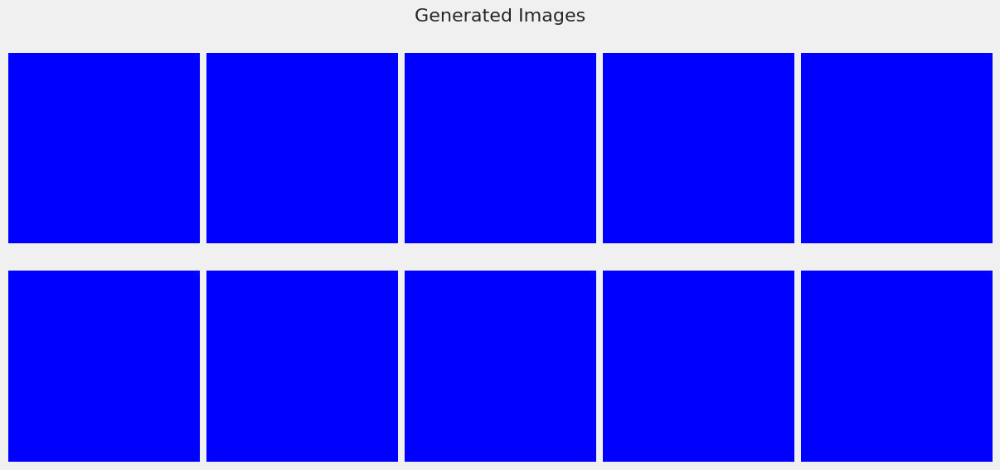

782/782 [==============================] - 22s 21ms/step - d_real_loss: 0.2963 - d_fake_loss: 0.4303 - g_loss: 3.5397 - d_acc: 0.8207 - d_realO: 0.0922 - d_fakeO: 0.8932
Epoch 2/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 1.3372e-04 - d_fake_loss: 3.6930e-05 - g_loss: 10.3394 - d_acc: 1.0000 - d_realO: 8.9496e-05 - d_fakeO: 1.0000
Epoch 3/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 2.2532e-05 - d_fake_loss: 6.9326e-06 - g_loss: 11.9592 - d_acc: 1.0000 - d_realO: 1.8470e-05 - d_fakeO: 1.0000
Epoch 4/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 6.5268e-06 - d_fake_loss: 2.1399e-06 - g_loss: 13.1219 - d_acc: 1.0000 - d_realO: 5.8925e-06 - d_fakeO: 1.0000
Epoch 5/100
782/782 [==============================] - 14s 18ms/step - d_real_loss: 2.3013e-06 - d_fake_loss: 7.7603e-07 - g_loss: 14.1335 - d_acc: 1.0000 - d_realO: 2.1295e-06 - d_fakeO: 1.0000
Epoch 6/100
782/782 [=============================

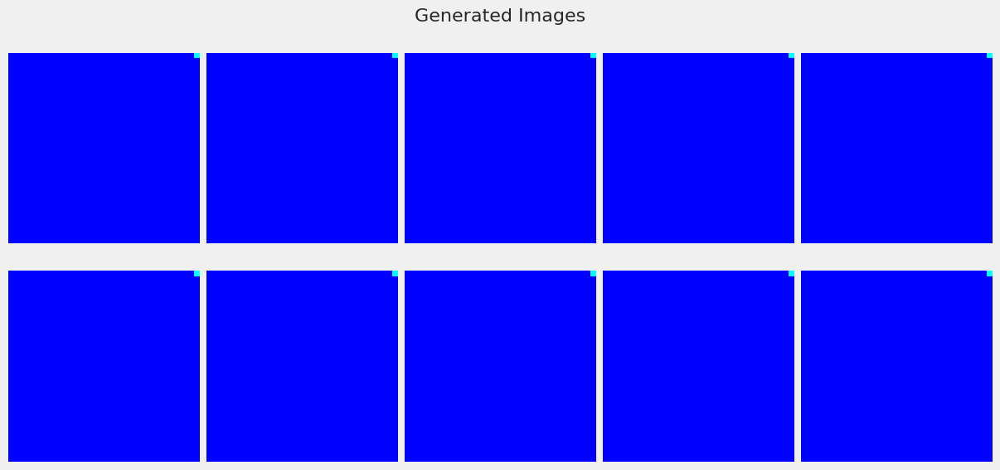

782/782 [==============================] - 16s 21ms/step - d_real_loss: 7.6728e-09 - d_fake_loss: 2.6712e-08 - g_loss: 17.4457 - d_acc: 1.0000 - d_realO: 9.5970e-09 - d_fakeO: 1.0000
Epoch 12/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 3.3594e-09 - d_fake_loss: 2.3921e-08 - g_loss: 17.5626 - d_acc: 1.0000 - d_realO: 4.4332e-09 - d_fakeO: 1.0000
Epoch 13/100
782/782 [==============================] - 14s 18ms/step - d_real_loss: 1.6166e-09 - d_fake_loss: 1.8072e-08 - g_loss: 17.8598 - d_acc: 1.0000 - d_realO: 2.2597e-09 - d_fakeO: 1.0000
Epoch 14/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 8.0274e-10 - d_fake_loss: 1.2586e-08 - g_loss: 18.2471 - d_acc: 1.0000 - d_realO: 1.0909e-09 - d_fakeO: 1.0000
Epoch 15/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 4.4015e-10 - d_fake_loss: 9.0449e-09 - g_loss: 18.5742 - d_acc: 1.0000 - d_realO: 6.2766e-10 - d_fakeO: 1.0000
Epoch 16/100
782/782 [===========

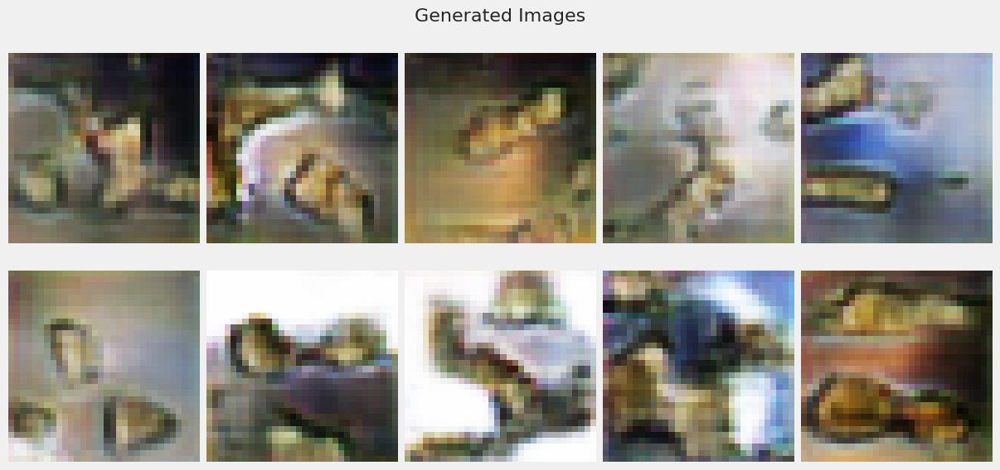

782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.6490 - d_fake_loss: 0.6378 - g_loss: 0.9732 - d_acc: 0.6265 - d_realO: 0.4581 - d_fakeO: 0.5392
Epoch 22/100
782/782 [==============================] - 14s 19ms/step - d_real_loss: 0.6726 - d_fake_loss: 0.6613 - g_loss: 0.8605 - d_acc: 0.5889 - d_realO: 0.4742 - d_fakeO: 0.5267
Epoch 23/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.6644 - d_fake_loss: 0.6568 - g_loss: 0.8875 - d_acc: 0.5993 - d_realO: 0.4691 - d_fakeO: 0.5304
Epoch 24/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.6626 - d_fake_loss: 0.6462 - g_loss: 0.9270 - d_acc: 0.6085 - d_realO: 0.4652 - d_fakeO: 0.5347
Epoch 25/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.6536 - d_fake_loss: 0.6372 - g_loss: 0.9428 - d_acc: 0.6203 - d_realO: 0.4624 - d_fakeO: 0.5374
Epoch 26/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.6662 - d_fa

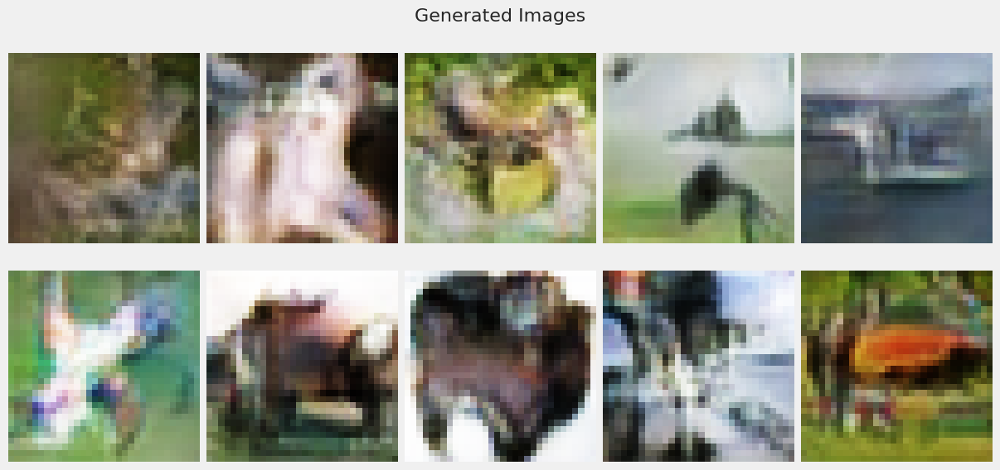

782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.6603 - d_fake_loss: 0.6505 - g_loss: 0.8870 - d_acc: 0.6052 - d_realO: 0.4676 - d_fakeO: 0.5329
Epoch 32/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.6571 - d_fake_loss: 0.6457 - g_loss: 0.9014 - d_acc: 0.6124 - d_realO: 0.4651 - d_fakeO: 0.5356
Epoch 33/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.6505 - d_fake_loss: 0.6397 - g_loss: 0.9109 - d_acc: 0.6224 - d_realO: 0.4613 - d_fakeO: 0.5387
Epoch 34/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.6484 - d_fake_loss: 0.6354 - g_loss: 0.9410 - d_acc: 0.6266 - d_realO: 0.4578 - d_fakeO: 0.5428
Epoch 35/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.6427 - d_fake_loss: 0.6263 - g_loss: 0.9552 - d_acc: 0.6360 - d_realO: 0.4528 - d_fakeO: 0.5478
Epoch 36/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.6357 - d_fa

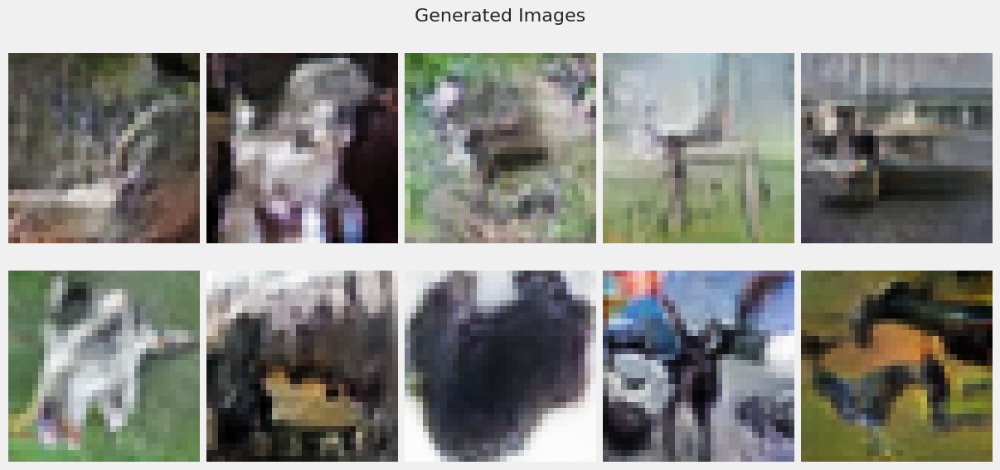

782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.6007 - d_fake_loss: 0.5759 - g_loss: 1.1324 - d_acc: 0.6816 - d_realO: 0.4151 - d_fakeO: 0.5847
Epoch 42/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.5948 - d_fake_loss: 0.5672 - g_loss: 1.1646 - d_acc: 0.6897 - d_realO: 0.4079 - d_fakeO: 0.5920
Epoch 43/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.5922 - d_fake_loss: 0.5646 - g_loss: 1.1810 - d_acc: 0.6912 - d_realO: 0.4033 - d_fakeO: 0.5963
Epoch 44/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.5822 - d_fake_loss: 0.5525 - g_loss: 1.2235 - d_acc: 0.6999 - d_realO: 0.3969 - d_fakeO: 0.6030
Epoch 45/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.5749 - d_fake_loss: 0.5440 - g_loss: 1.2486 - d_acc: 0.7066 - d_realO: 0.3916 - d_fakeO: 0.6079
Epoch 46/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.5694 - d_fa

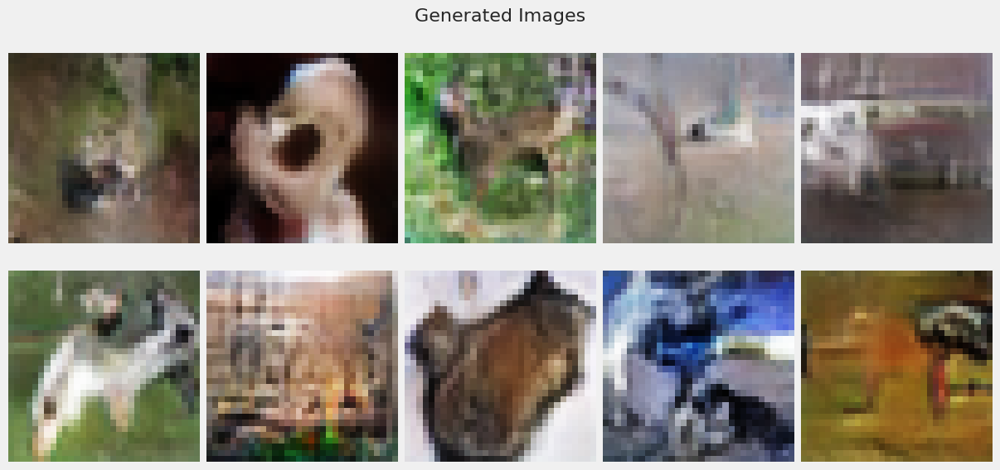

782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.5297 - d_fake_loss: 0.4966 - g_loss: 1.4600 - d_acc: 0.7436 - d_realO: 0.3533 - d_fakeO: 0.6463
Epoch 52/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.5233 - d_fake_loss: 0.4895 - g_loss: 1.4963 - d_acc: 0.7470 - d_realO: 0.3482 - d_fakeO: 0.6514
Epoch 53/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.5161 - d_fake_loss: 0.4839 - g_loss: 1.5180 - d_acc: 0.7523 - d_realO: 0.3436 - d_fakeO: 0.6563
Epoch 54/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.5072 - d_fake_loss: 0.4797 - g_loss: 1.5463 - d_acc: 0.7572 - d_realO: 0.3389 - d_fakeO: 0.6600
Epoch 55/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.5079 - d_fake_loss: 0.4783 - g_loss: 1.5908 - d_acc: 0.7589 - d_realO: 0.3358 - d_fakeO: 0.6641
Epoch 56/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.4927 - d_fa

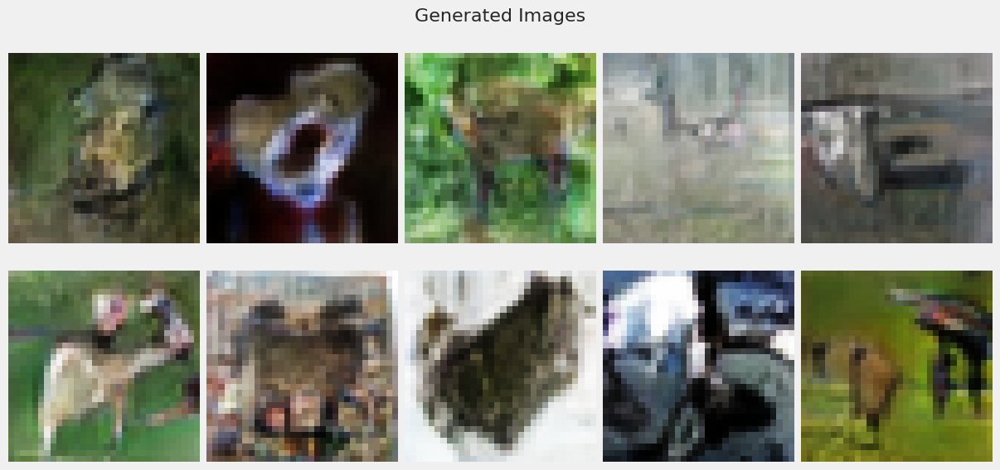

782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.4618 - d_fake_loss: 0.4328 - g_loss: 1.7997 - d_acc: 0.7867 - d_realO: 0.3021 - d_fakeO: 0.6982
Epoch 62/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.4507 - d_fake_loss: 0.4270 - g_loss: 1.8496 - d_acc: 0.7931 - d_realO: 0.2958 - d_fakeO: 0.7038
Epoch 63/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.4410 - d_fake_loss: 0.4178 - g_loss: 1.9002 - d_acc: 0.8004 - d_realO: 0.2892 - d_fakeO: 0.7106
Epoch 64/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.4337 - d_fake_loss: 0.4099 - g_loss: 1.9420 - d_acc: 0.8038 - d_realO: 0.2840 - d_fakeO: 0.7158
Epoch 65/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.4272 - d_fake_loss: 0.4047 - g_loss: 1.9805 - d_acc: 0.8078 - d_realO: 0.2791 - d_fakeO: 0.7210
Epoch 66/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.4165 - d_fa

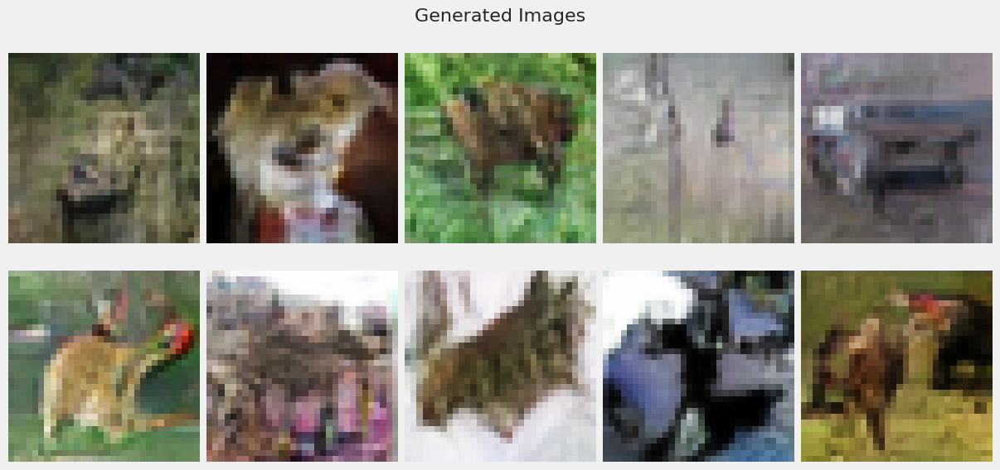

782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.3810 - d_fake_loss: 0.3669 - g_loss: 2.2746 - d_acc: 0.8319 - d_realO: 0.2482 - d_fakeO: 0.7513
Epoch 72/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.3756 - d_fake_loss: 0.3570 - g_loss: 2.3073 - d_acc: 0.8344 - d_realO: 0.2422 - d_fakeO: 0.7574
Epoch 73/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.3666 - d_fake_loss: 0.3535 - g_loss: 2.3740 - d_acc: 0.8401 - d_realO: 0.2381 - d_fakeO: 0.7620
Epoch 74/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.3558 - d_fake_loss: 0.3487 - g_loss: 2.4240 - d_acc: 0.8445 - d_realO: 0.2333 - d_fakeO: 0.7661
Epoch 75/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.3463 - d_fake_loss: 0.3367 - g_loss: 2.4775 - d_acc: 0.8496 - d_realO: 0.2275 - d_fakeO: 0.7722
Epoch 76/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.3429 - d_fa

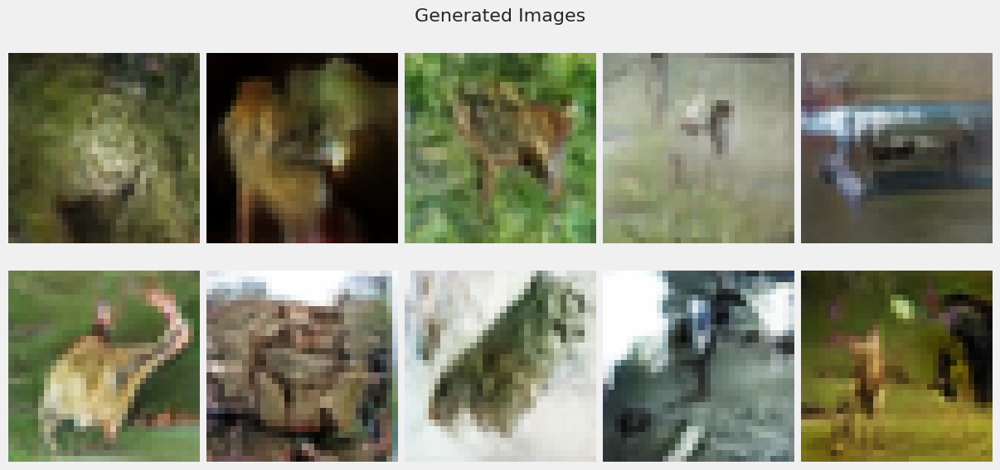

782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.3080 - d_fake_loss: 0.3027 - g_loss: 2.7977 - d_acc: 0.8676 - d_realO: 0.2010 - d_fakeO: 0.7989
Epoch 82/100
782/782 [==============================] - 14s 18ms/step - d_real_loss: 0.3042 - d_fake_loss: 0.3051 - g_loss: 2.8331 - d_acc: 0.8697 - d_realO: 0.1985 - d_fakeO: 0.8012
Epoch 83/100
782/782 [==============================] - 18s 23ms/step - d_real_loss: 0.3004 - d_fake_loss: 0.2998 - g_loss: 2.8699 - d_acc: 0.8715 - d_realO: 0.1961 - d_fakeO: 0.8034
Epoch 84/100
782/782 [==============================] - 19s 24ms/step - d_real_loss: 0.2941 - d_fake_loss: 0.2964 - g_loss: 2.9396 - d_acc: 0.8722 - d_realO: 0.1914 - d_fakeO: 0.8084
Epoch 85/100
782/782 [==============================] - 19s 24ms/step - d_real_loss: 0.2903 - d_fake_loss: 0.2935 - g_loss: 2.9777 - d_acc: 0.8749 - d_realO: 0.1881 - d_fakeO: 0.8117
Epoch 86/100
782/782 [==============================] - 17s 22ms/step - d_real_loss: 0.2878 - d_fa

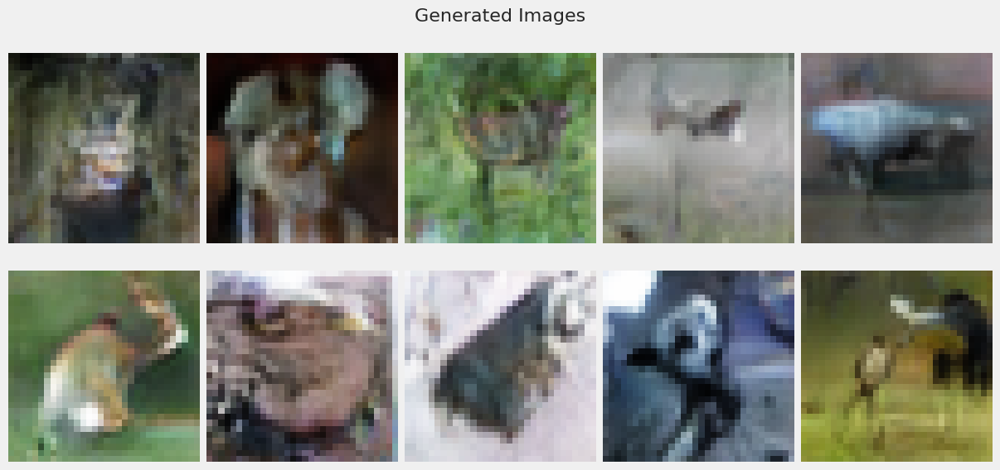

782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.2606 - d_fake_loss: 0.2746 - g_loss: 3.2706 - d_acc: 0.8882 - d_realO: 0.1718 - d_fakeO: 0.8280
Epoch 92/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.2538 - d_fake_loss: 0.2649 - g_loss: 3.2775 - d_acc: 0.8936 - d_realO: 0.1668 - d_fakeO: 0.8325
Epoch 93/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.2523 - d_fake_loss: 0.2653 - g_loss: 3.3294 - d_acc: 0.8918 - d_realO: 0.1645 - d_fakeO: 0.8353
Epoch 94/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.2517 - d_fake_loss: 0.2666 - g_loss: 3.3720 - d_acc: 0.8913 - d_realO: 0.1627 - d_fakeO: 0.8370
Epoch 95/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.2418 - d_fake_loss: 0.2578 - g_loss: 3.4493 - d_acc: 0.8990 - d_realO: 0.1600 - d_fakeO: 0.8400
Epoch 96/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.2354 - d_fa

In [27]:
gan_1= train_gan(discriminator_dcgan1, generator_dcgan1, noise, 'Baseline DCGAN 1', dataset, 100, callbacks=callbacks)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Looking at the accuracy, we can see that the discriminator ended with a  91% accuracy while it may not be the best, it did show that it is not able to fully determine real and fake as it started from 0.6
- No Model Collapse


</div>

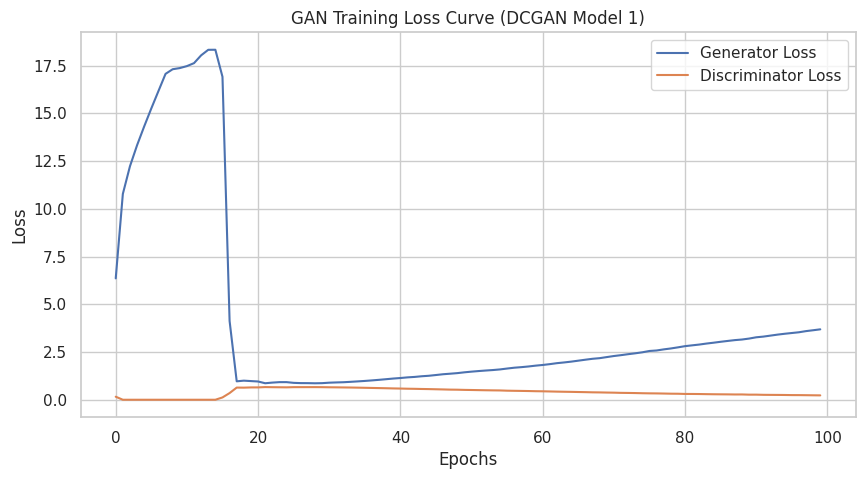

In [28]:
gan_history_1 = gan_1[0].history
generator = gan_1[1].generator  
gan_history_1['d_loss'] = [(real_loss + fake_loss) / 2 for real_loss, fake_loss in zip(gan_history_1['d_real_loss'], gan_history_1['d_fake_loss'])]
evaluator = Evaluation(generator, latent_dim, 512, 10000, 1024)
evaluator.plot_loss_curve(gan_history_1, title='GAN Training Loss Curve (DCGAN Model 1)')


<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Discriminator loss
    - For the discriminator loss, it starts relatively low and rises quickly and continues to increase steadily as the epochs increases
- Generator loss
    - For the generator loss, it increases with a spike and drops and proceeded to increase slowly


</div>

In [29]:
tf.keras.backend.clear_session()
K.clear_session()
scores1 = evaluator.compute_metrics(x_train)
print('FID Score:', scores1[0])
print('KID Score:', scores1[1])

None
313/313 [==============================] - 1s 3ms/step
FID Score: 53.23562302246138
KID Score: 0.03966577915401581


<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- FID Score of 53 
- KID Score is 0.04
    
Both are not too good, let us see if we can improve

</div>

2/2 [==============================] - 3s 318ms/step


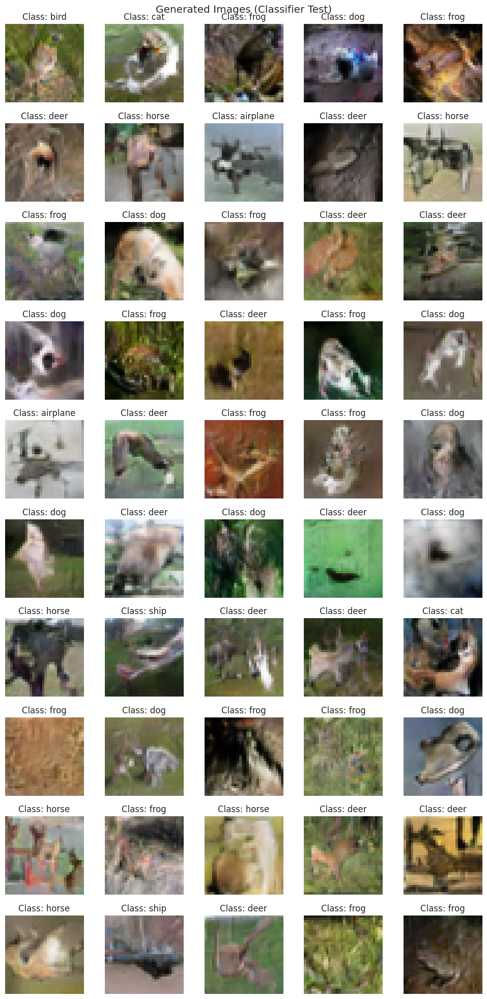

In [30]:
latent_dim = 128  
num_images = 50  
noise = tf.random.normal([num_images, latent_dim])
generated_images = generator.predict(noise)
generated_images = (generated_images + 1) / 2
generated_images = generated_images * 255
generated_images = np.clip(generated_images, 0, 255).astype('uint8')
generated_images_resized = tf.image.resize(generated_images, [224, 224]).numpy().astype('uint8')
predictions = model_c.predict(generated_images_resized)
predicted_classes = np.argmax(predictions, axis=-1)
num_columns = 5
num_rows = num_images // num_columns + (num_images % num_columns > 0)
fig, axes = plt.subplots(num_rows, num_columns, figsize=(num_columns * 2, num_rows * 2))
fig.suptitle('Generated Images (Classifier Test)')
for i, ax in enumerate(axes.flatten()):
    if i >= num_images:
        break
    ax.imshow(generated_images[i])
    ax.set_title(f'Class: {class_labels[predicted_classes[i]]}')
    ax.axis('off')
plt.tight_layout()
plt.show()

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Generally, we can tell most of the animal images like deer, dog but cars and ships images are not poroduced

</div>

#### Visualise the Images

4/4 [==============================] - 0s 23ms/step


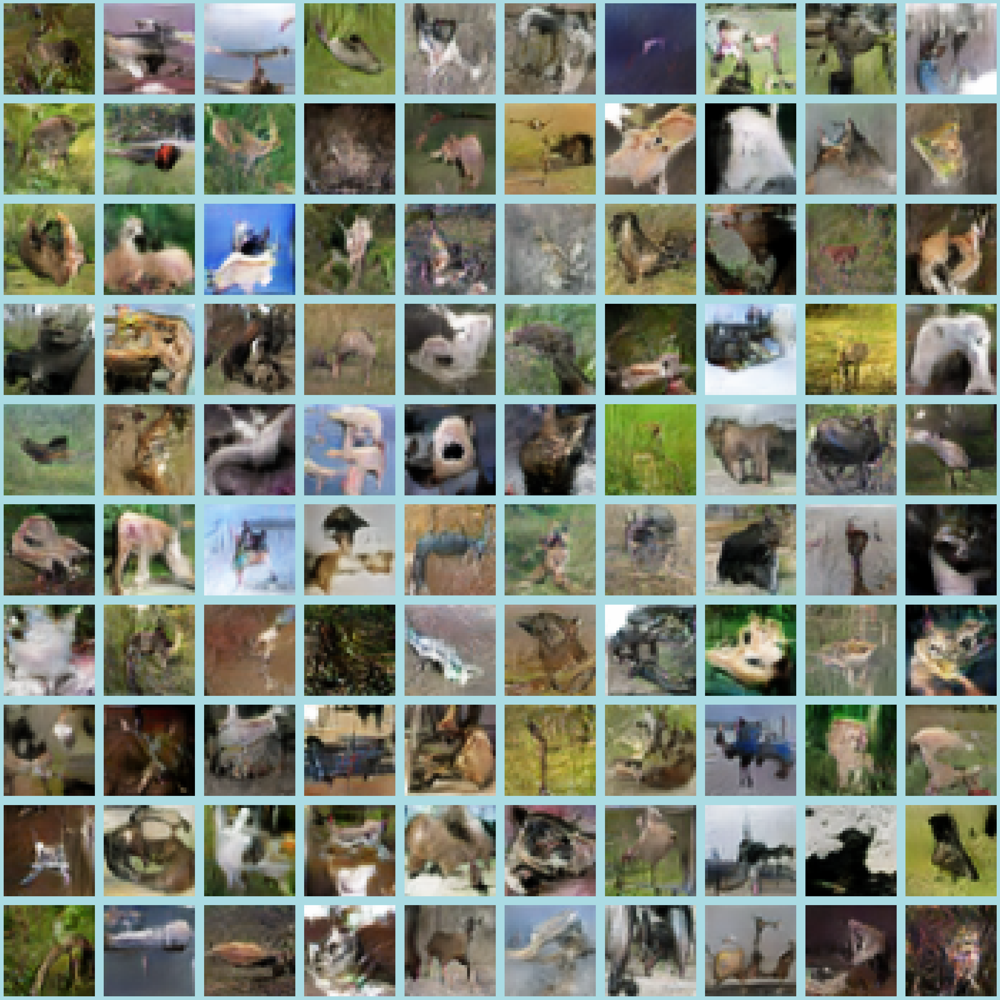

4/4 [==============================] - 0s 4ms/step


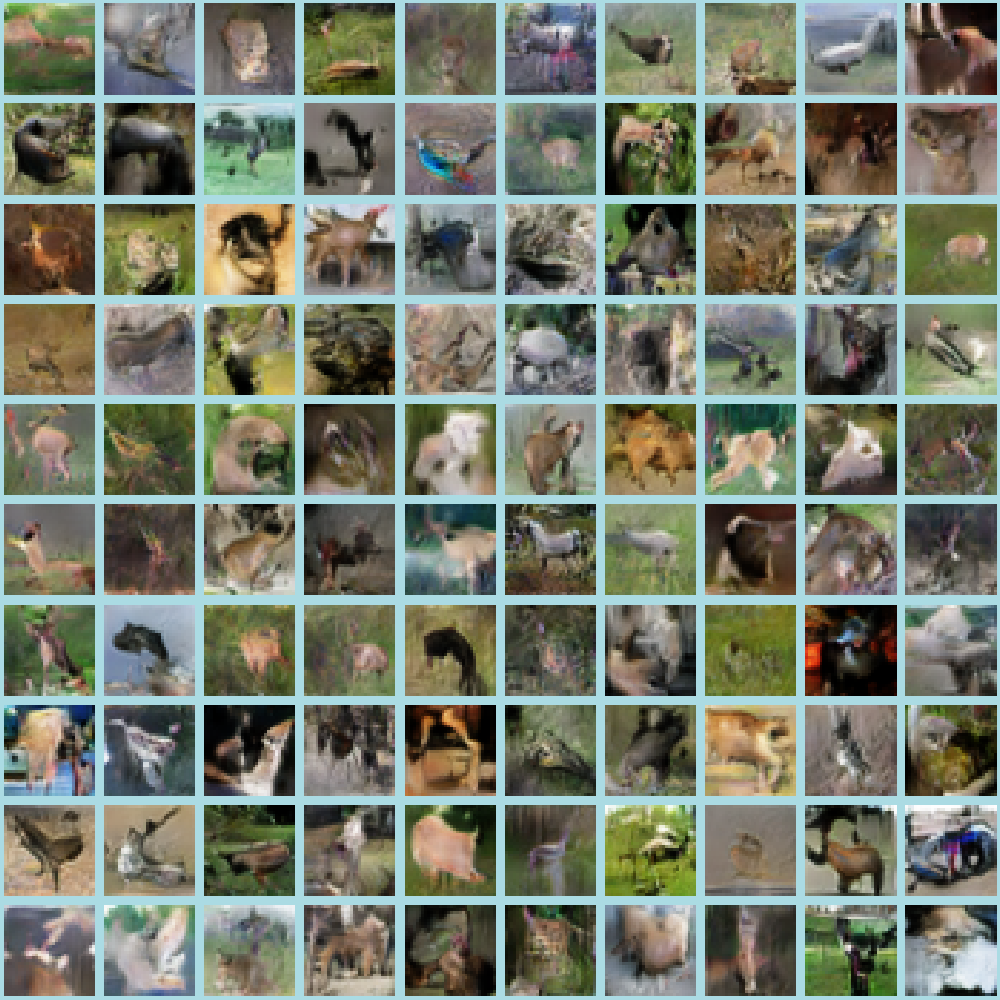

4/4 [==============================] - 0s 4ms/step


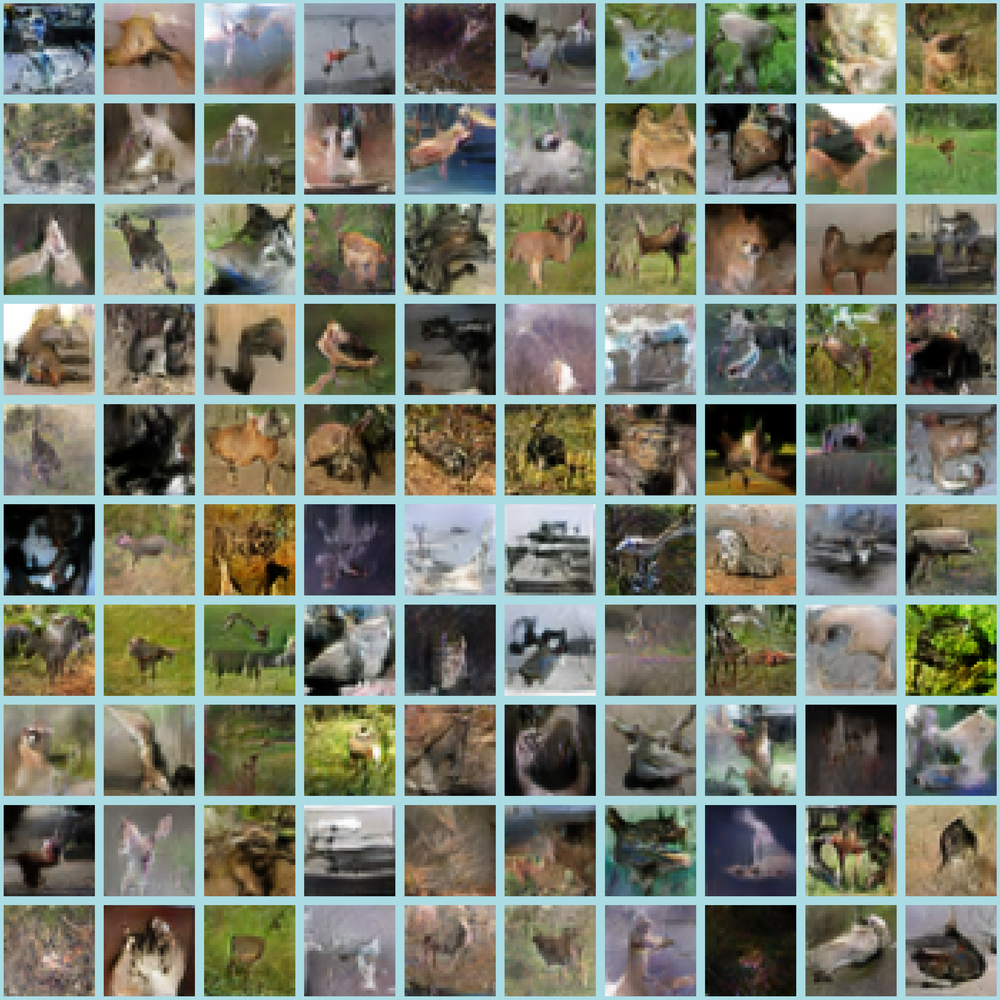

4/4 [==============================] - 0s 4ms/step


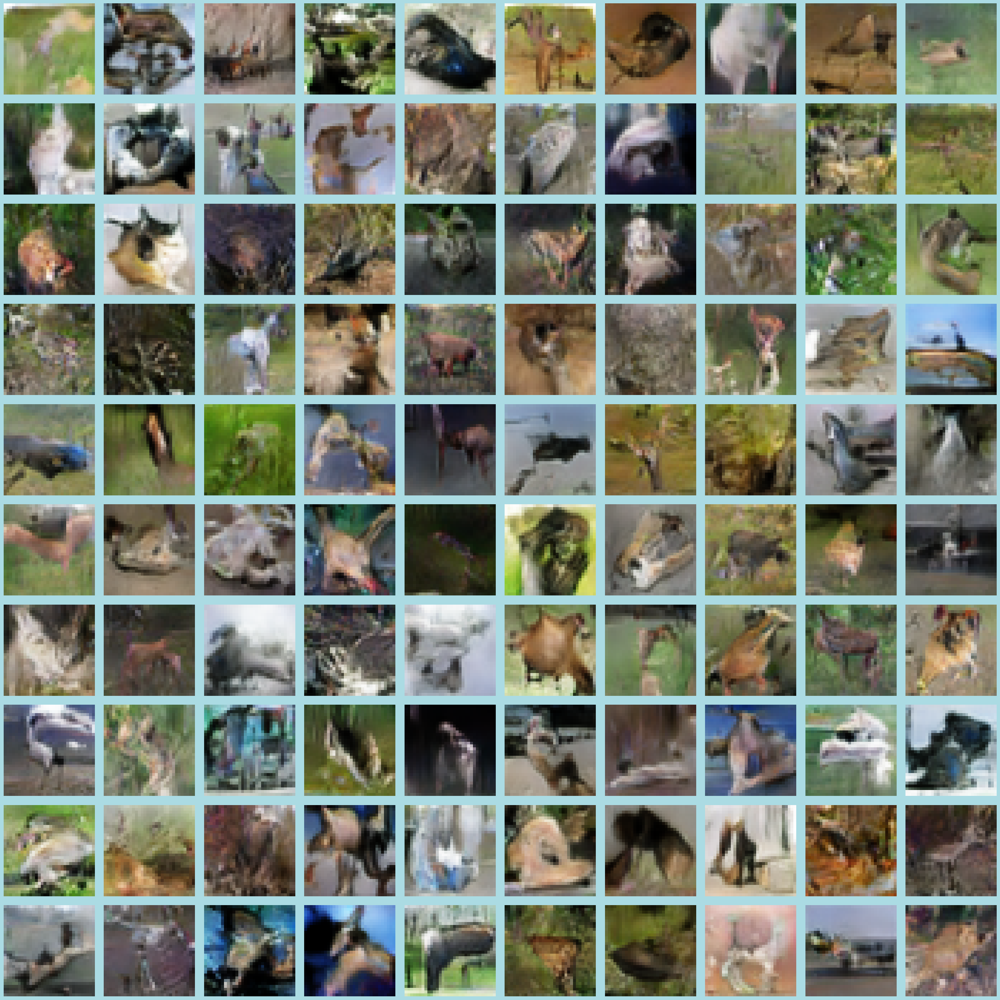

4/4 [==============================] - 0s 4ms/step


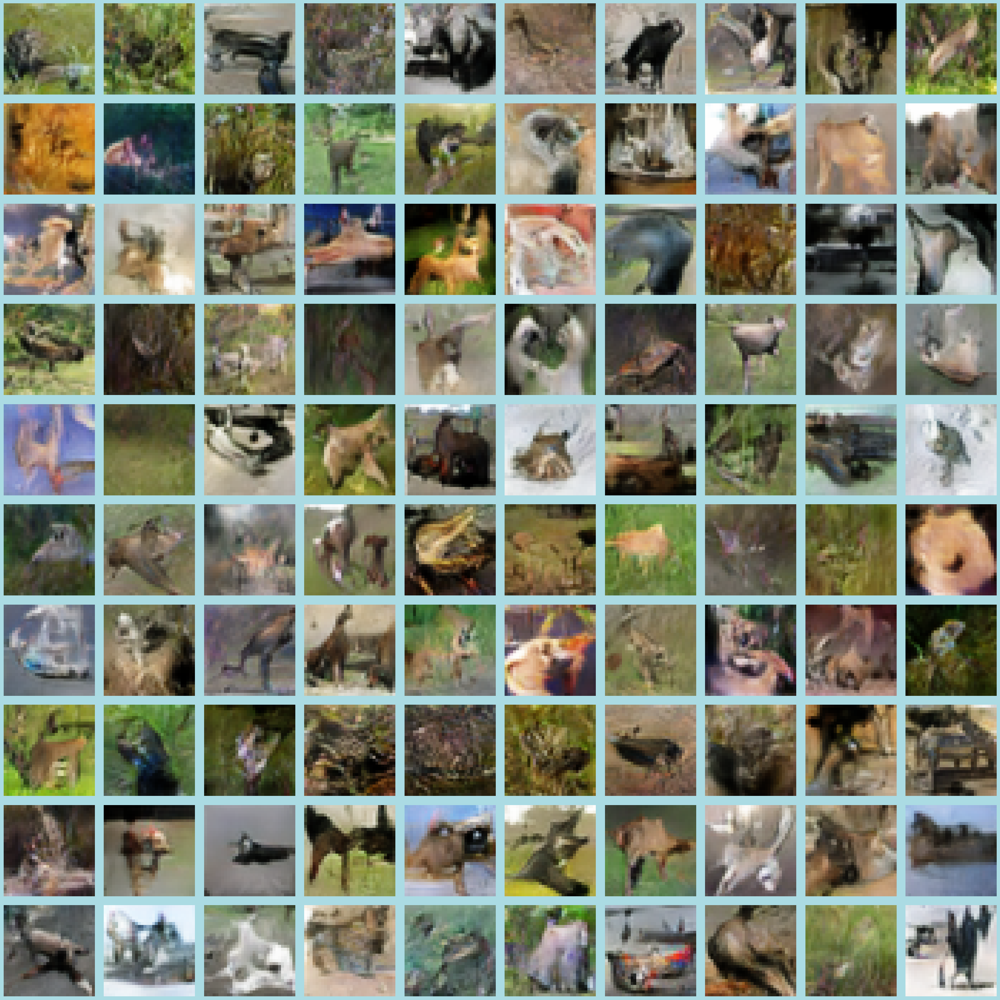

4/4 [==============================] - 0s 4ms/step


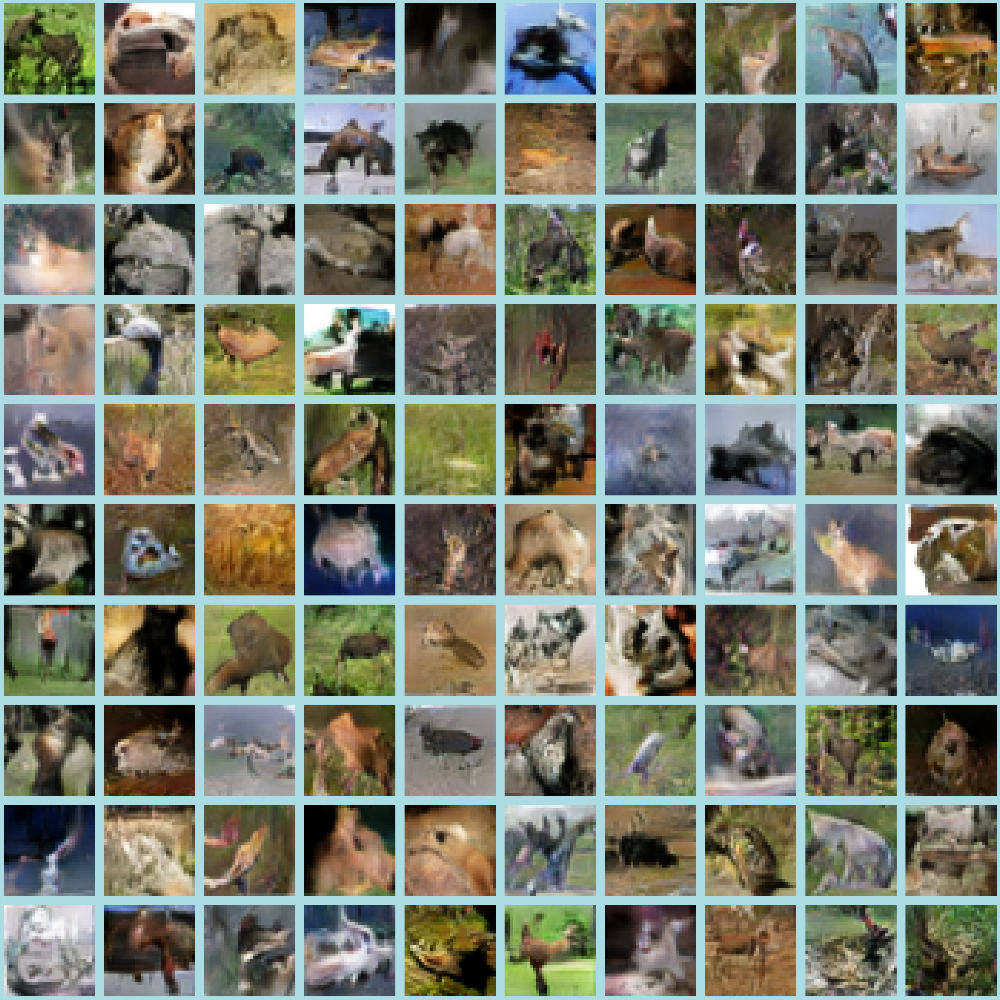

4/4 [==============================] - 0s 4ms/step


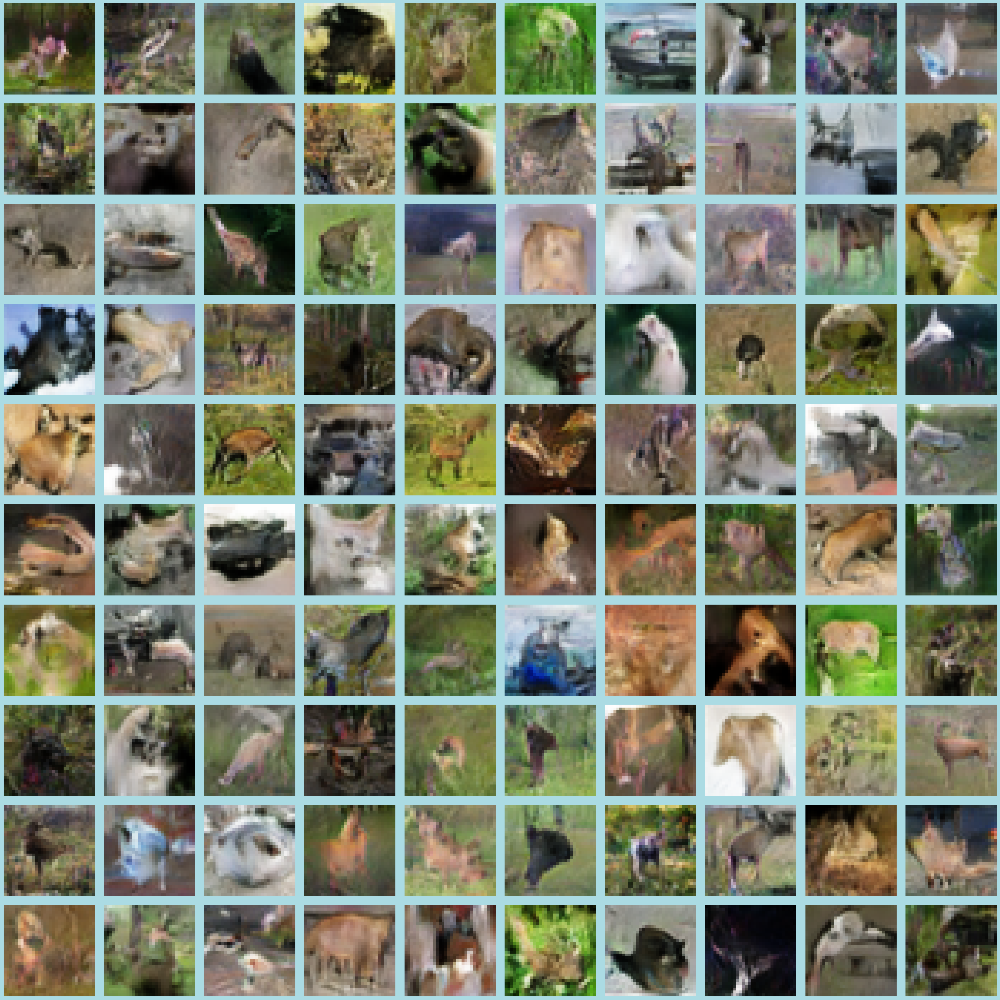

4/4 [==============================] - 0s 3ms/step


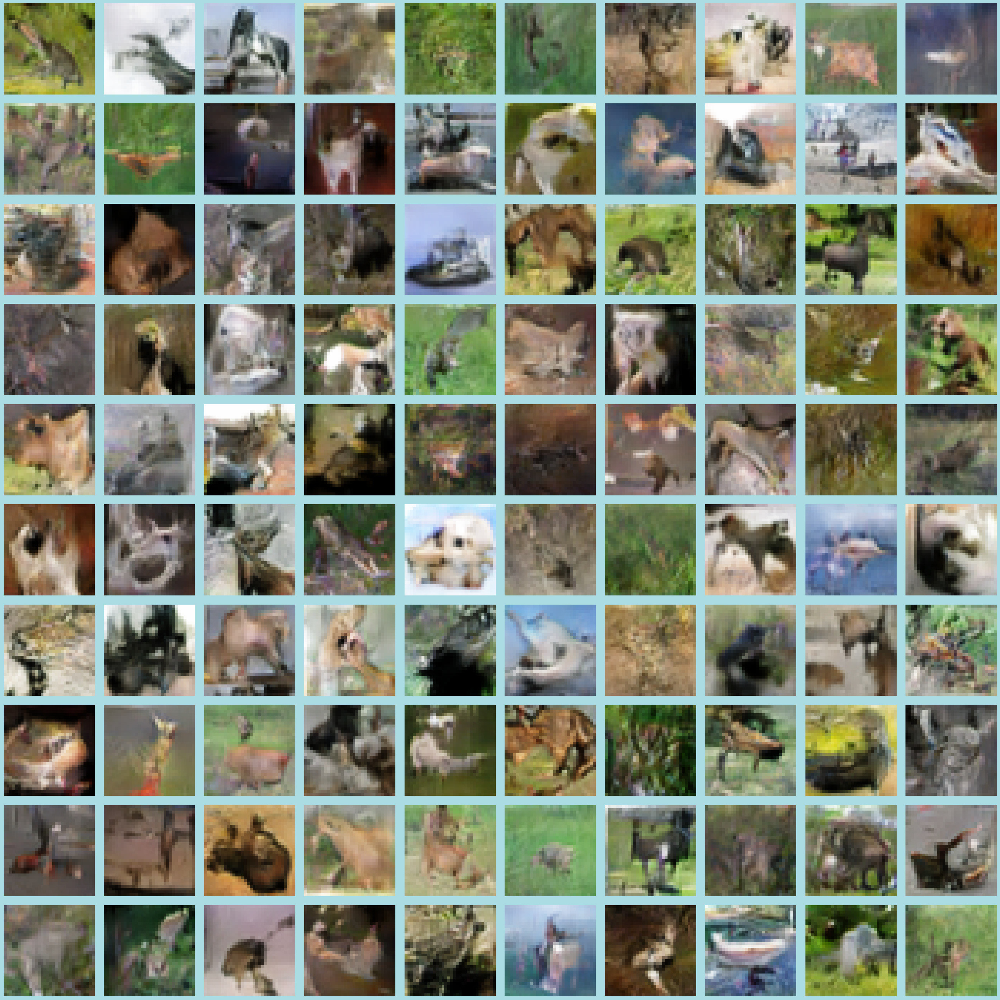

4/4 [==============================] - 0s 4ms/step


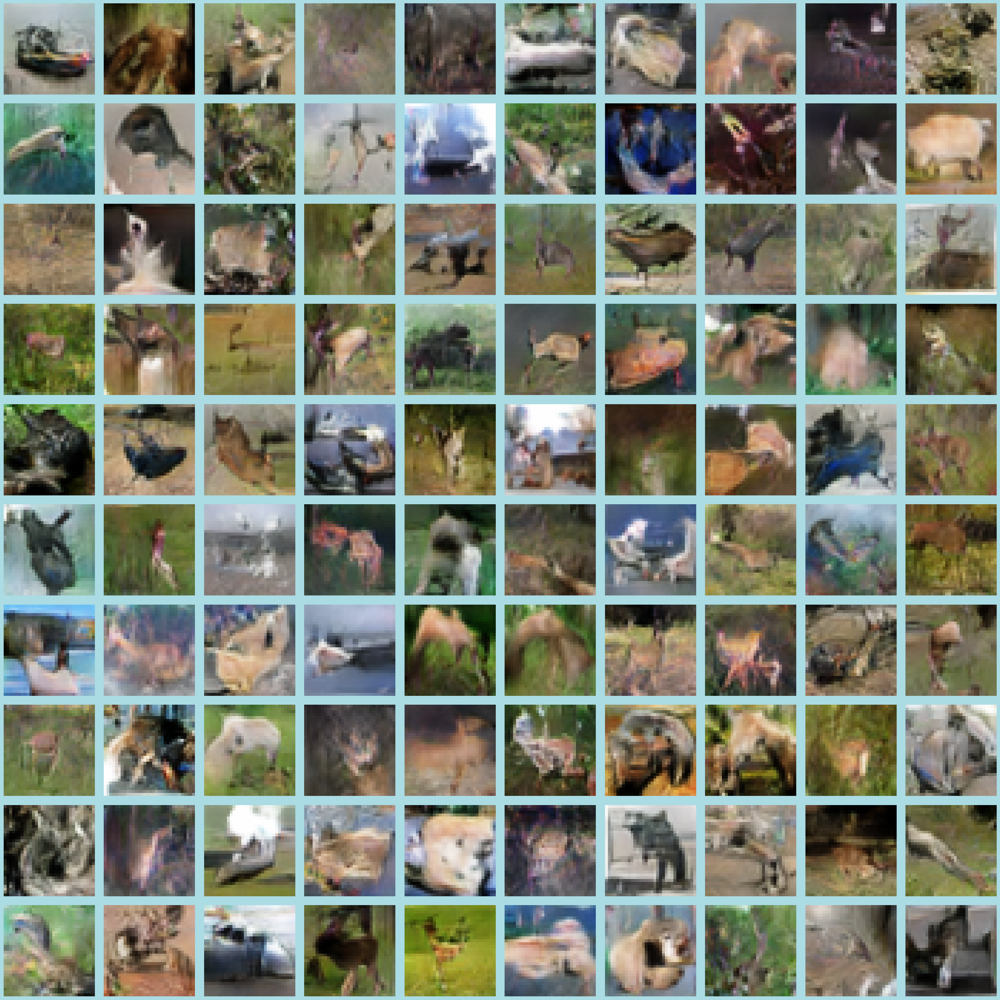

4/4 [==============================] - 0s 3ms/step


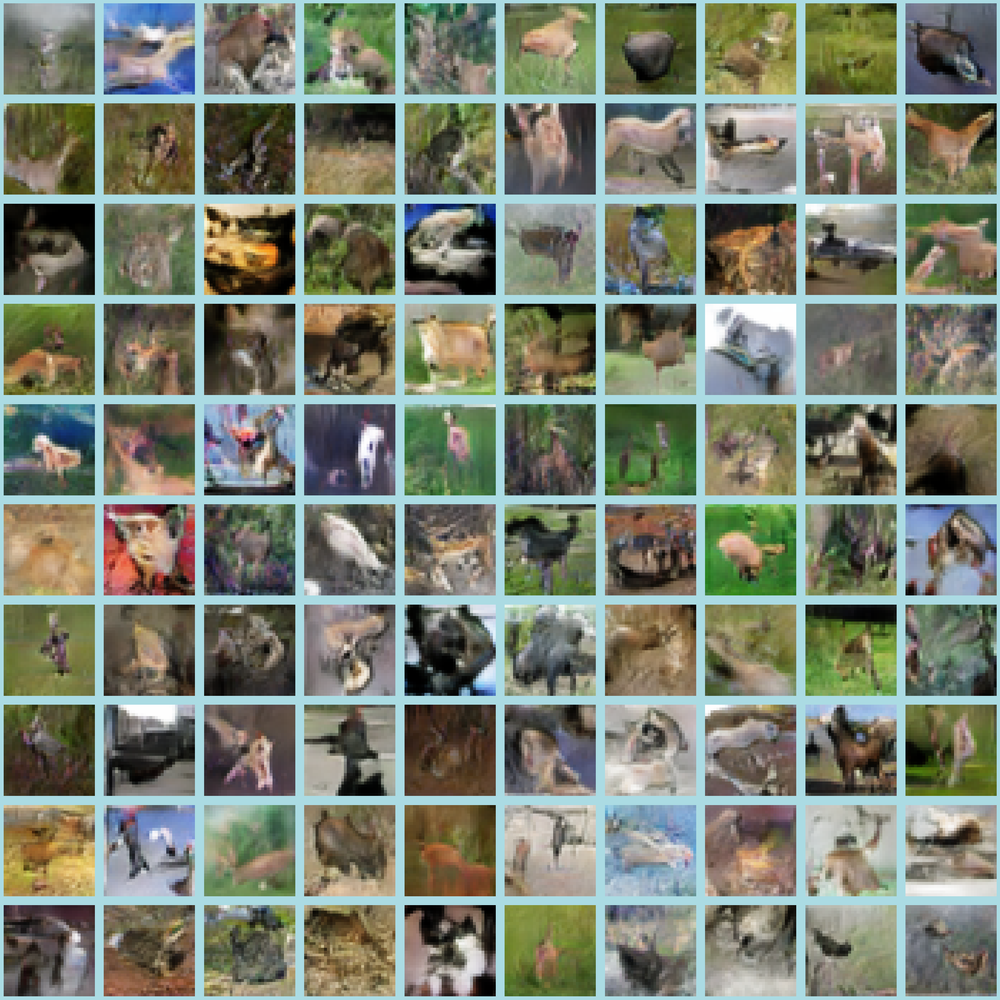

In [31]:
generate_1000(generator)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- 1000 images provided similar idea compared to comparing it with a classifier

</div>

#### Storing the scores

In [32]:
new_row = {'Model':'Baseline DCGAN 1', 'FID':scores1[0], 'KID': scores1[1], 'd_loss':gan_history_1['d_loss'][-1], 'g_loss':gan_history_1['g_loss'][-1] }
new_df = pd.DataFrame([new_row])
full_scores = pd.concat([full_scores, new_df], ignore_index=True)
full_scores

,Model,FID,KID,d_loss,g_loss
0,Baseline DCGAN 1,53.235623,0.039666,0.229398,3.687913


### Second Model

##### Generator

__Key Difference__
1. Change upsamling to conv transpose here
2. Reducing the number of layers

__Key Ideas__

1. **Input and Dense Layer**:
    - **Dense Layer**: 
        - **Units**: The layer has 128 * 8 * 8 units.
        - **Input**: Takes an input of dimension `latent_dim` representing the latent space.
        - **Kernel Initializer**: Utilizes `RandomNormal` with a standard deviation of `GAUSS_SD` for weight initialization.
2. **Reshape Layer**:
    - **New Shape**: Reshapes the output of the Dense layer into an 8x8x128 tensor

3. **Normalization and Activation**:
    - **BatchNormalization**: 
        - **Momentum**: Utilizes a momentum factor of `MOMENTUM`.
    - **LeakyReLU**:
        - **Alpha**: Set to `ALPHA`.

4. **Transposed Convolution Layers**:
    - **Conv2DTranspose (First Layer)**:
        - **Filters**: 128
        - **Kernel Size**: 5x5
        - **Strides**: 2
        - **Padding**: 'same'

    - **Conv2DTranspose (Second Layer)**:
        - **Filters**: 3 (corresponding to RGB channels)
        - **Kernel Size**: 5x5
        - **Strides**: 2
        - **Padding**: 'same'
        - **Activation**: 'tanh'


In [33]:
ALPHA = 0.2
MOMENTUM = 0.8
GAUSS_SD = 0.02
def define_generator(latent_dim):
    model = Sequential(name='Generator')
    model.add(Dense(units=128 * 8 * 8, input_shape=(latent_dim,), kernel_initializer=RandomNormal(stddev=GAUSS_SD)))
    model.add(Reshape((8, 8, 128)))
    model.add(BatchNormalization(momentum=MOMENTUM))
    model.add(LeakyReLU(ALPHA))
    model.add(Conv2DTranspose(filters=128, kernel_size=(5, 5), strides=2, padding='same'))
    model.add(BatchNormalization(momentum=MOMENTUM))
    model.add(LeakyReLU(ALPHA))
    model.add(Conv2DTranspose(filters=3, kernel_size=(5, 5), strides=2, padding='same', activation='tanh'))
    return model

##### Discriminator

__Key Ideas__
1. Addition of random weight 
2. Adding of batch normlisation

__Model Ideas__

1 **Input and Convolutional Layers**:
   - **Conv2D** (First Layer):
     - **Filters**: 64
     - **Kernel Size**: (5, 5), captures the spatial features.
     - **Strides**: 2
     - **Padding**: 'same'
     - **Kernel Initializer**: `RandomNormal(stddev=GAUSS_SD)`
     - **Input Shape**: `in_shape` (the shape of the input images).
   - **LeakyReLU**:
     - **Alpha**: `ALPHA`

   - **Conv2D** (Second Layer):
     - **Filters**: 128
     - **Kernel Size**: (5, 5)
     - **Strides**: 2
     - **Padding**: 'same'

   - **BatchNormalization**:
     - **Momentum**: `MOMENTUM`

   - **LeakyReLU**:
     - **Alpha**: `ALPHA`

3. **Flattening and Output Layer**:
   - **Flatten**:
   - **Dropout**:
     - **Rate**: 0.4,
   - **Dense**:
     - **Units**: 1, the output layer for binary classification.
     - **Activation**: 'sigmoid'


In [34]:
def define_discriminator(in_shape=(32, 32, 3)):
    model = Sequential(name='Discriminator')
    model.add(Conv2D(filters=64, kernel_size=(5, 5), strides=2, padding='same', 
                     kernel_initializer=RandomNormal(stddev=GAUSS_SD), 
                     input_shape=in_shape))
    model.add(LeakyReLU(ALPHA))
    model.add(Conv2D(filters=128, kernel_size=(5, 5), strides=2, padding='same'))
    model.add(BatchNormalization(momentum=MOMENTUM))
    model.add(LeakyReLU(ALPHA))
    model.add(Flatten())
    model.add(Dropout(0.4))
    model.add(Dense(1, activation='sigmoid'))
    model.compile(loss='binary_crossentropy', optimizer=Adam(lr=0.0002, beta_1=0.5), metrics=['accuracy'])
    return model

#### Creating Checkpoint

In [35]:
callbacks = [ImageGenerationCallback(num_img=10, noise=128, vmin=-1, vmax=1), ModelCheckpointCallback(model_dir='baselineDCGAN-2')]

#### Training

In [36]:
discriminator_dcgan2 = build_discriminator()
generator_dcgan2 = build_generator(128)

In [37]:
tf.keras.backend.clear_session()
K.clear_session()

In [38]:
dataset = tf.data.Dataset.from_tensor_slices(x_train)
dataset = dataset.shuffle(buffer_size=sizeOfBuffer).batch(
    batch_size=sizeOfBatch, num_parallel_calls=AUTO).prefetch(AUTO)

Epoch 1/100
780/782 [============================>.] - ETA: 0s - d_real_loss: 0.2790 - d_fake_loss: 0.4637 - g_loss: 3.5111 - d_acc: 0.7879 - d_realO: 0.0905 - d_fakeO: 0.8721

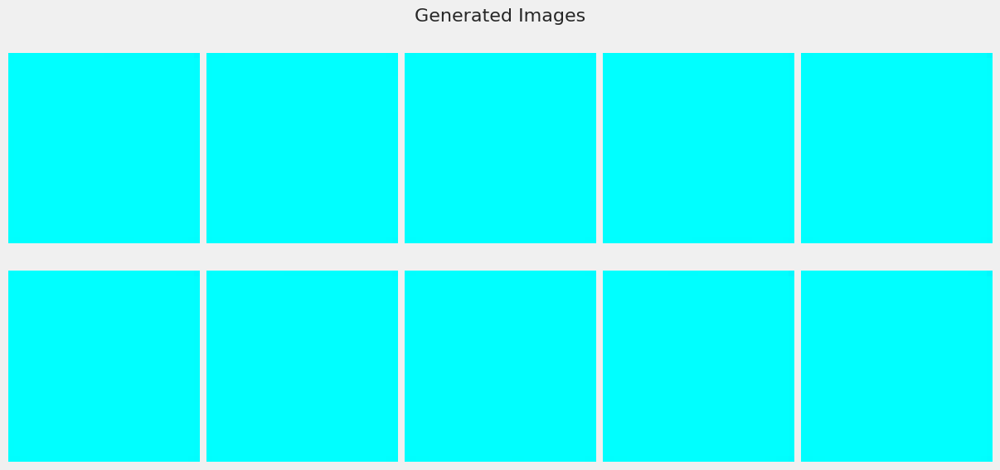

782/782 [==============================] - 19s 22ms/step - d_real_loss: 0.2784 - d_fake_loss: 0.4627 - g_loss: 3.5206 - d_acc: 0.7884 - d_realO: 0.0902 - d_fakeO: 0.8726
Epoch 2/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.0020 - d_fake_loss: 2.8880e-04 - g_loss: 8.4170 - d_acc: 0.9997 - d_realO: 6.7714e-04 - d_fakeO: 0.9998
Epoch 3/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.0091 - d_fake_loss: 0.0712 - g_loss: 9.1891 - d_acc: 0.9974 - d_realO: 0.0052 - d_fakeO: 0.9965
Epoch 4/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.0059 - d_fake_loss: 0.0011 - g_loss: 8.2279 - d_acc: 0.9992 - d_realO: 0.0013 - d_fakeO: 0.9992
Epoch 5/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.0066 - d_fake_loss: 0.0037 - g_loss: 10.2005 - d_acc: 0.9990 - d_realO: 0.0012 - d_fakeO: 0.9973
Epoch 6/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.0174 - 

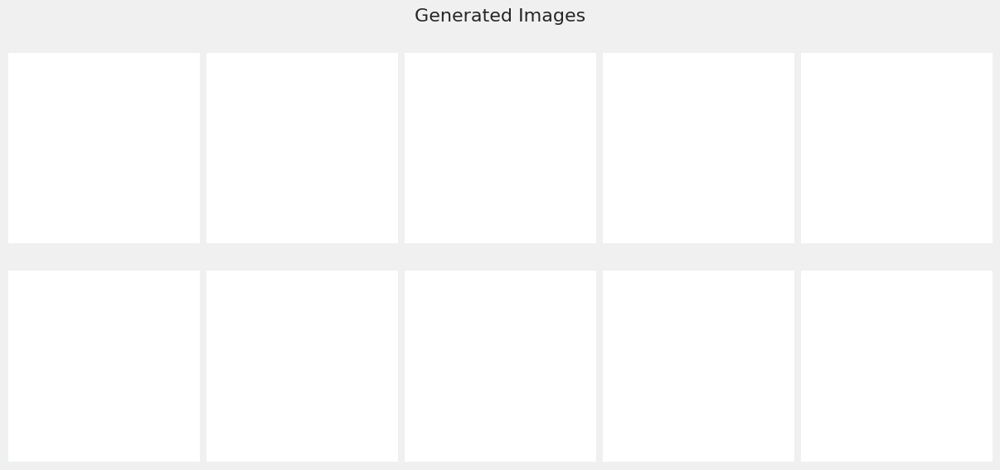

782/782 [==============================] - 17s 22ms/step - d_real_loss: 0.0019 - d_fake_loss: 3.6474e-04 - g_loss: 8.7469 - d_acc: 0.9998 - d_realO: 6.1047e-04 - d_fakeO: 0.9997
Epoch 12/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.0085 - d_fake_loss: 6.0623e-04 - g_loss: 10.6499 - d_acc: 0.9995 - d_realO: 8.3080e-04 - d_fakeO: 0.9995
Epoch 13/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.0063 - d_fake_loss: 7.2795e-04 - g_loss: 10.6346 - d_acc: 0.9996 - d_realO: 0.0013 - d_fakeO: 0.9990
Epoch 14/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.0020 - d_fake_loss: 3.7131e-04 - g_loss: 9.0645 - d_acc: 0.9998 - d_realO: 4.7382e-04 - d_fakeO: 0.9997
Epoch 15/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 9.4738e-04 - d_fake_loss: 2.0413e-04 - g_loss: 9.4921 - d_acc: 0.9999 - d_realO: 1.6997e-04 - d_fakeO: 0.9998
Epoch 16/100
782/782 [==============================] - 

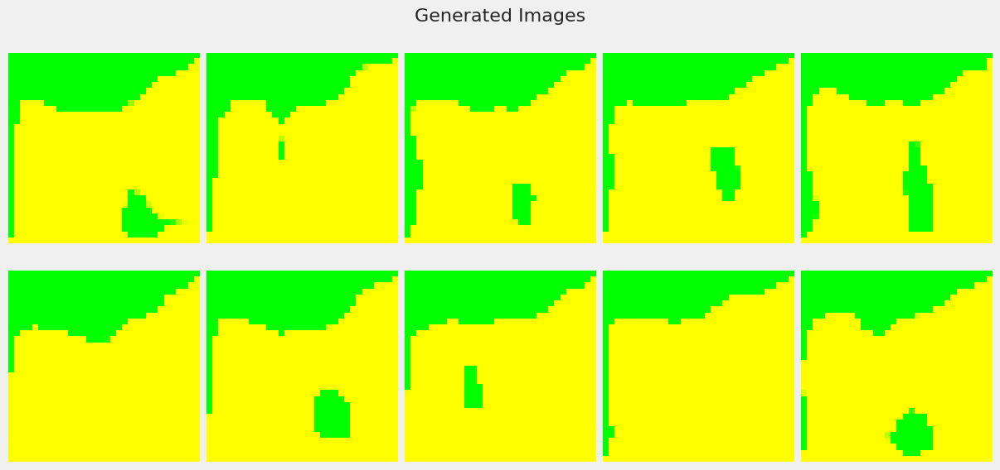

782/782 [==============================] - 17s 22ms/step - d_real_loss: 0.2044 - d_fake_loss: 0.3102 - g_loss: 47.5849 - d_acc: 0.9944 - d_realO: 0.0101 - d_fakeO: 0.9920
Epoch 22/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.0260 - d_fake_loss: 0.0142 - g_loss: 9.5395 - d_acc: 0.9960 - d_realO: 0.0096 - d_fakeO: 0.9930
Epoch 23/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.1072 - d_fake_loss: 0.1080 - g_loss: 8.7384 - d_acc: 0.9558 - d_realO: 0.1742 - d_fakeO: 0.8217
Epoch 24/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.5701 - d_fake_loss: 0.5416 - g_loss: 1.4970 - d_acc: 0.7151 - d_realO: 0.3605 - d_fakeO: 0.6398
Epoch 25/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.5471 - d_fake_loss: 0.4926 - g_loss: 1.5563 - d_acc: 0.7407 - d_realO: 0.3684 - d_fakeO: 0.6325
Epoch 26/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.5762 - d_f

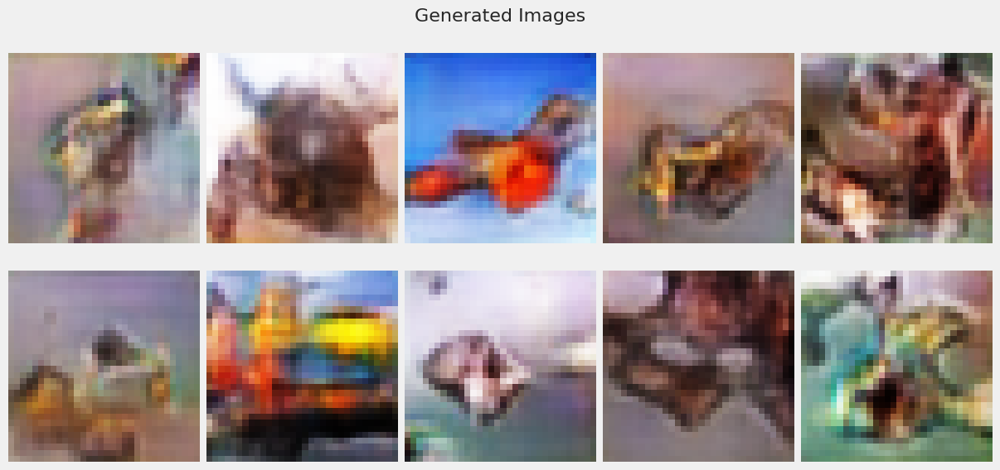

782/782 [==============================] - 17s 22ms/step - d_real_loss: 0.6346 - d_fake_loss: 0.6182 - g_loss: 1.0372 - d_acc: 0.6439 - d_realO: 0.4437 - d_fakeO: 0.5564
Epoch 32/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.6383 - d_fake_loss: 0.6187 - g_loss: 1.0176 - d_acc: 0.6369 - d_realO: 0.4439 - d_fakeO: 0.5556
Epoch 33/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.6410 - d_fake_loss: 0.6186 - g_loss: 1.0050 - d_acc: 0.6339 - d_realO: 0.4449 - d_fakeO: 0.5557
Epoch 34/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.6380 - d_fake_loss: 0.6185 - g_loss: 1.0141 - d_acc: 0.6382 - d_realO: 0.4453 - d_fakeO: 0.5555
Epoch 35/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.6417 - d_fake_loss: 0.6282 - g_loss: 1.0085 - d_acc: 0.6329 - d_realO: 0.4463 - d_fakeO: 0.5535
Epoch 36/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.6377 - d_fa

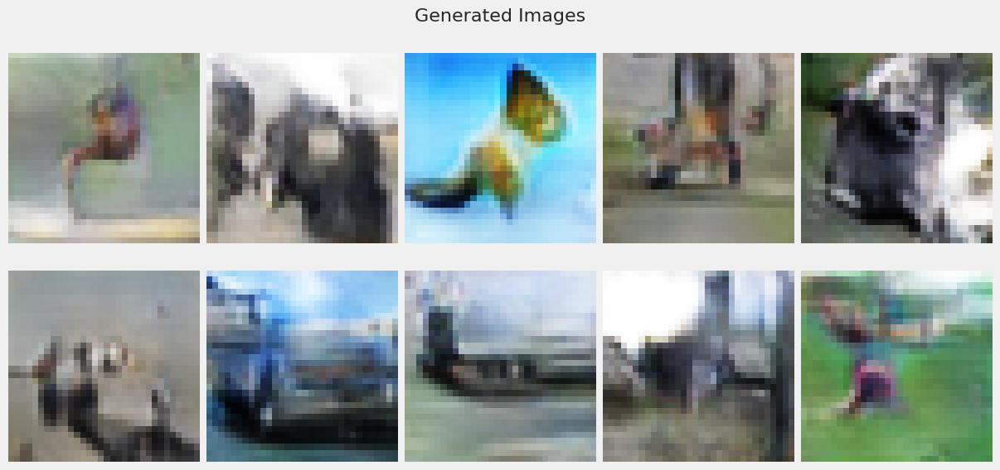

782/782 [==============================] - 17s 22ms/step - d_real_loss: 0.6234 - d_fake_loss: 0.6033 - g_loss: 1.0549 - d_acc: 0.6561 - d_realO: 0.4313 - d_fakeO: 0.5683
Epoch 42/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.6203 - d_fake_loss: 0.5946 - g_loss: 1.0752 - d_acc: 0.6618 - d_realO: 0.4271 - d_fakeO: 0.5729
Epoch 43/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.6155 - d_fake_loss: 0.5921 - g_loss: 1.0976 - d_acc: 0.6674 - d_realO: 0.4238 - d_fakeO: 0.5762
Epoch 44/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.6079 - d_fake_loss: 0.5819 - g_loss: 1.1302 - d_acc: 0.6753 - d_realO: 0.4172 - d_fakeO: 0.5825
Epoch 45/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.6025 - d_fake_loss: 0.5764 - g_loss: 1.1450 - d_acc: 0.6826 - d_realO: 0.4139 - d_fakeO: 0.5864
Epoch 46/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.5970 - d_fa

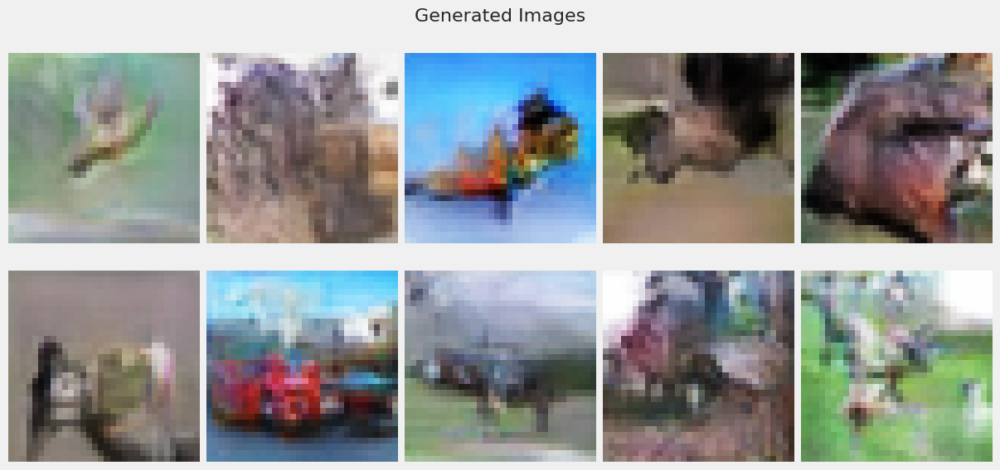

782/782 [==============================] - 17s 22ms/step - d_real_loss: 0.5724 - d_fake_loss: 0.5431 - g_loss: 1.2855 - d_acc: 0.7082 - d_realO: 0.3871 - d_fakeO: 0.6130
Epoch 52/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.5652 - d_fake_loss: 0.5355 - g_loss: 1.3101 - d_acc: 0.7150 - d_realO: 0.3820 - d_fakeO: 0.6176
Epoch 53/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.5609 - d_fake_loss: 0.5314 - g_loss: 1.3305 - d_acc: 0.7166 - d_realO: 0.3771 - d_fakeO: 0.6224
Epoch 54/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.5553 - d_fake_loss: 0.5270 - g_loss: 1.3594 - d_acc: 0.7231 - d_realO: 0.3715 - d_fakeO: 0.6279
Epoch 55/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.5472 - d_fake_loss: 0.5155 - g_loss: 1.3871 - d_acc: 0.7286 - d_realO: 0.3676 - d_fakeO: 0.6317
Epoch 56/100
782/782 [==============================] - 17s 22ms/step - d_real_loss: 0.5444 - d_fa

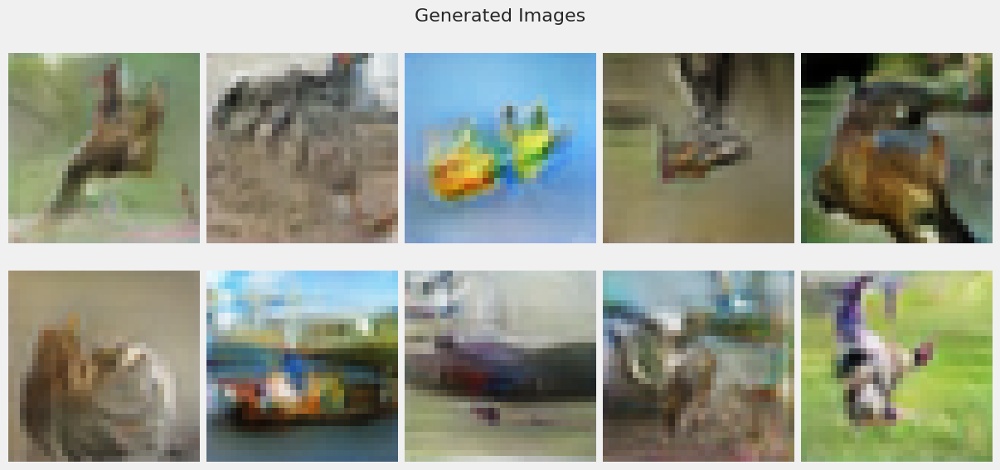

782/782 [==============================] - 14s 18ms/step - d_real_loss: 0.5045 - d_fake_loss: 0.4738 - g_loss: 1.5806 - d_acc: 0.7596 - d_realO: 0.3345 - d_fakeO: 0.6649
Epoch 62/100
782/782 [==============================] - 13s 17ms/step - d_real_loss: 0.4997 - d_fake_loss: 0.4657 - g_loss: 1.6275 - d_acc: 0.7647 - d_realO: 0.3295 - d_fakeO: 0.6701
Epoch 63/100
782/782 [==============================] - 15s 20ms/step - d_real_loss: 0.4923 - d_fake_loss: 0.4619 - g_loss: 1.6521 - d_acc: 0.7699 - d_realO: 0.3263 - d_fakeO: 0.6731
Epoch 64/100
782/782 [==============================] - 13s 17ms/step - d_real_loss: 0.4906 - d_fake_loss: 0.4626 - g_loss: 1.6791 - d_acc: 0.7672 - d_realO: 0.3236 - d_fakeO: 0.6764
Epoch 65/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.4814 - d_fake_loss: 0.4531 - g_loss: 1.7051 - d_acc: 0.7737 - d_realO: 0.3167 - d_fakeO: 0.6827
Epoch 66/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.4716 - d_fa

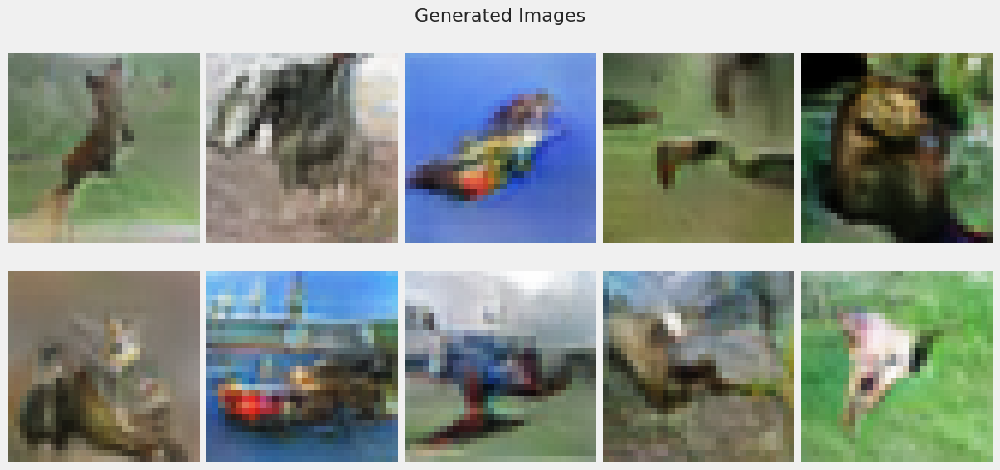

782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.4443 - d_fake_loss: 0.4228 - g_loss: 1.9130 - d_acc: 0.7963 - d_realO: 0.2898 - d_fakeO: 0.7095
Epoch 72/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.4379 - d_fake_loss: 0.4146 - g_loss: 1.9559 - d_acc: 0.7998 - d_realO: 0.2844 - d_fakeO: 0.7148
Epoch 73/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.4322 - d_fake_loss: 0.4118 - g_loss: 1.9908 - d_acc: 0.8015 - d_realO: 0.2812 - d_fakeO: 0.7183
Epoch 74/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.4247 - d_fake_loss: 0.4022 - g_loss: 2.0463 - d_acc: 0.8081 - d_realO: 0.2745 - d_fakeO: 0.7252
Epoch 75/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.4180 - d_fake_loss: 0.3981 - g_loss: 2.0850 - d_acc: 0.8116 - d_realO: 0.2711 - d_fakeO: 0.7279
Epoch 76/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.4110 - d_fa

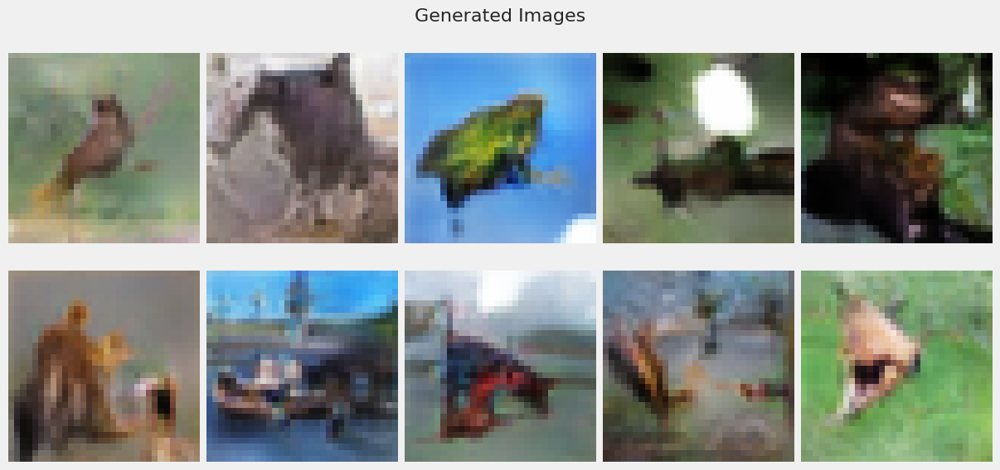

782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.3779 - d_fake_loss: 0.3645 - g_loss: 2.3315 - d_acc: 0.8314 - d_realO: 0.2448 - d_fakeO: 0.7549
Epoch 82/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.3674 - d_fake_loss: 0.3587 - g_loss: 2.3764 - d_acc: 0.8376 - d_realO: 0.2398 - d_fakeO: 0.7594
Epoch 83/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.3679 - d_fake_loss: 0.3573 - g_loss: 2.4144 - d_acc: 0.8374 - d_realO: 0.2372 - d_fakeO: 0.7626
Epoch 84/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.3580 - d_fake_loss: 0.3535 - g_loss: 2.4309 - d_acc: 0.8408 - d_realO: 0.2315 - d_fakeO: 0.7678
Epoch 85/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.3559 - d_fake_loss: 0.3468 - g_loss: 2.4913 - d_acc: 0.8433 - d_realO: 0.2302 - d_fakeO: 0.7696
Epoch 86/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.3445 - d_fa

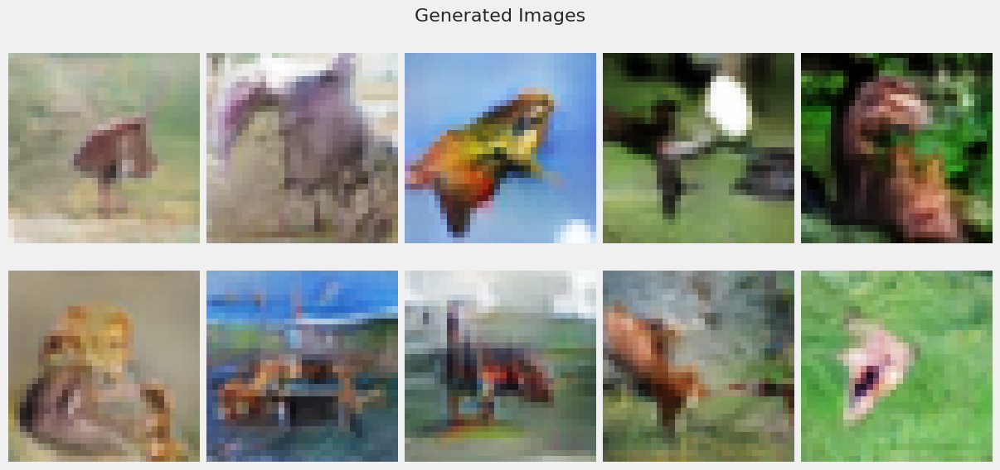

782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.3160 - d_fake_loss: 0.3181 - g_loss: 2.7542 - d_acc: 0.8618 - d_realO: 0.2054 - d_fakeO: 0.7940
Epoch 92/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.3104 - d_fake_loss: 0.3126 - g_loss: 2.8197 - d_acc: 0.8630 - d_realO: 0.2002 - d_fakeO: 0.7991
Epoch 93/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.3033 - d_fake_loss: 0.3081 - g_loss: 2.8600 - d_acc: 0.8697 - d_realO: 0.1976 - d_fakeO: 0.8019
Epoch 94/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.3021 - d_fake_loss: 0.3069 - g_loss: 2.8945 - d_acc: 0.8701 - d_realO: 0.1950 - d_fakeO: 0.8048
Epoch 95/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.2936 - d_fake_loss: 0.2993 - g_loss: 2.9572 - d_acc: 0.8709 - d_realO: 0.1918 - d_fakeO: 0.8075
Epoch 96/100
782/782 [==============================] - 15s 19ms/step - d_real_loss: 0.2861 - d_fa

In [39]:
gan_2= train_gan(discriminator_dcgan2, generator_dcgan2, noise, 'Baseline DCGAN 2', dataset, 100, callbacks=callbacks)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Looking at the accuracy, we can see that the discriminator ended with a  88% accuracy while it may not be the best, it did show that it is not able to fully determine real and fake as it started from 0.6
- No model collapse


</div>

#### Looking at results

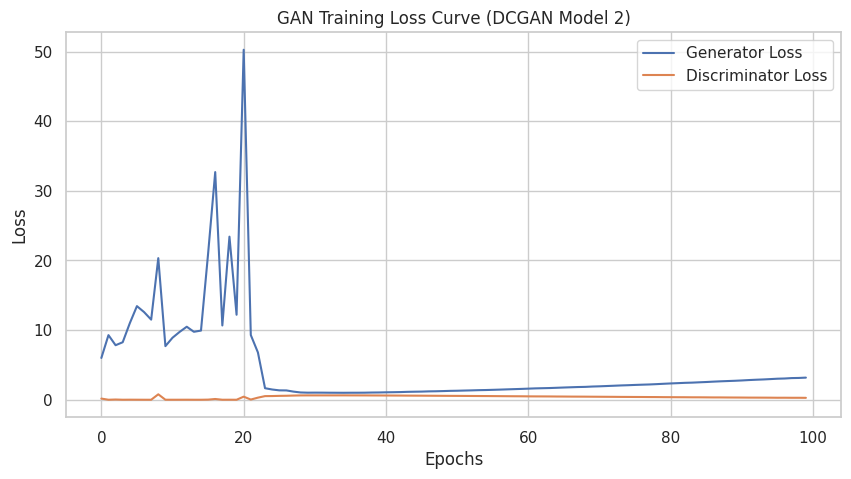

In [40]:
gan_history_2 = gan_2[0].history
generator = gan_2[1].generator  
gan_history_2['d_loss'] = [(real_loss + fake_loss) / 2 for real_loss, fake_loss in zip(gan_history_2['d_real_loss'], gan_history_2['d_fake_loss'])]
evaluator = Evaluation(generator, latent_dim, 512, 10000, 1024)
evaluator.plot_loss_curve(gan_history_2, title='GAN Training Loss Curve (DCGAN Model 2)')

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Discriminator loss
    - For the discriminator loss, it starts relatively low and mains around there
- Generator loss
    - For the generator loss, it increases with a spike and drops and proceeded to increase slowly


</div>

In [41]:
tf.keras.backend.clear_session()
K.clear_session()
scores1 = evaluator.compute_metrics(x_train)
print('FID Score:', scores1[0])
print('KID Score:', scores1[1])

None
313/313 [==============================] - 1s 3ms/step
FID Score: 54.33818375407682
KID Score: 0.041610203863365225


<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- FID Score of 54
- KID Score is 0.04
    
It did not improve from the previous model, let us keep trying

</div>

2/2 [==============================] - 1s 24ms/step


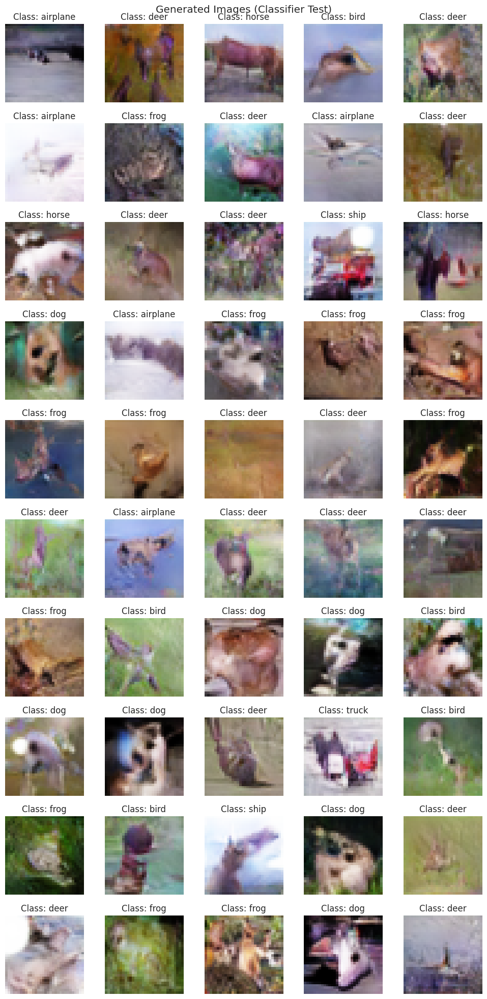

In [42]:
latent_dim = 128  
num_images = 50  
noise = tf.random.normal([num_images, latent_dim])
generated_images = generator.predict(noise)
generated_images = (generated_images + 1) / 2
generated_images = generated_images * 255
generated_images = np.clip(generated_images, 0, 255).astype('uint8')
generated_images_resized = tf.image.resize(generated_images, [224, 224]).numpy().astype('uint8')
predictions = model_c.predict(generated_images_resized)
predicted_classes = np.argmax(predictions, axis=-1)
num_columns = 5
num_rows = num_images // num_columns + (num_images % num_columns > 0)
fig, axes = plt.subplots(num_rows, num_columns, figsize=(num_columns * 2, num_rows * 2))
fig.suptitle('Generated Images (Classifier Test)')
for i, ax in enumerate(axes.flatten()):
    if i >= num_images:
        break
    ax.imshow(generated_images[i])
    ax.set_title(f'Class: {class_labels[predicted_classes[i]]}')
    ax.axis('off')
plt.tight_layout()
plt.show()

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Similar to above, we can tell most of the animal images like deer, dog but cars and ships images are not poroduced

</div>

4/4 [==============================] - 0s 3ms/step


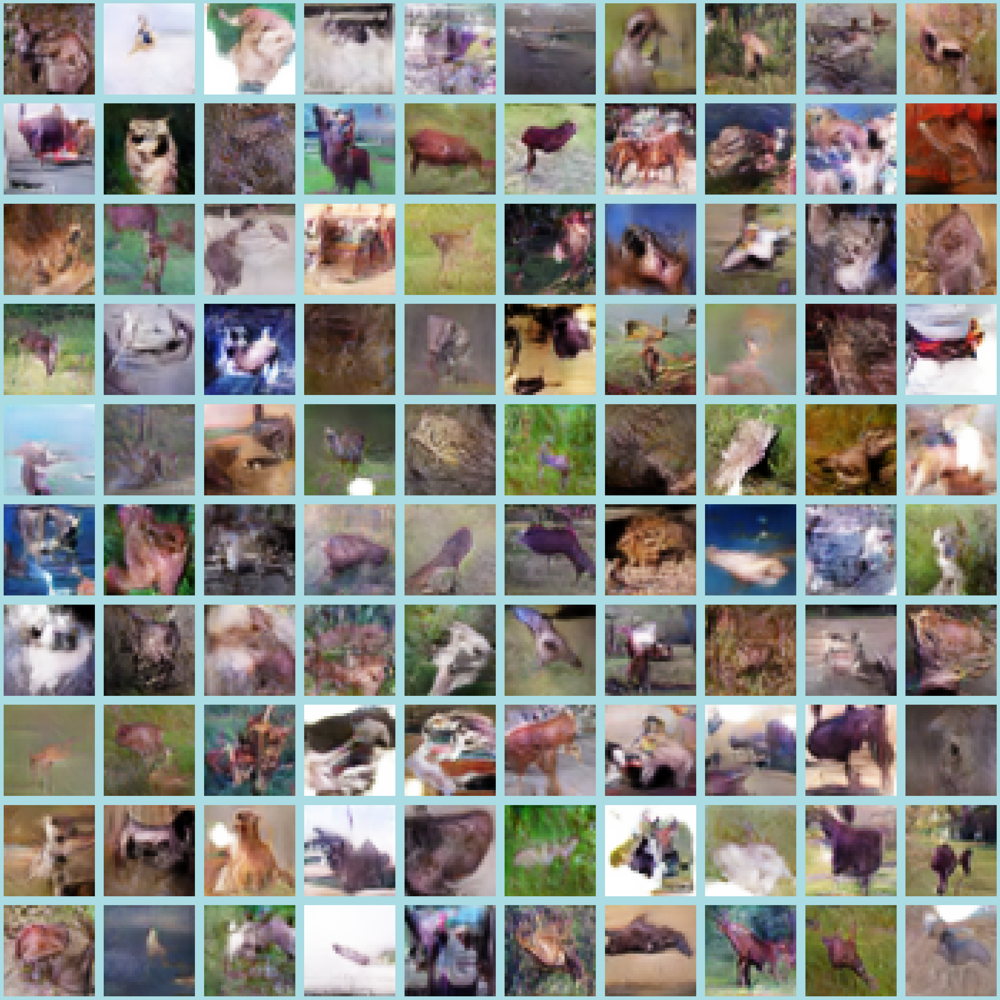

4/4 [==============================] - 0s 3ms/step


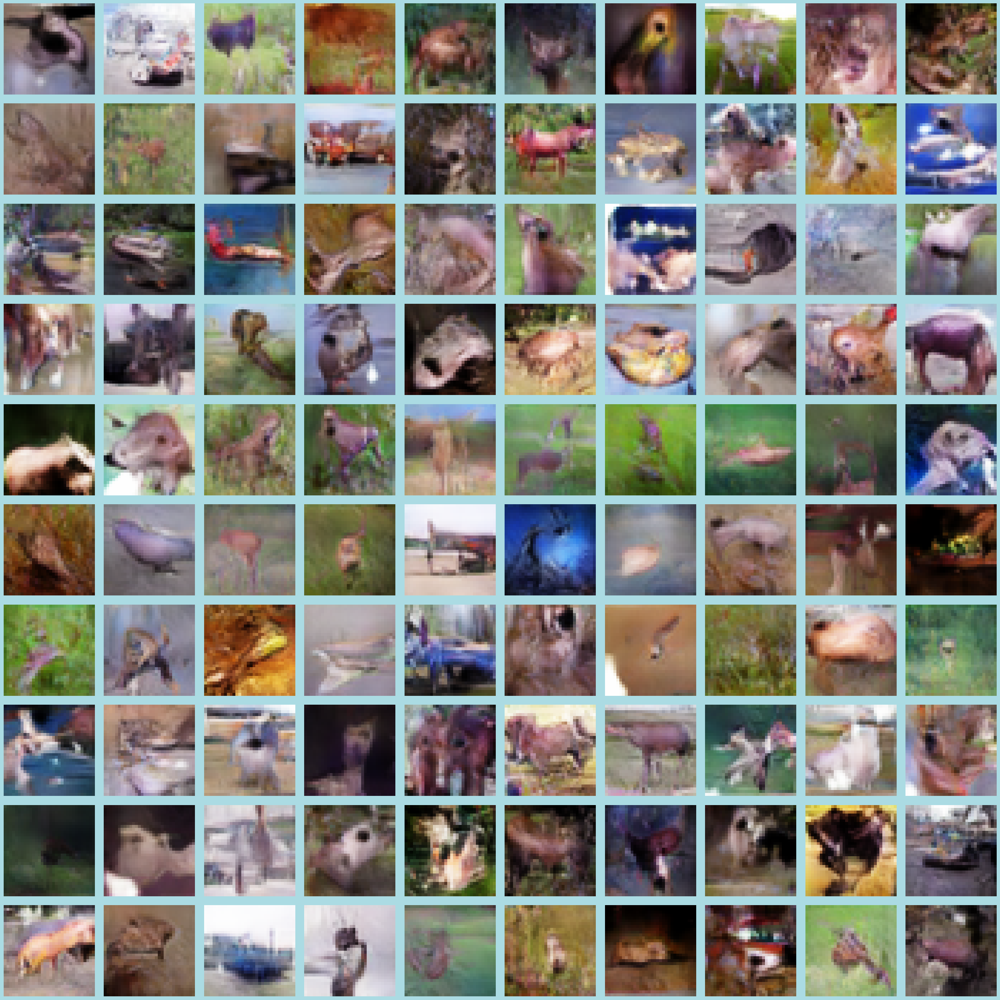

4/4 [==============================] - 0s 4ms/step


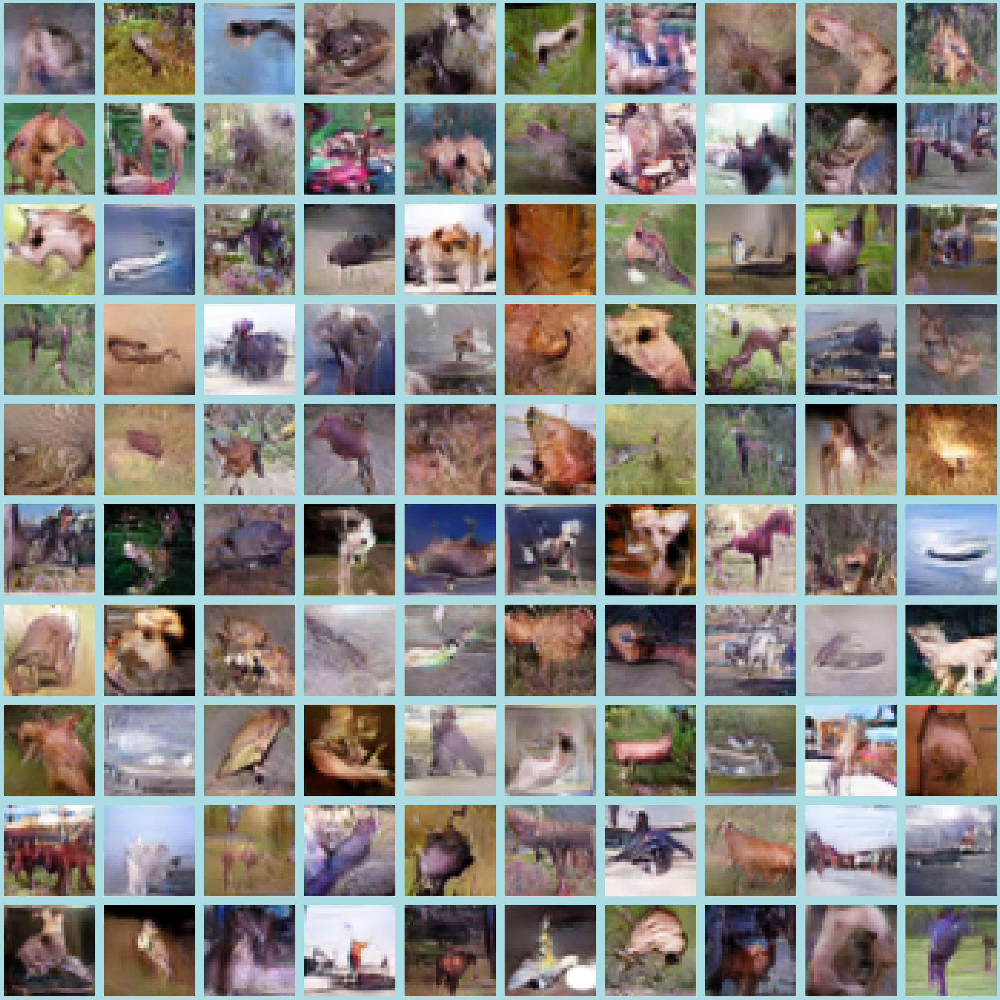

4/4 [==============================] - 0s 3ms/step


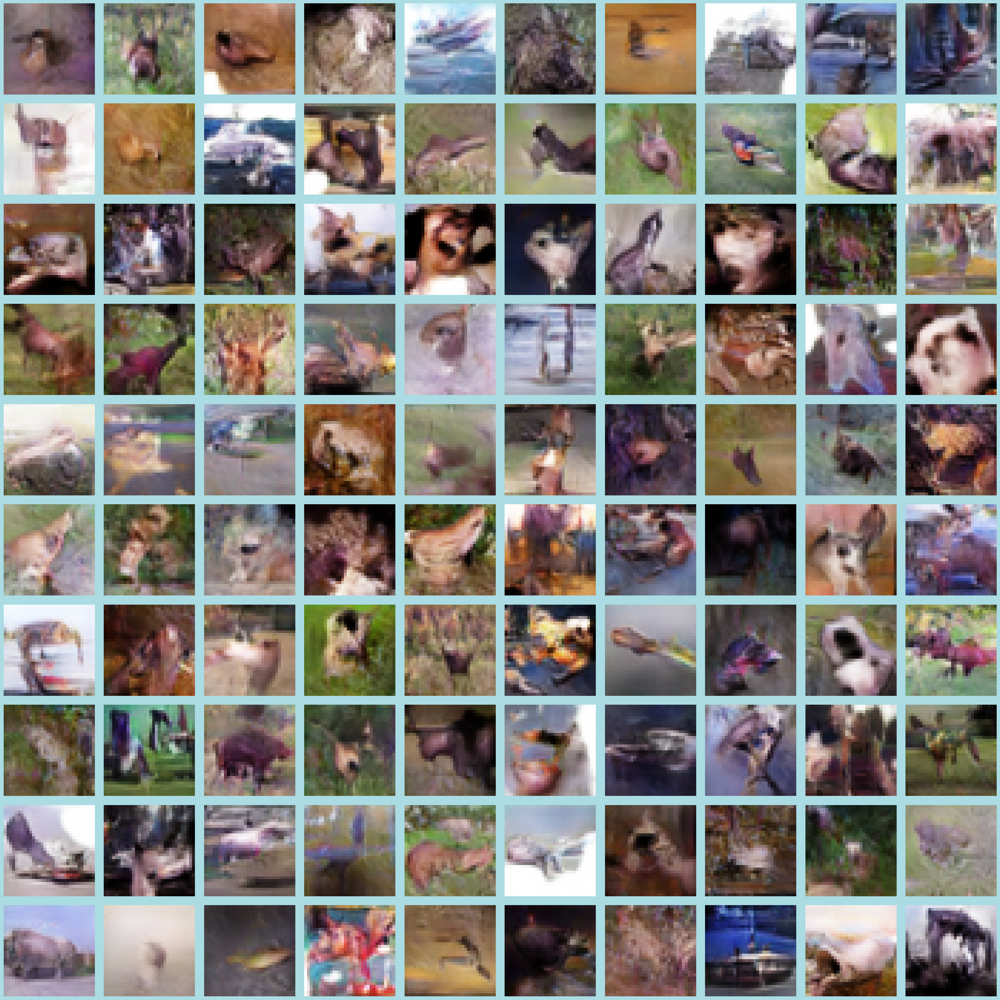

4/4 [==============================] - 0s 3ms/step


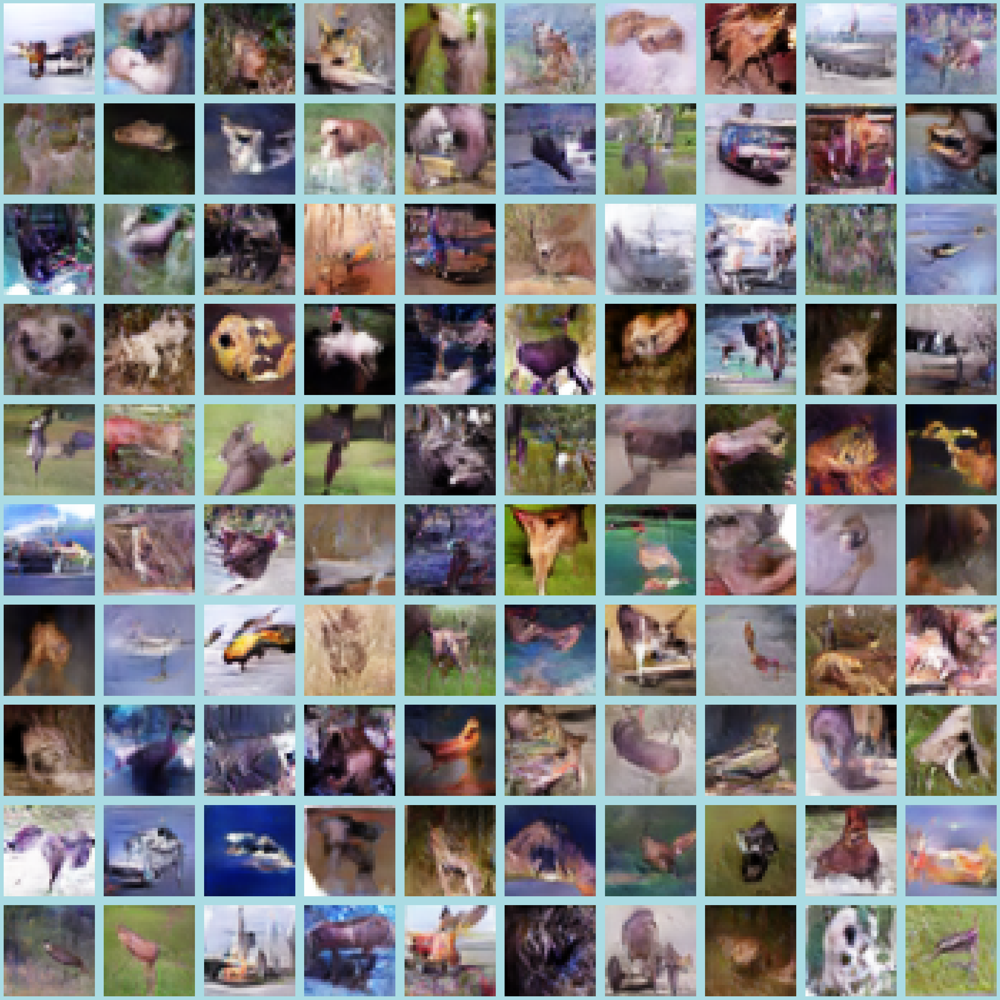

4/4 [==============================] - 0s 3ms/step


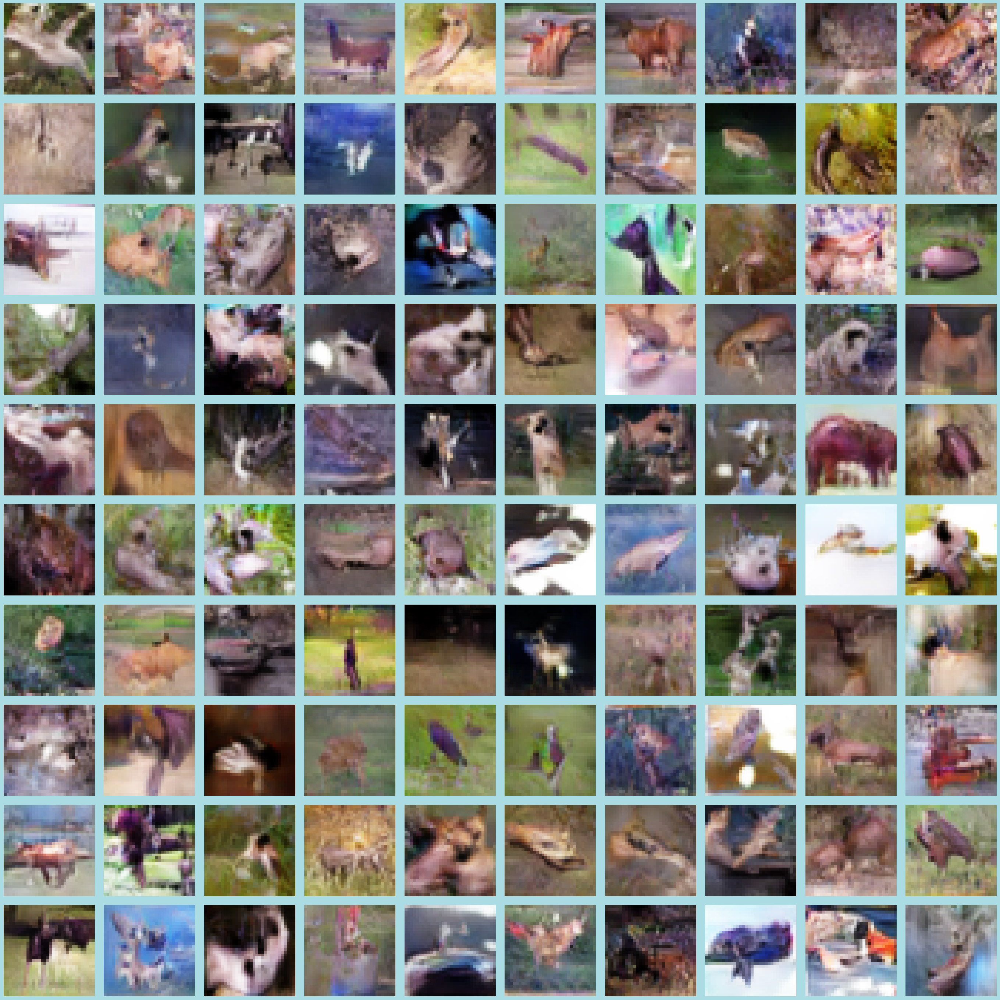

4/4 [==============================] - 0s 3ms/step


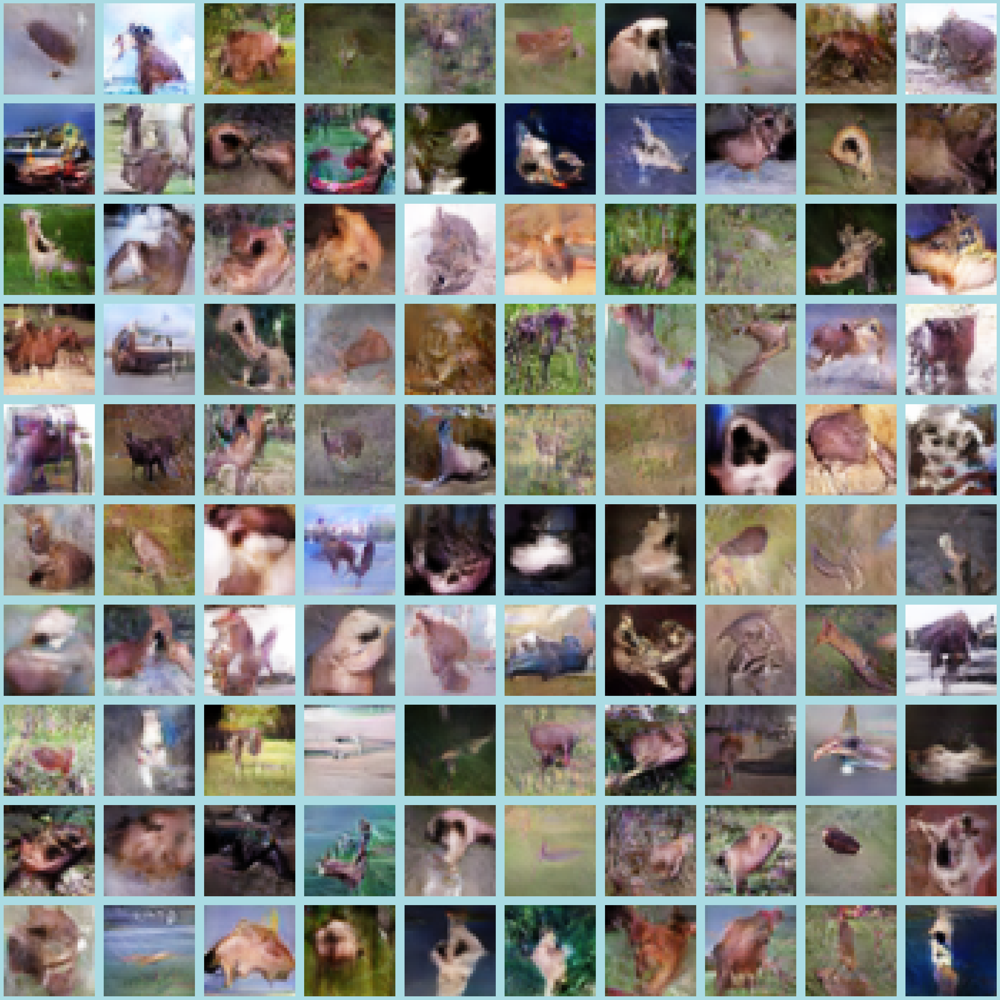

4/4 [==============================] - 0s 3ms/step


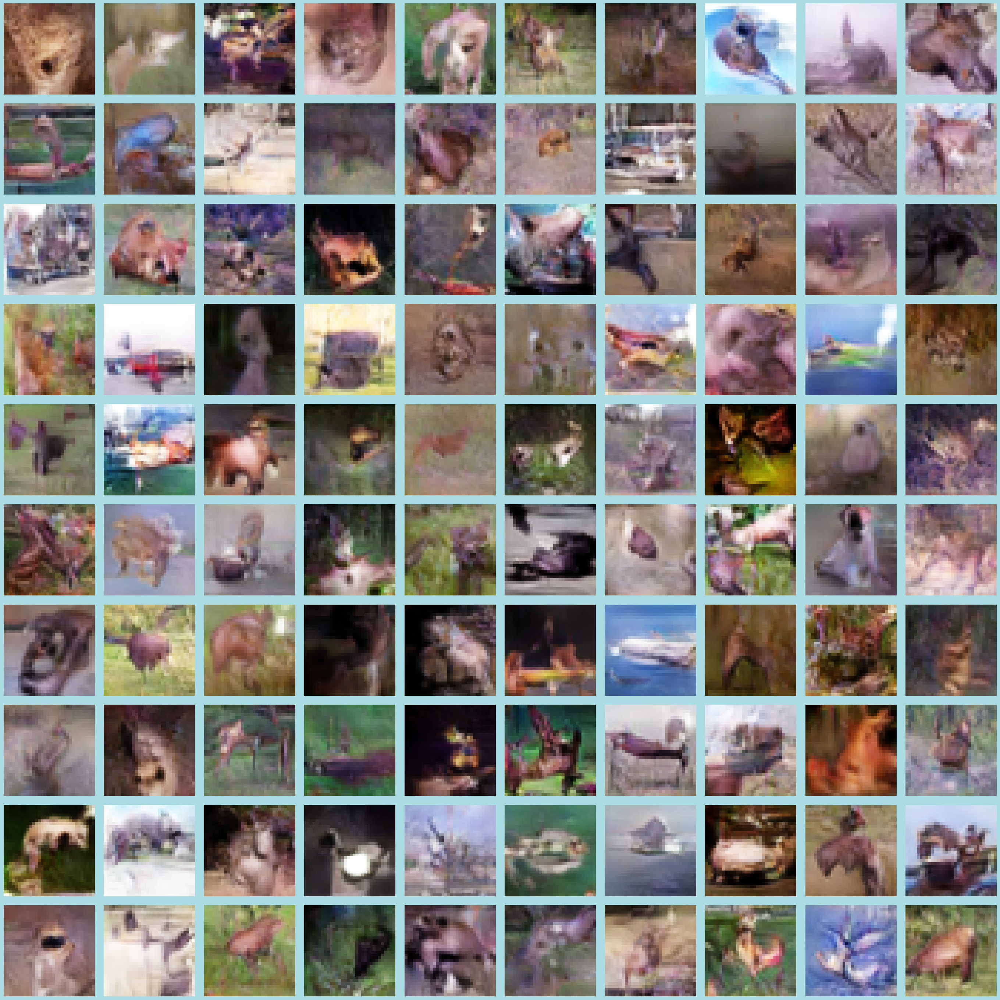

4/4 [==============================] - 0s 3ms/step


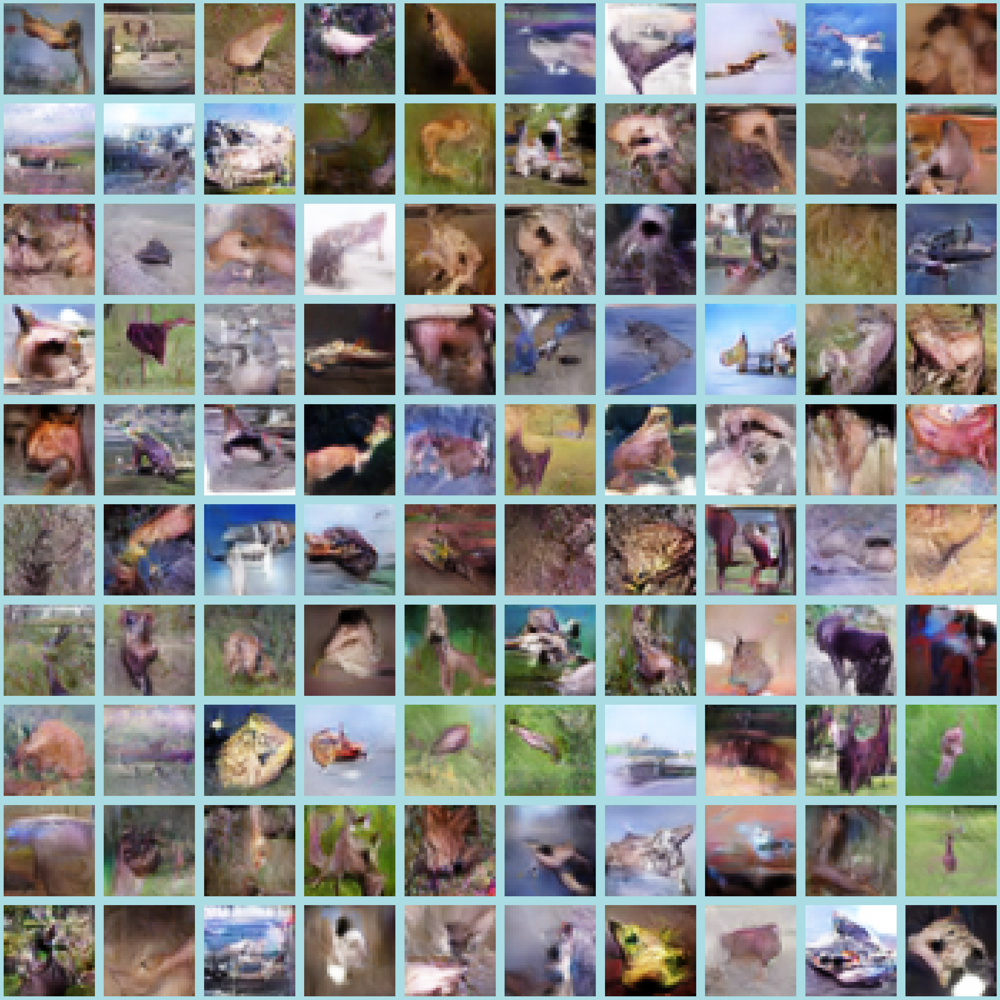

4/4 [==============================] - 0s 4ms/step


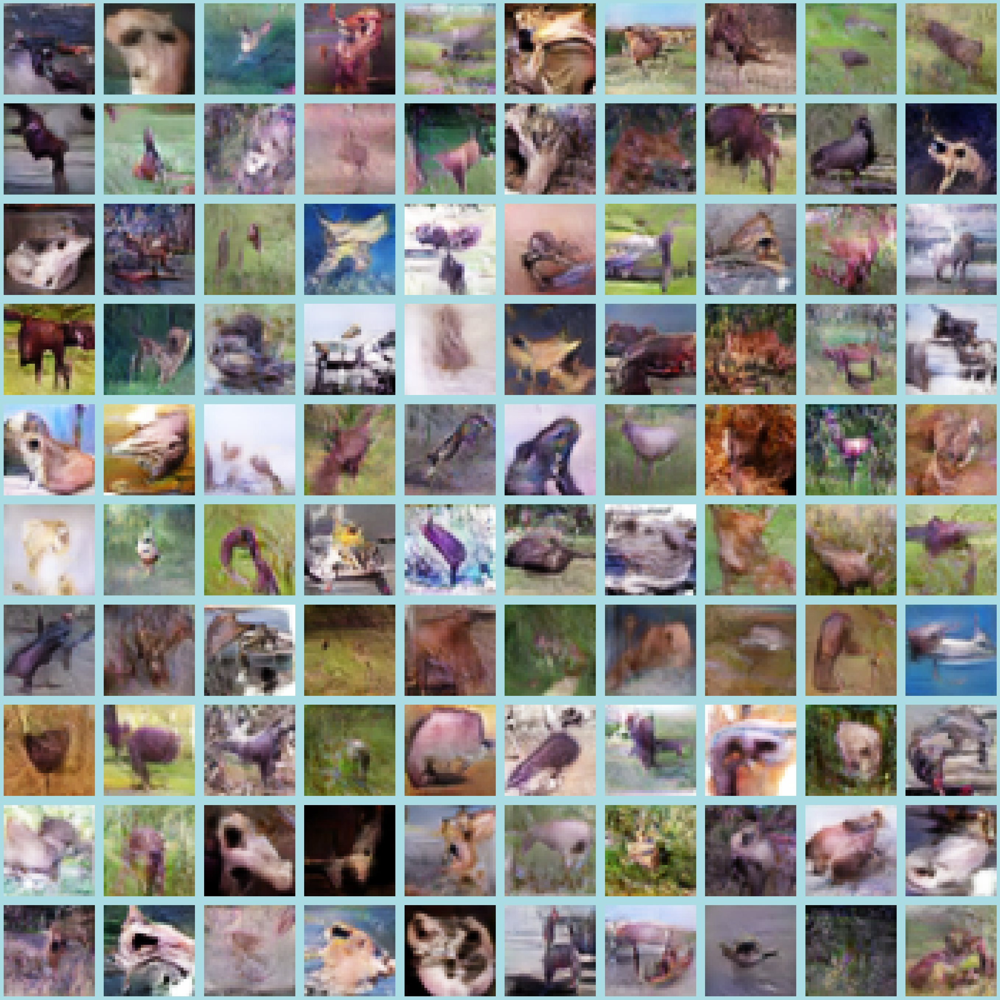

In [43]:
generate_1000(generator)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- 1000 images provided similar idea compared to comparing it with a classifier

</div>

#### Storing the scores

In [44]:
new_row = {'Model':'Baseline DCGAN 2', 'FID':scores1[0], 'KID': scores1[1], 'd_loss':gan_history_2['d_loss'][-1], 'g_loss':gan_history_2['g_loss'][-1] }
new_df = pd.DataFrame([new_row])
full_scores = pd.concat([full_scores, new_df], ignore_index=True)
full_scores

,Model,FID,KID,d_loss,g_loss
0,Baseline DCGAN 1,53.235623,0.039666,0.229398,3.687913
1,Baseline DCGAN 2,54.338184,0.041610,0.275021,3.177531


### Third Model

__Key Ideas__
1. Usage of `LeakyReLU` instead of `PReLU`.
2. Introduction of `UpSampling2D` layers for upsampling.

__Model Ideas__

1. **Input and Dense Layer**:
    - **Dense Layer**: 
        - **Units**:128 * 8 * 8 units
        - **Input**: Accepts an input of dimension `latent_dim`
        
2. **Activation and Reshape Layer**:
    - **LeakyReLU**:
        - **Alpha**: 0.2
    - **Reshape**:
        - **New Shape**: Reshapes the output of the Dense layer into an 8x8x128 t

3. **Upsampling and Convolution**:
    - **Upsampling to 16x16**:
        - **UpSampling2D**:  scaling from 8x8 to 16x16.
        - **Conv2D**:
            - **Filters**: 128
            - **Kernel Size**: (3,3), used to refine the upscaled features.
            - **Padding**: 'same', ensures the spatial dimensions remain constant.
        - **LeakyReLU**:
            - **Alpha**: 0.2
    
    - **Upsampling to 32x32**:
        - **UpSampling2D**: scaling from 16x16 to 32x32.
        - **Conv2D**:
            - **Filters**: 3 (corresponding to RGB channels, final layer to generate the image)
            - **Kernel Size**: (3,3)
            - **Padding**: 'same'
            - **Activation**: 'tanh',  in the range [-1, 1].


In [45]:
def build_generator(latent_dim):
    model = Sequential()
    # Foundation for 8x8 feature maps
    n_nodes = 128 * 8 * 8
    model.add(Dense(n_nodes, input_dim=latent_dim))
    model.add(LeakyReLU(alpha=0.2))
    model.add(Reshape((8, 8, 128)))
    # Upsample to 16x16
    model.add(UpSampling2D())
    model.add(Conv2D(128, (3,3), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    # Upsample to 32x32
    model.add(UpSampling2D())
    model.add(Conv2D(3, (3,3), padding='same', activation='tanh'))
    return model


##### Discriminator
__Key Ideas__

1. **Input Layer and Convolutional Layers**:
    - **Conv2D (First Layer)**:
        - **Filters**: 64
        - **Kernel Size**: (3,3), captures spatial features.
        - **Strides**: (2,2),
        - **Padding**: 'same'
        - **Input Shape**: `in_shape` (the shape of the input images).
    - **LeakyReLU**:
        - **Alpha**: 0.2

    - **Conv2D (Second Layer)**:
        - **Filters**: 128
        - **Kernel Size**: (3,3)
        - **Strides**: (2,2),  reduces the spatial dimensions to half
        - **Padding**: 'same'
    - **LeakyReLU**:
        - **Alpha**: 0.2

2. **Flattening and Output Layer**:
    - **Flatten**: Transforms the 2D feature maps into a 1D feature vector, preparing it for the dense output layer.
    - **Dense**:
        - **Units**: 1, the output layer for binary classification.
        - **Activation**: 'sigmoid'



In [46]:
def build_discriminator(in_shape=(32, 32, 3)):
    model = Sequential()
    # Downsample to 16x16
    model.add(Conv2D(64, (3,3), strides=(2,2), padding='same', input_shape=in_shape))
    model.add(LeakyReLU(alpha=0.2))
    # Downsample to 8x8
    model.add(Conv2D(128, (3,3), strides=(2,2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    # Flatten and output layer
    model.add(Flatten())
    model.add(Dense(1, activation='sigmoid'))
    # Compile model
    model.compile(loss='binary_crossentropy', optimizer=Adam(lr=0.0002, beta_1=0.5), metrics=['accuracy'])
    return model

#### Creating Checkpoint

In [47]:
callbacks = [ImageGenerationCallback(num_img=10, noise=128, vmin=-1, vmax=1), ModelCheckpointCallback(model_dir='baselineDCGAN-3')]

#### Training

In [48]:
discriminator_dcgan3 = build_discriminator()
generator_dcgan3 = build_generator(128)

In [49]:
tf.keras.backend.clear_session()
K.clear_session()

Epoch 1/100
782/782 [==============================] - ETA: 0s - d_real_loss: 0.5821 - d_fake_loss: 0.6945 - g_loss: 0.8578 - d_acc: 0.5950 - d_realO: 0.4641 - d_fakeO: 0.5135

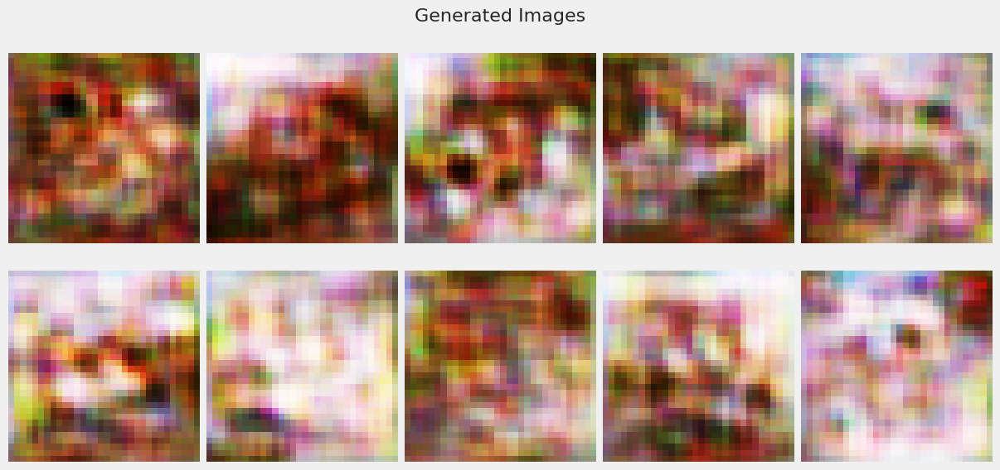

782/782 [==============================] - 12s 14ms/step - d_real_loss: 0.5822 - d_fake_loss: 0.6945 - g_loss: 0.8578 - d_acc: 0.5949 - d_realO: 0.4642 - d_fakeO: 0.5135
Epoch 2/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.7046 - d_fake_loss: 0.6922 - g_loss: 0.7247 - d_acc: 0.4816 - d_realO: 0.5013 - d_fakeO: 0.5015
Epoch 3/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6673 - d_fake_loss: 0.6766 - g_loss: 0.7593 - d_acc: 0.6023 - d_realO: 0.4696 - d_fakeO: 0.5161
Epoch 4/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6841 - d_fake_loss: 0.6536 - g_loss: 0.8188 - d_acc: 0.5627 - d_realO: 0.4715 - d_fakeO: 0.5251
Epoch 5/100
782/782 [==============================] - 10s 13ms/step - d_real_loss: 0.6747 - d_fake_loss: 0.6412 - g_loss: 0.8203 - d_acc: 0.5997 - d_realO: 0.4777 - d_fakeO: 0.5240
Epoch 6/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6671 - d_fake_lo

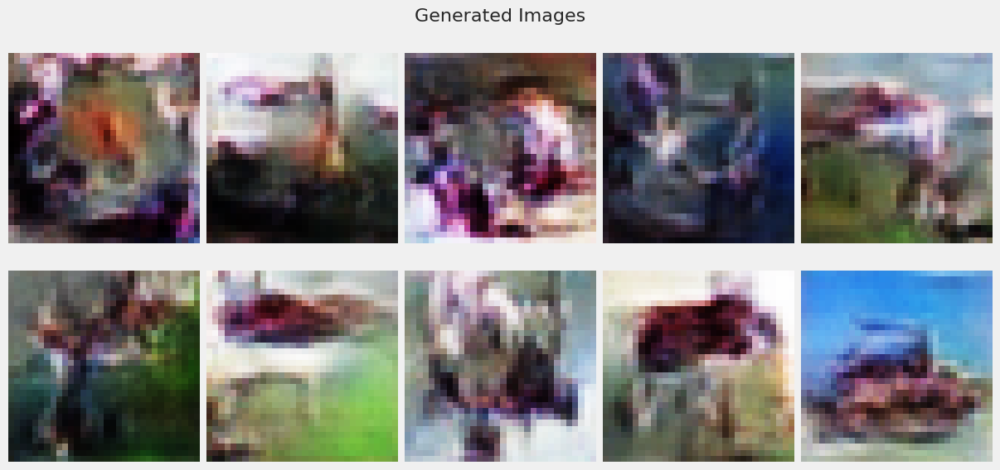

782/782 [==============================] - 11s 14ms/step - d_real_loss: 0.6976 - d_fake_loss: 0.6891 - g_loss: 0.7434 - d_acc: 0.4989 - d_realO: 0.4982 - d_fakeO: 0.5044
Epoch 12/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6959 - d_fake_loss: 0.6862 - g_loss: 0.7531 - d_acc: 0.5124 - d_realO: 0.4978 - d_fakeO: 0.5050
Epoch 13/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6969 - d_fake_loss: 0.6860 - g_loss: 0.7482 - d_acc: 0.5082 - d_realO: 0.4977 - d_fakeO: 0.5050
Epoch 14/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6950 - d_fake_loss: 0.6869 - g_loss: 0.7461 - d_acc: 0.5068 - d_realO: 0.4977 - d_fakeO: 0.5045
Epoch 15/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6951 - d_fake_loss: 0.6851 - g_loss: 0.7481 - d_acc: 0.5173 - d_realO: 0.4972 - d_fakeO: 0.5052
Epoch 16/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6942 - d_fa

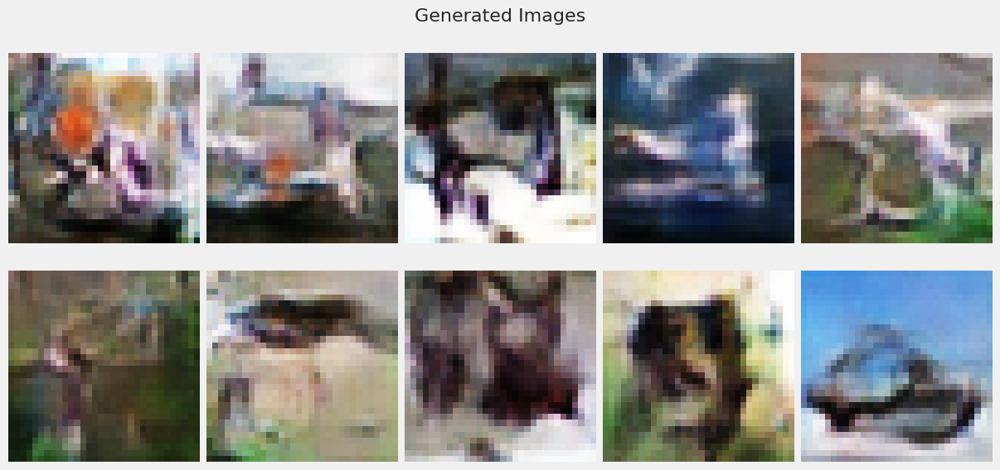

782/782 [==============================] - 11s 14ms/step - d_real_loss: 0.6952 - d_fake_loss: 0.6910 - g_loss: 0.7429 - d_acc: 0.5041 - d_realO: 0.4988 - d_fakeO: 0.5031
Epoch 22/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6967 - d_fake_loss: 0.6901 - g_loss: 0.7334 - d_acc: 0.4988 - d_realO: 0.4998 - d_fakeO: 0.5026
Epoch 23/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6964 - d_fake_loss: 0.6919 - g_loss: 0.7315 - d_acc: 0.4892 - d_realO: 0.4997 - d_fakeO: 0.5018
Epoch 24/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6976 - d_fake_loss: 0.6923 - g_loss: 0.7302 - d_acc: 0.4899 - d_realO: 0.5001 - d_fakeO: 0.5016
Epoch 25/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6949 - d_fake_loss: 0.6931 - g_loss: 0.7326 - d_acc: 0.4948 - d_realO: 0.4993 - d_fakeO: 0.5020
Epoch 26/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6958 - d_fa

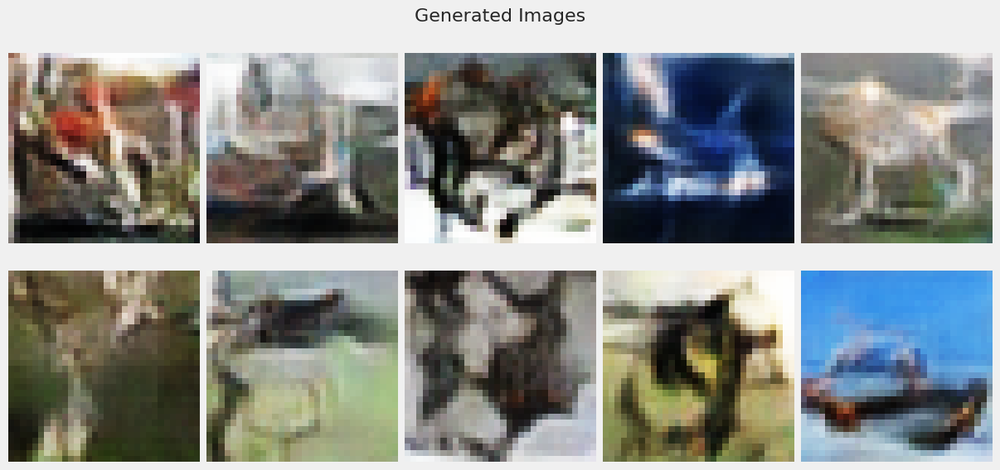

782/782 [==============================] - 11s 14ms/step - d_real_loss: 0.6948 - d_fake_loss: 0.6916 - g_loss: 0.7323 - d_acc: 0.5008 - d_realO: 0.4992 - d_fakeO: 0.5021
Epoch 32/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6952 - d_fake_loss: 0.6913 - g_loss: 0.7287 - d_acc: 0.4996 - d_realO: 0.4993 - d_fakeO: 0.5018
Epoch 33/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6953 - d_fake_loss: 0.6912 - g_loss: 0.7281 - d_acc: 0.4979 - d_realO: 0.4992 - d_fakeO: 0.5021
Epoch 34/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6943 - d_fake_loss: 0.6900 - g_loss: 0.7308 - d_acc: 0.4994 - d_realO: 0.4989 - d_fakeO: 0.5021
Epoch 35/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6927 - d_fake_loss: 0.6919 - g_loss: 0.7337 - d_acc: 0.4986 - d_realO: 0.4991 - d_fakeO: 0.5021
Epoch 36/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6941 - d_fa

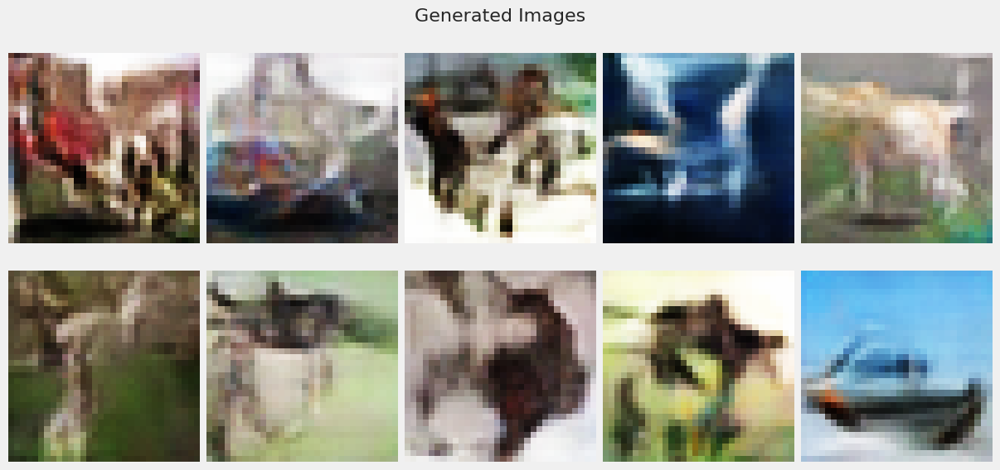

782/782 [==============================] - 11s 14ms/step - d_real_loss: 0.6942 - d_fake_loss: 0.6895 - g_loss: 0.7302 - d_acc: 0.5044 - d_realO: 0.4988 - d_fakeO: 0.5026
Epoch 42/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6925 - d_fake_loss: 0.6895 - g_loss: 0.7361 - d_acc: 0.5134 - d_realO: 0.4980 - d_fakeO: 0.5032
Epoch 43/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6941 - d_fake_loss: 0.6894 - g_loss: 0.7292 - d_acc: 0.5085 - d_realO: 0.4986 - d_fakeO: 0.5029
Epoch 44/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6929 - d_fake_loss: 0.6901 - g_loss: 0.7307 - d_acc: 0.5043 - d_realO: 0.4982 - d_fakeO: 0.5028
Epoch 45/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6931 - d_fake_loss: 0.6899 - g_loss: 0.7312 - d_acc: 0.5069 - d_realO: 0.4983 - d_fakeO: 0.5025
Epoch 46/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6932 - d_fa

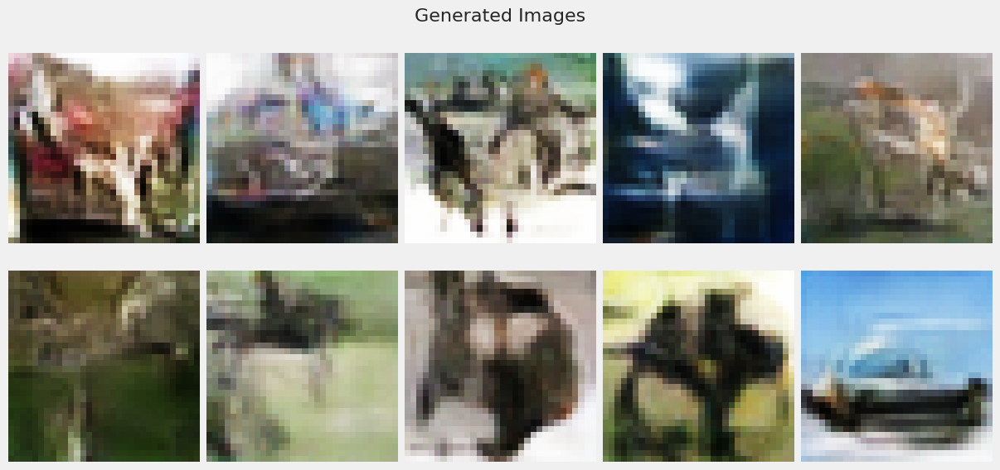

782/782 [==============================] - 11s 14ms/step - d_real_loss: 0.6934 - d_fake_loss: 0.6884 - g_loss: 0.7318 - d_acc: 0.5128 - d_realO: 0.4978 - d_fakeO: 0.5035
Epoch 52/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6930 - d_fake_loss: 0.6893 - g_loss: 0.7337 - d_acc: 0.5131 - d_realO: 0.4976 - d_fakeO: 0.5034
Epoch 53/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6929 - d_fake_loss: 0.6874 - g_loss: 0.7316 - d_acc: 0.5163 - d_realO: 0.4980 - d_fakeO: 0.5034
Epoch 54/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6923 - d_fake_loss: 0.6885 - g_loss: 0.7314 - d_acc: 0.5120 - d_realO: 0.4979 - d_fakeO: 0.5029
Epoch 55/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6920 - d_fake_loss: 0.6878 - g_loss: 0.7395 - d_acc: 0.5209 - d_realO: 0.4974 - d_fakeO: 0.5035
Epoch 56/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6925 - d_fa

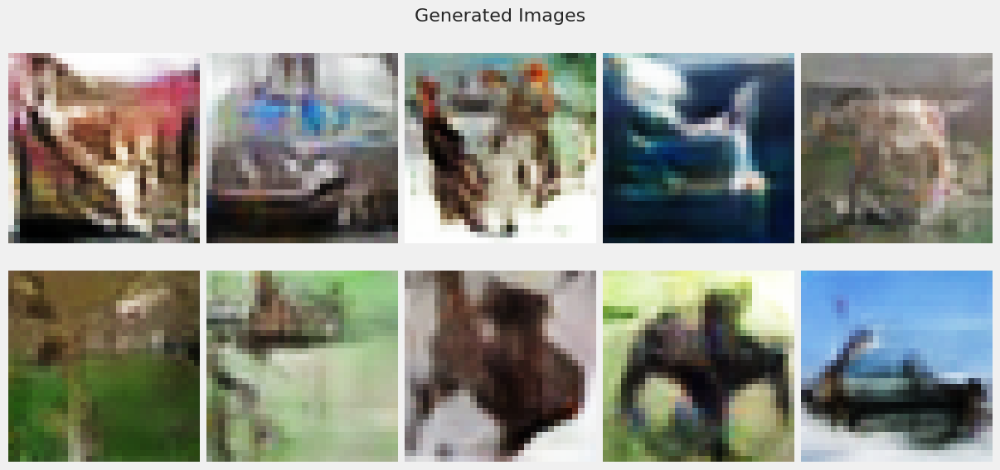

782/782 [==============================] - 11s 14ms/step - d_real_loss: 0.6920 - d_fake_loss: 0.6886 - g_loss: 0.7349 - d_acc: 0.5169 - d_realO: 0.4975 - d_fakeO: 0.5035
Epoch 62/100
782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.6922 - d_fake_loss: 0.6886 - g_loss: 0.7340 - d_acc: 0.5155 - d_realO: 0.4974 - d_fakeO: 0.5037
Epoch 63/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6912 - d_fake_loss: 0.6886 - g_loss: 0.7373 - d_acc: 0.5178 - d_realO: 0.4970 - d_fakeO: 0.5039
Epoch 64/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6907 - d_fake_loss: 0.6890 - g_loss: 0.7337 - d_acc: 0.5184 - d_realO: 0.4973 - d_fakeO: 0.5034
Epoch 65/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6906 - d_fake_loss: 0.6877 - g_loss: 0.7399 - d_acc: 0.5221 - d_realO: 0.4966 - d_fakeO: 0.5043
Epoch 66/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6917 - d_fak

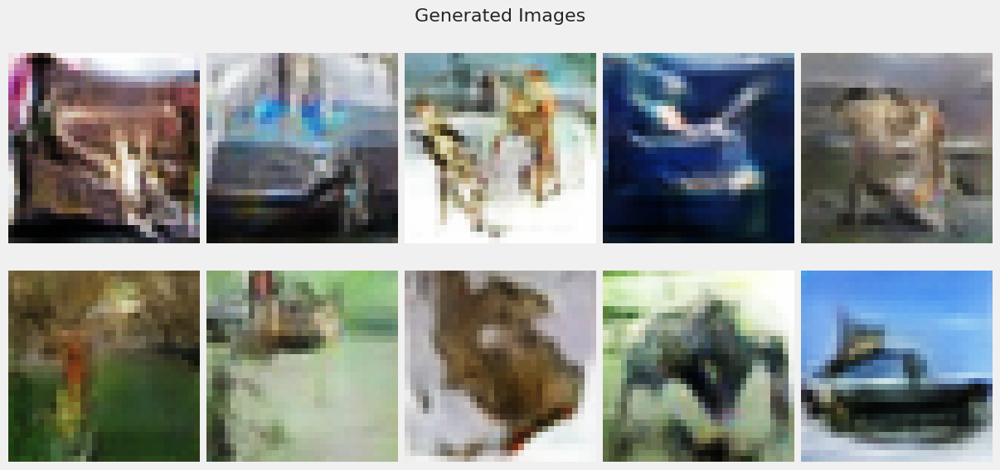

782/782 [==============================] - 11s 14ms/step - d_real_loss: 0.6903 - d_fake_loss: 0.6868 - g_loss: 0.7425 - d_acc: 0.5244 - d_realO: 0.4964 - d_fakeO: 0.5047
Epoch 72/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6899 - d_fake_loss: 0.6878 - g_loss: 0.7417 - d_acc: 0.5269 - d_realO: 0.4965 - d_fakeO: 0.5044
Epoch 73/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6902 - d_fake_loss: 0.6863 - g_loss: 0.7425 - d_acc: 0.5292 - d_realO: 0.4962 - d_fakeO: 0.5048
Epoch 74/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6894 - d_fake_loss: 0.6864 - g_loss: 0.7429 - d_acc: 0.5297 - d_realO: 0.4959 - d_fakeO: 0.5049
Epoch 75/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6908 - d_fake_loss: 0.6855 - g_loss: 0.7439 - d_acc: 0.5239 - d_realO: 0.4962 - d_fakeO: 0.5049
Epoch 76/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6901 - d_fa

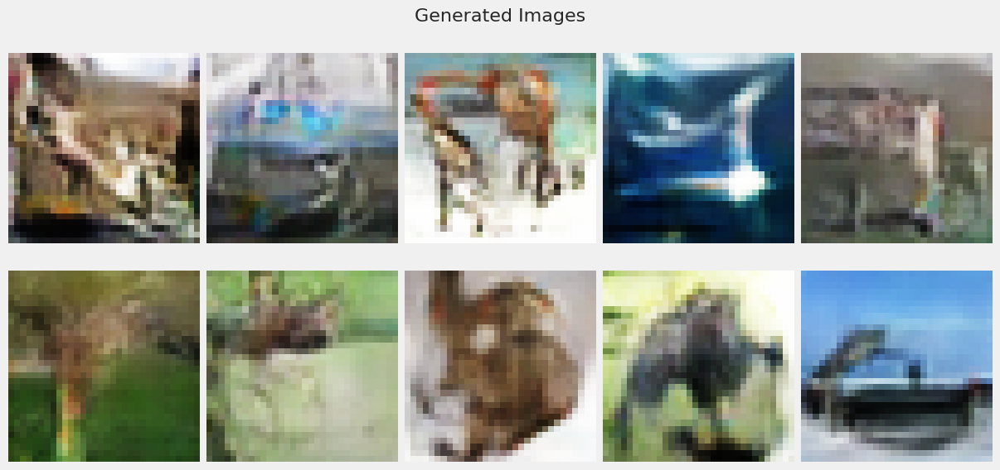

782/782 [==============================] - 11s 14ms/step - d_real_loss: 0.6899 - d_fake_loss: 0.6848 - g_loss: 0.7460 - d_acc: 0.5299 - d_realO: 0.4955 - d_fakeO: 0.5057
Epoch 82/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6890 - d_fake_loss: 0.6842 - g_loss: 0.7449 - d_acc: 0.5339 - d_realO: 0.4953 - d_fakeO: 0.5057
Epoch 83/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6890 - d_fake_loss: 0.6847 - g_loss: 0.7460 - d_acc: 0.5319 - d_realO: 0.4954 - d_fakeO: 0.5059
Epoch 84/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6884 - d_fake_loss: 0.6852 - g_loss: 0.7455 - d_acc: 0.5329 - d_realO: 0.4950 - d_fakeO: 0.5056
Epoch 85/100
782/782 [==============================] - 9s 12ms/step - d_real_loss: 0.6886 - d_fake_loss: 0.6842 - g_loss: 0.7513 - d_acc: 0.5341 - d_realO: 0.4951 - d_fakeO: 0.5061
Epoch 86/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6883 - d_fak

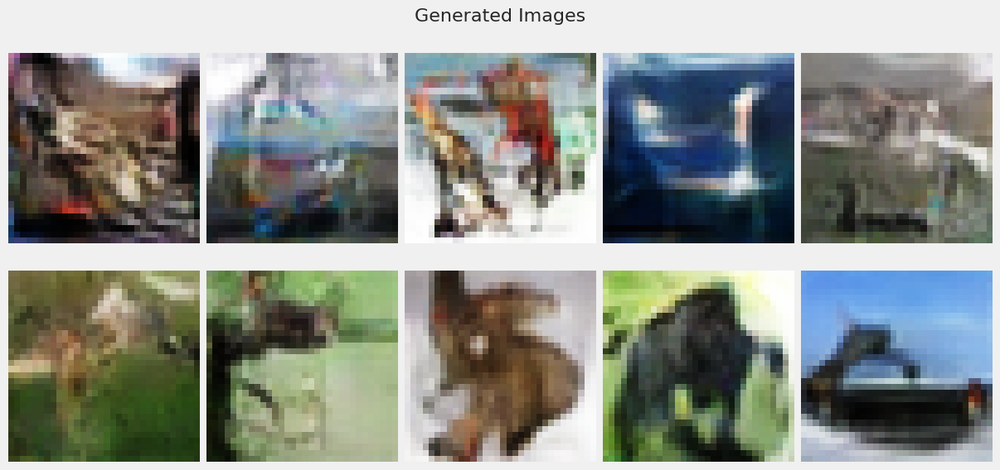

782/782 [==============================] - 11s 14ms/step - d_real_loss: 0.6873 - d_fake_loss: 0.6820 - g_loss: 0.7524 - d_acc: 0.5412 - d_realO: 0.4941 - d_fakeO: 0.5072
Epoch 92/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6866 - d_fake_loss: 0.6828 - g_loss: 0.7521 - d_acc: 0.5409 - d_realO: 0.4937 - d_fakeO: 0.5071
Epoch 93/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6868 - d_fake_loss: 0.6827 - g_loss: 0.7568 - d_acc: 0.5379 - d_realO: 0.4936 - d_fakeO: 0.5073
Epoch 94/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6867 - d_fake_loss: 0.6823 - g_loss: 0.7535 - d_acc: 0.5409 - d_realO: 0.4937 - d_fakeO: 0.5074
Epoch 95/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6861 - d_fake_loss: 0.6824 - g_loss: 0.7578 - d_acc: 0.5432 - d_realO: 0.4936 - d_fakeO: 0.5072
Epoch 96/100
782/782 [==============================] - 10s 12ms/step - d_real_loss: 0.6870 - d_fa

In [50]:
gan_3 = train_gan(discriminator_dcgan3, generator_dcgan3, noise, 'Baseline DCGAN 3', dataset, 100, callbacks=callbacks)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Looking at the accuracy, we can see that the discriminator ended with a  54% which shows that both are pretty evenly match
- No model collapse


</div>

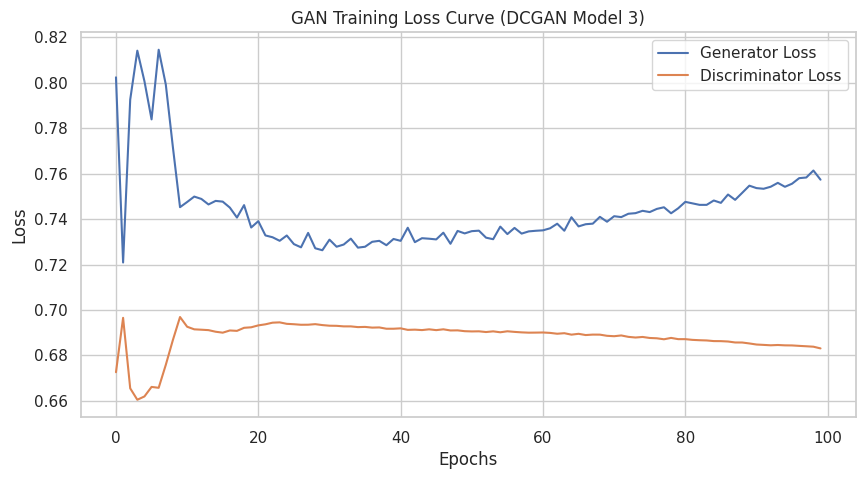

In [51]:
gan_history_3 = gan_3[0].history
generator = gan_3[1].generator  
gan_history_3['d_loss'] = [(real_loss + fake_loss) / 2 for real_loss, fake_loss in zip(gan_history_3['d_real_loss'], gan_history_3['d_fake_loss'])]
evaluator = Evaluation(generator, latent_dim, 512, 10000, 1024)
evaluator.plot_loss_curve(gan_history_3, title='GAN Training Loss Curve (DCGAN Model 3)')

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Discriminator loss
    - For the discriminator loss, it starts relatively low and rises quickly and continues to increase steadily as the epochs increases
- Generator loss
    - For the generator loss, it increases with a spike and drops and proceeded to increase slowly


</div>

In [52]:
tf.keras.backend.clear_session()
K.clear_session()
scores1 = evaluator.compute_metrics(x_train)
print('FID Score:', scores1[0])
print('KID Score:', scores1[1])

None
313/313 [==============================] - 1s 2ms/step
FID Score: 47.78930818226691
KID Score: 0.03075274375525261


<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- FID Score of 47 
- KID Score is 0.03
    
It improved further compared to the previous two models

</div>

2/2 [==============================] - 1s 24ms/step


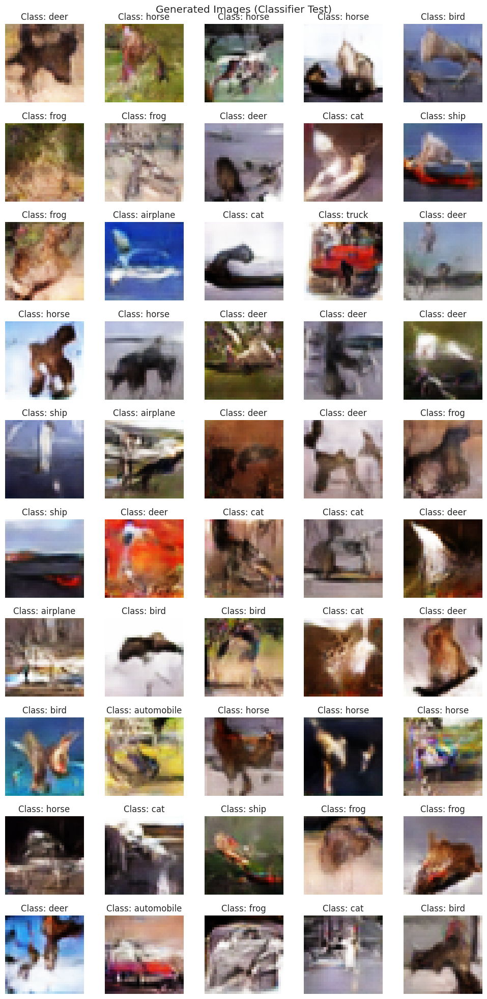

In [53]:
latent_dim = 128  
num_images = 50  
noise = tf.random.normal([num_images, latent_dim])
generated_images = generator.predict(noise)
generated_images = (generated_images + 1) / 2
generated_images = generated_images * 255
generated_images = np.clip(generated_images, 0, 255).astype('uint8')
generated_images_resized = tf.image.resize(generated_images, [224, 224]).numpy().astype('uint8')
predictions = model_c.predict(generated_images_resized)
predicted_classes = np.argmax(predictions, axis=-1)
num_columns = 5
num_rows = num_images // num_columns + (num_images % num_columns > 0)
fig, axes = plt.subplots(num_rows, num_columns, figsize=(num_columns * 2, num_rows * 2))
fig.suptitle('Generated Images (Classifier Test)')
for i, ax in enumerate(axes.flatten()):
    if i >= num_images:
        break
    ax.imshow(generated_images[i])
    ax.set_title(f'Class: {class_labels[predicted_classes[i]]}')
    ax.axis('off')
plt.tight_layout()
plt.show()

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Generally, we can tell most of the animal images like deer, dog and cars and ships are able to be seen

</div>

4/4 [==============================] - 0s 3ms/step


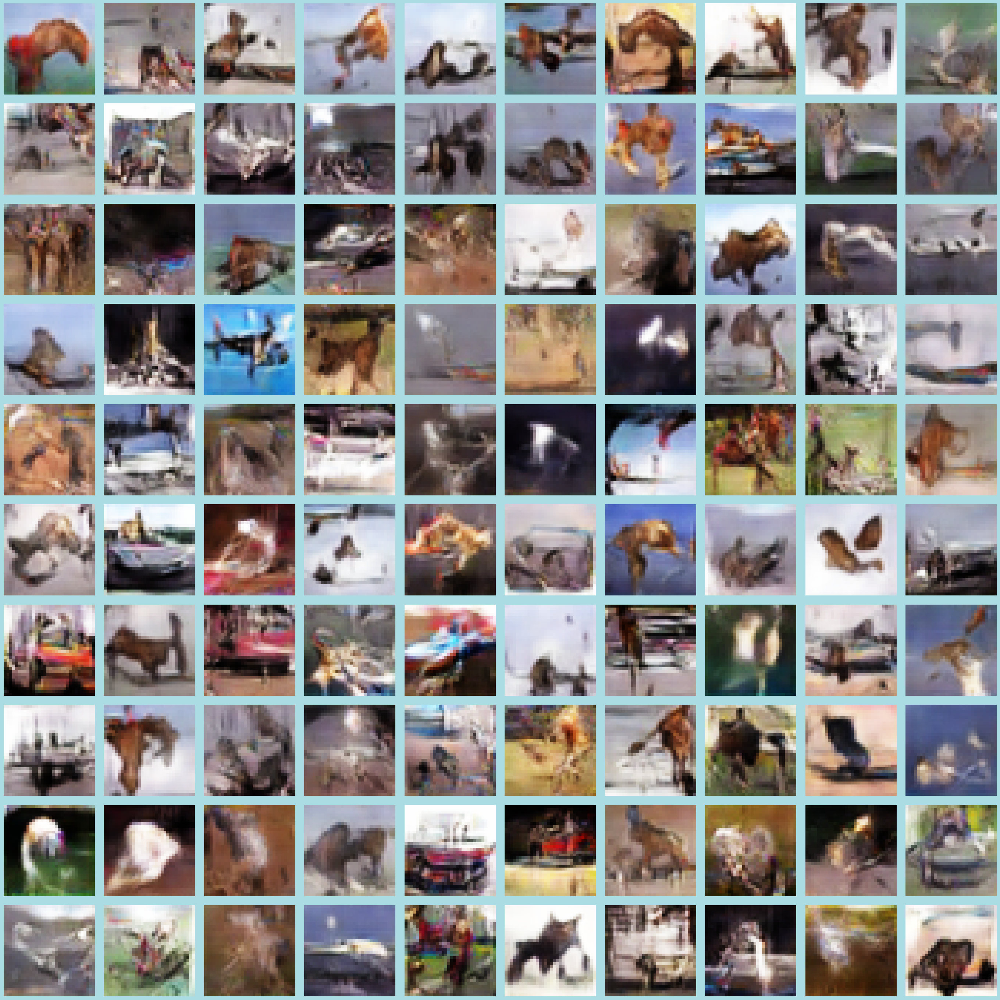

4/4 [==============================] - 0s 2ms/step


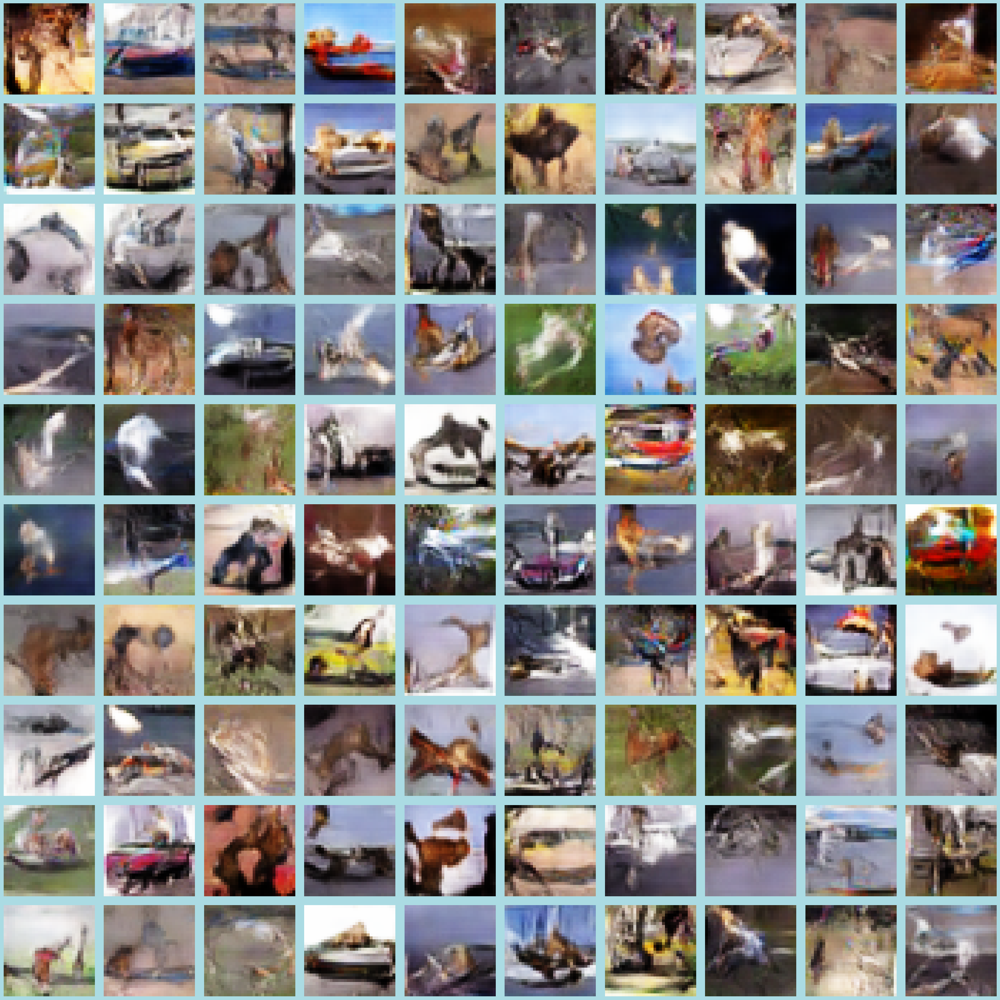

4/4 [==============================] - 0s 3ms/step


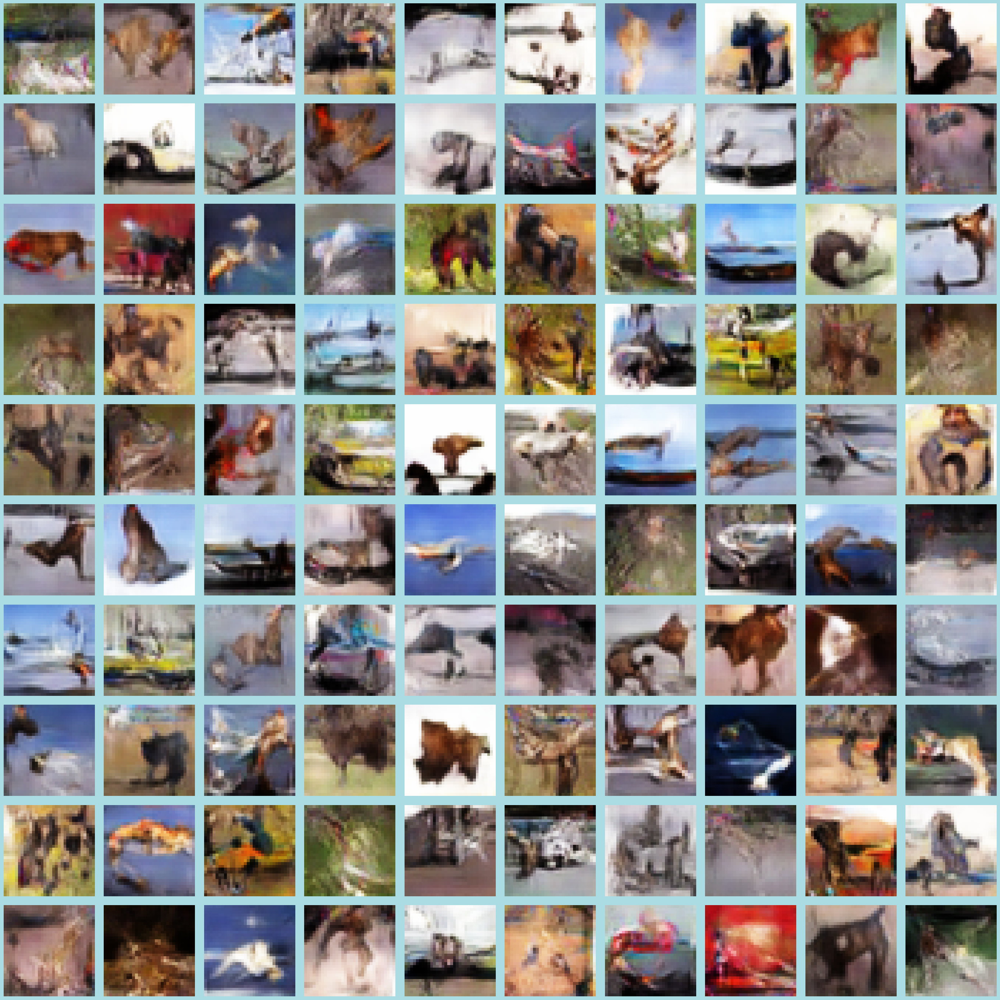

4/4 [==============================] - 0s 2ms/step


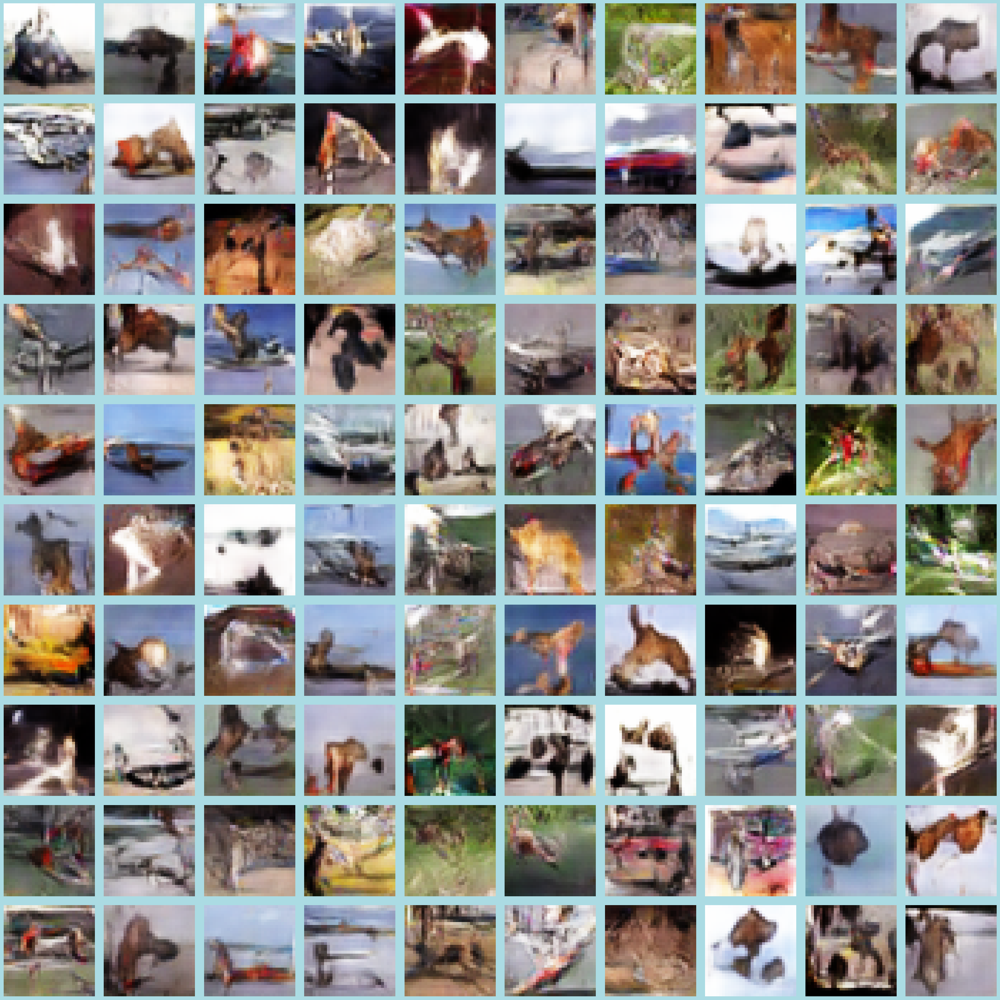

4/4 [==============================] - 0s 3ms/step


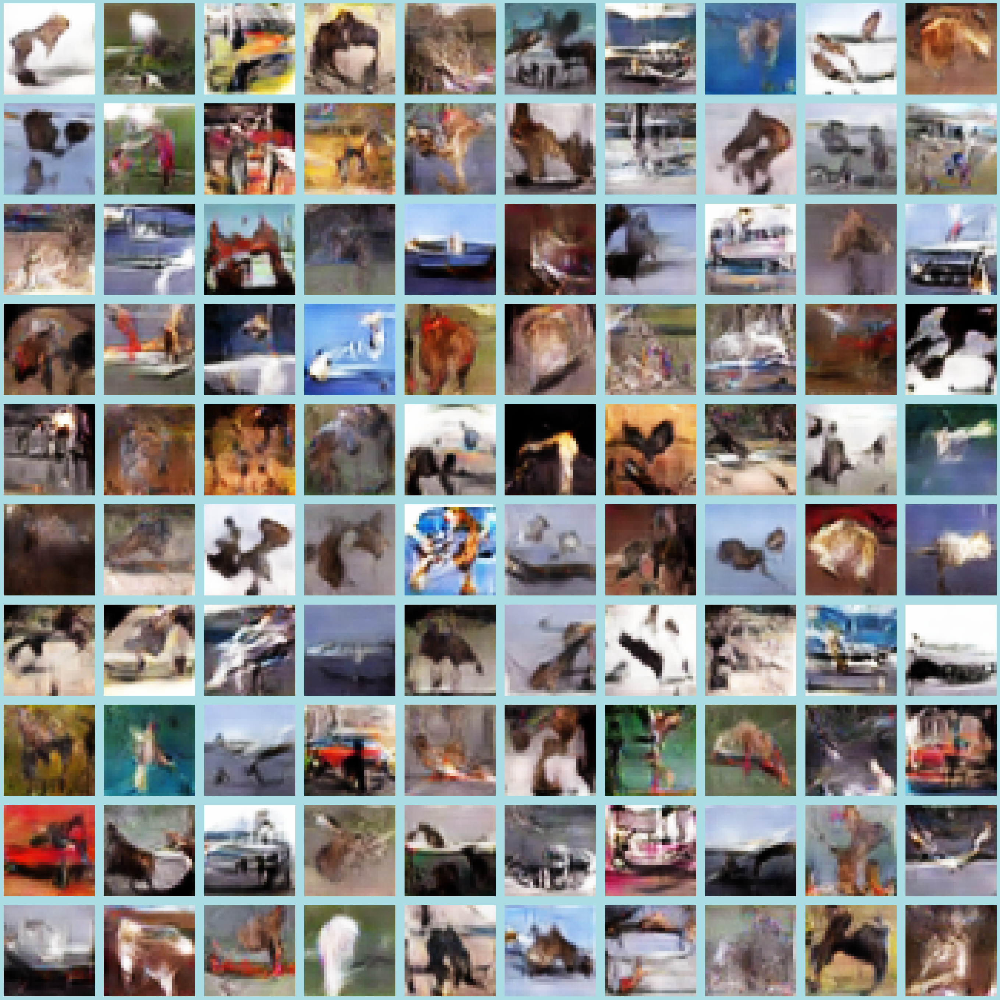

4/4 [==============================] - 0s 2ms/step


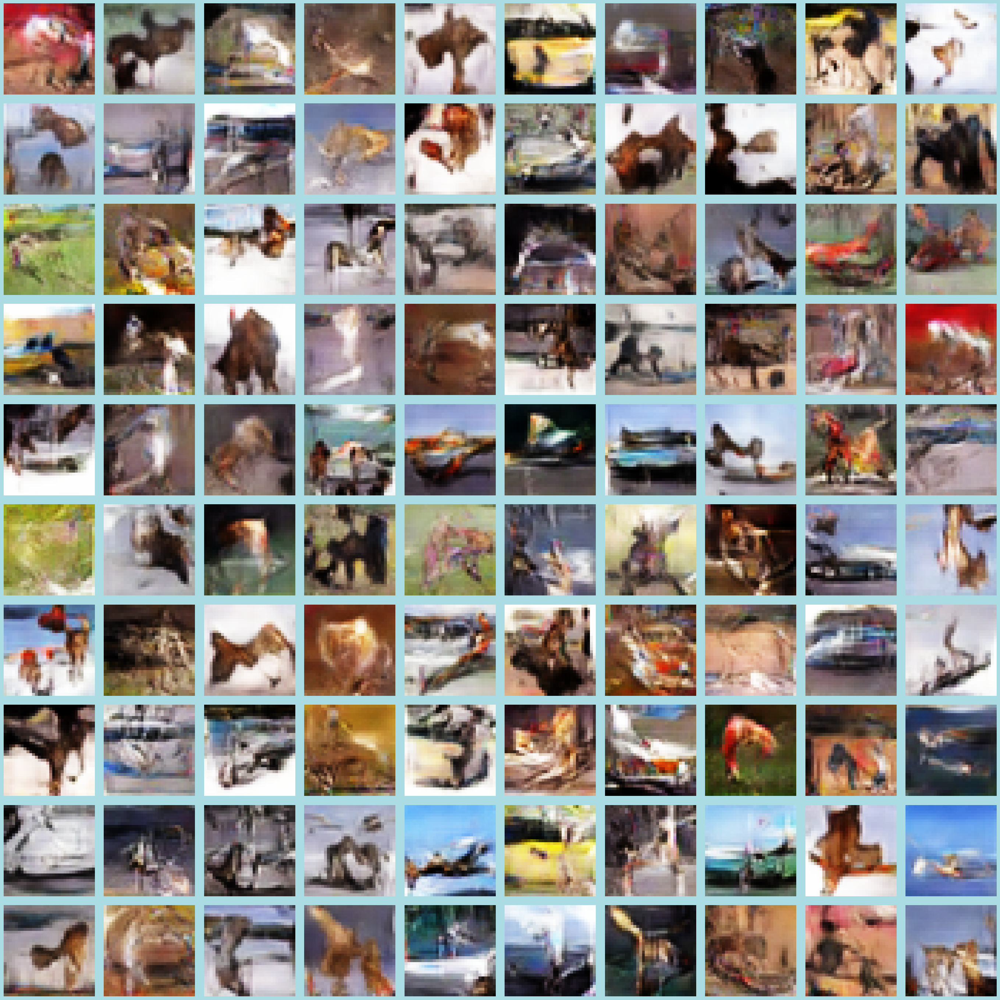

4/4 [==============================] - 0s 3ms/step


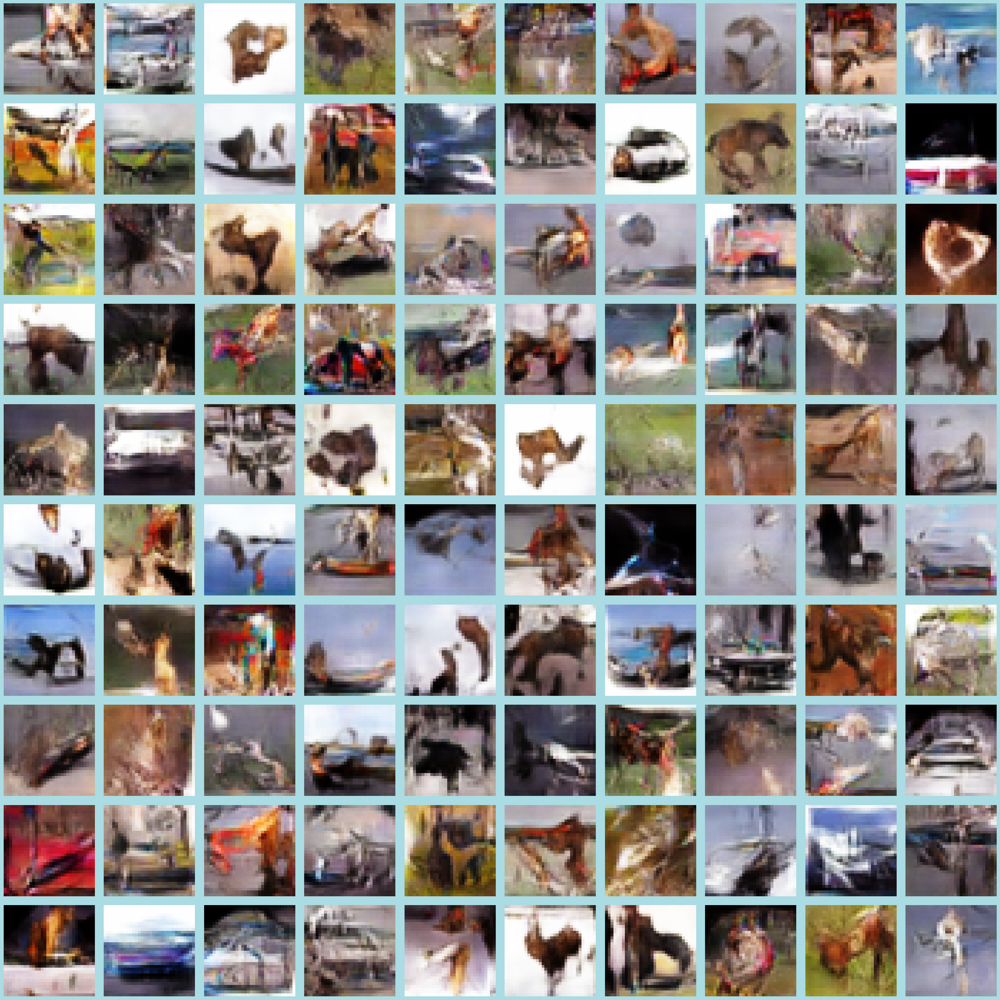

4/4 [==============================] - 0s 3ms/step


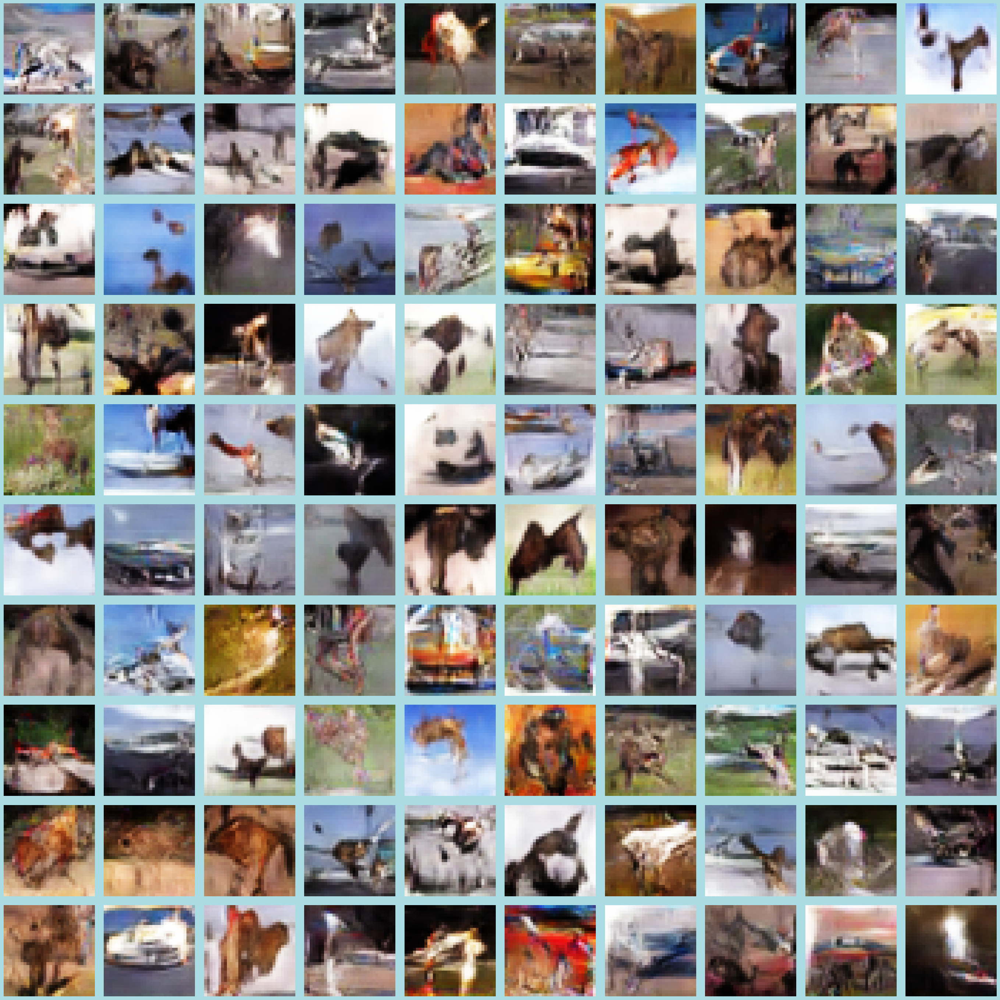

4/4 [==============================] - 0s 3ms/step


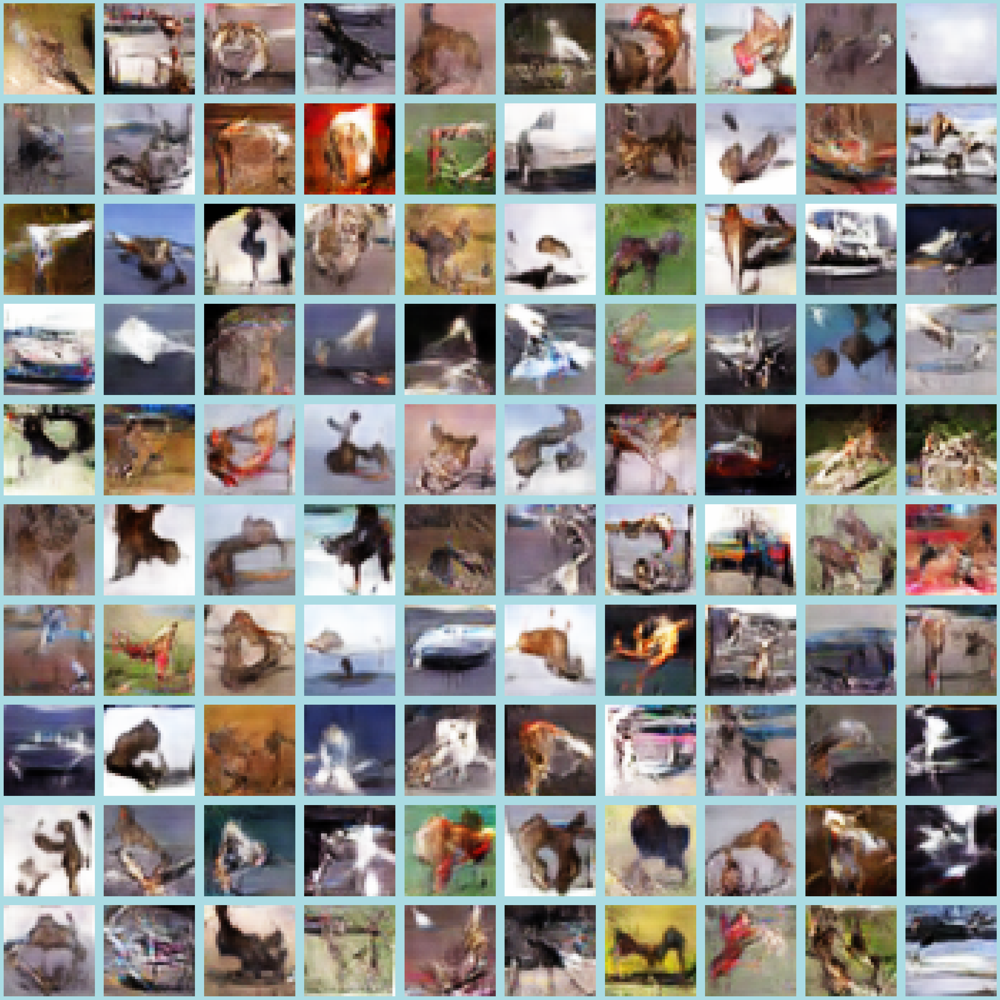

4/4 [==============================] - 0s 3ms/step


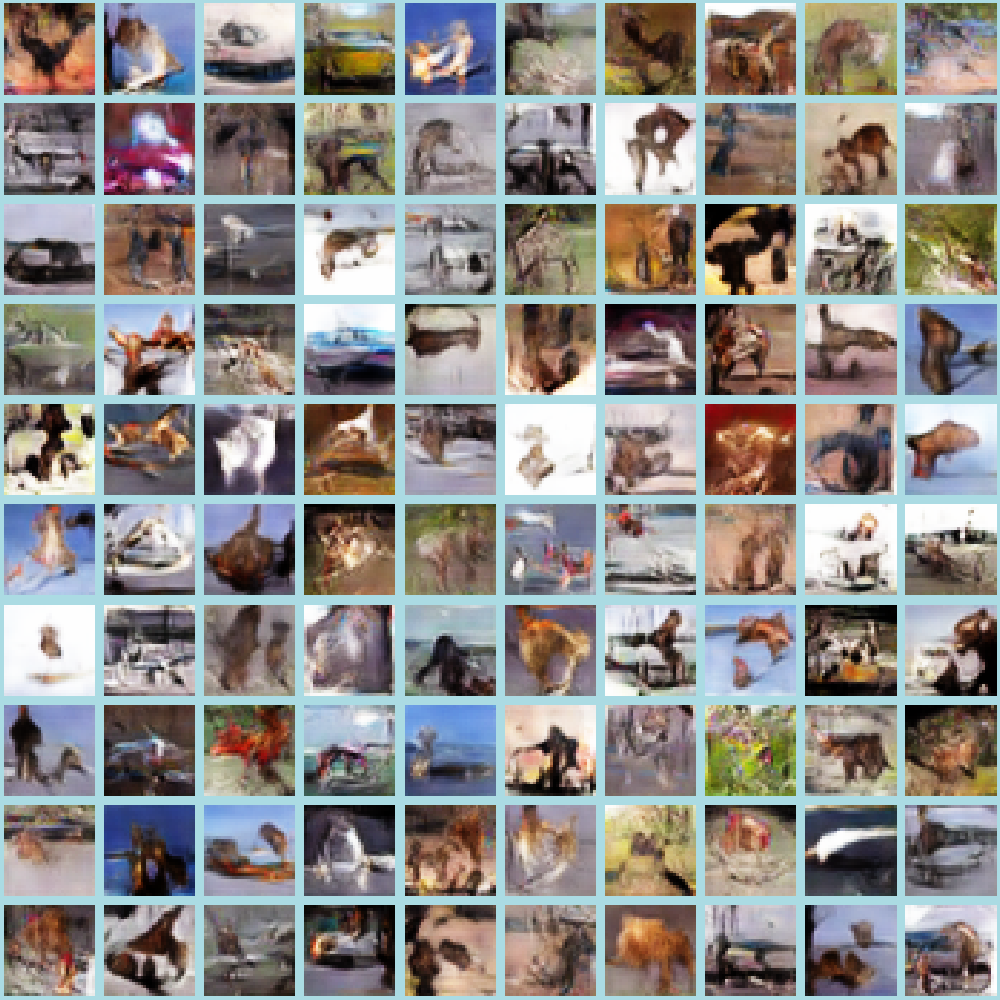

In [54]:
generate_1000(generator)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- 1000 images provided similar idea compared to comparing it with a classifier

</div>

#### Storing the scores

In [55]:
new_row = {'Model':'Baseline DCGAN 3', 'FID':scores1[0], 'KID': scores1[1], 'd_loss':gan_history_3['d_loss'][-1], 'g_loss':gan_history_3['g_loss'][-1] }
new_df = pd.DataFrame([new_row])
full_scores = pd.concat([full_scores, new_df], ignore_index=True)
full_scores

,Model,FID,KID,d_loss,g_loss
0,Baseline DCGAN 1,53.235623,0.039666,0.229398,3.687913
1,Baseline DCGAN 2,54.338184,0.041610,0.275021,3.177531
2,Baseline DCGAN 3,47.789308,0.030753,0.683071,0.757343


### Fourth Model

##### Generator

__Key Difference__
1. Change of relu function to prelu

__Key Ideas__

1. **Input and Dense Layer**:
    - **Dense Layer**: 
        - **Units**: The layer has 4 * 4 * 512 units
        - **Input**: Takes an input of dimension `latent_dim` representing the latent space
        - **Kernel Initializer**: Utilizes `RandomNormal` with a standard deviation of 0.02 
2. **Reshape Layer**:
    - **New Shape**: Reshapes the output of the Dense layer into an 4x4x512 tensor.

3. **Normalization and Activation**:
    - **BatchNormalization**: 
    - **PreLu**:
4. **Transposed Convolution Layers**:
    - **Conv2DTranspose (First Layer)**:
        - **Filters**: 256
        - **Kernel Size**: 5x5
        - **Strides**: 2
        - **Padding**: 'same'

    - **Conv2DTranspose (Second Layer)**:
        - **Filters**: 128
        - **Kernel Size**: 5x5
        - **Strides**: 2
        - **Padding**: 'same'

    - **Conv2DTranspose (Third Layer)**:
        - **Filters**: 3 (corresponding to RGB channels)
        - **Kernel Size**: 5x5
        - **Strides**: 2
        - **Padding**: 'same'
        - **Activation**: 'tanh'


In [56]:
def build_generator():
    latent_dim = 128
    weights_init = RandomNormal(mean=0, stddev=0.02)
    dropout_rate = 0.3 

    model = Sequential()
    model.add(Input(shape=(latent_dim,)))
    model.add(Dense(4 * 4 * 512, kernel_initializer=weights_init))
    model.add(Reshape((4, 4, 512)))
    model.add(BatchNormalization())
    model.add(PReLU())

    model.add(Conv2DTranspose(256, kernel_size=4, strides=2, padding='same', kernel_initializer=weights_init))
    model.add(BatchNormalization())
    model.add(PReLU())
    model.add(Dropout(dropout_rate))

    model.add(Conv2DTranspose(128, kernel_size=4, strides=2, padding='same', kernel_initializer=weights_init))
    model.add(BatchNormalization())
    model.add(PReLU())
    model.add(Dropout(dropout_rate))

    model.add(Conv2DTranspose(3, kernel_size=4, strides=2, padding='same', activation='tanh', kernel_initializer=weights_init))

    return model

##### Discriminator

__Key Changes__
1. Use of Spectral Normalisation
    - **Roles**: Usual normalisation will stop if the derivatives of the discriminator turn out to be 0 
    - Prevent this by normalising the weight matrix instead of normalising the function 
    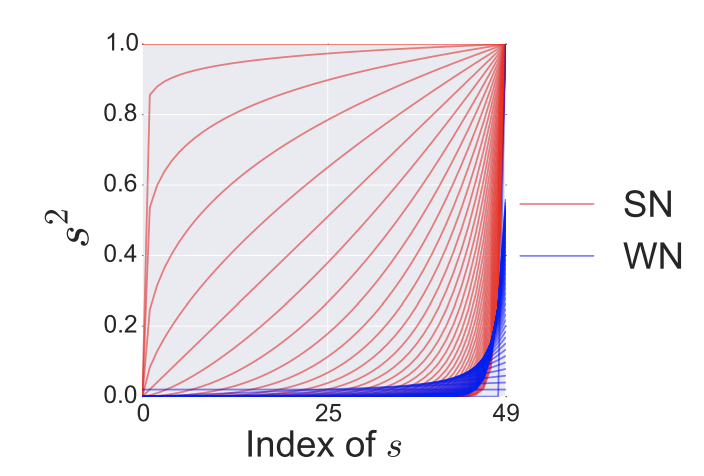
    
__Key Ideas__

1. **Model Initialization**:
    - **Weights Initialization**: Uses `RandomNormal(mean=0, stddev=0.02)` for initializing the weights of the layers.
    - **Dropout Rate**:  0.3

2. **Input Layer**:
    - **Input Shape**: (32, 32, 3), accepts RGB images of size 32x32 pixels.

3. **Convolutional and Regularization Layers**:
    - **Conv2D with SpectralNormalization (Four Layers)**:
        - **Filters**: Increasing number of filters with each layer (64, 128, 256, 512)
        - **Kernel Size**: (4, 4) for all layers.
        - **Strides**: (2, 2) 
        - **Padding**: 'same' 
        - **Kernel Initializer**: `weights_init`
    - **LeakyReLU (after each Conv2D)**:
        - **Alpha**: 0.2
    - **Dropout (after each LeakyReLU)**:
        - **Rate**: `dropout_rate`, added after each LeakyReLU layer for regularization.

4. **Flattening and Output Layer**:
    - **Flatten**: Transforms the 3D feature maps into a 1D feature vector, preparing it for the dense output layer.
    - **Dense**:
        - **Units**: 1, the output layer for binary classification.
        - **Activation**: 'sigmoid'

In [57]:
def build_discriminator():
    weights_init = RandomNormal(mean=0, stddev=0.02)
    dropout_rate = 0.3  
    model = Sequential()
    model.add(Input(shape=(32, 32, 3)))

    model.add(SpectralNormalization(
        Conv2D(64, kernel_size=4, strides=2, padding='same', kernel_initializer=weights_init)))
    model.add(LeakyReLU(0.2))
    model.add(Dropout(dropout_rate))

    model.add(SpectralNormalization(
        Conv2D(128, kernel_size=4, strides=2, padding='same', kernel_initializer=weights_init)))
    model.add(LeakyReLU(0.2))
    model.add(Dropout(dropout_rate))

    model.add(SpectralNormalization(
        Conv2D(256, kernel_size=4, strides=2, padding='same', kernel_initializer=weights_init)))
    model.add(LeakyReLU(0.2))
    model.add(Dropout(dropout_rate))

    model.add(SpectralNormalization(
        Conv2D(512, kernel_size=4, strides=2, padding='same', kernel_initializer=weights_init)))
    model.add(LeakyReLU(0.2))
    model.add(Dropout(dropout_rate))

    model.add(Flatten())
    model.add(Dense(1, activation='sigmoid'))

    return model



#### Creating Checkpoint

In [58]:
callbacks = [ImageGenerationCallback(num_img=10, noise=128, vmin=-1, vmax=1), ModelCheckpointCallback(model_dir='baselineDCGAN-4')]

#### Training

In [59]:
discriminator_dcgan4 = build_discriminator()
generator_dcgan4 = build_generator()

In [60]:
tf.keras.backend.clear_session()
K.clear_session()

Epoch 1/100
782/782 [==============================] - ETA: 0s - d_real_loss: 0.2901 - d_fake_loss: 0.3008 - g_loss: 3.6374 - d_acc: 0.8971 - d_realO: 0.1559 - d_fakeO: 0.8264

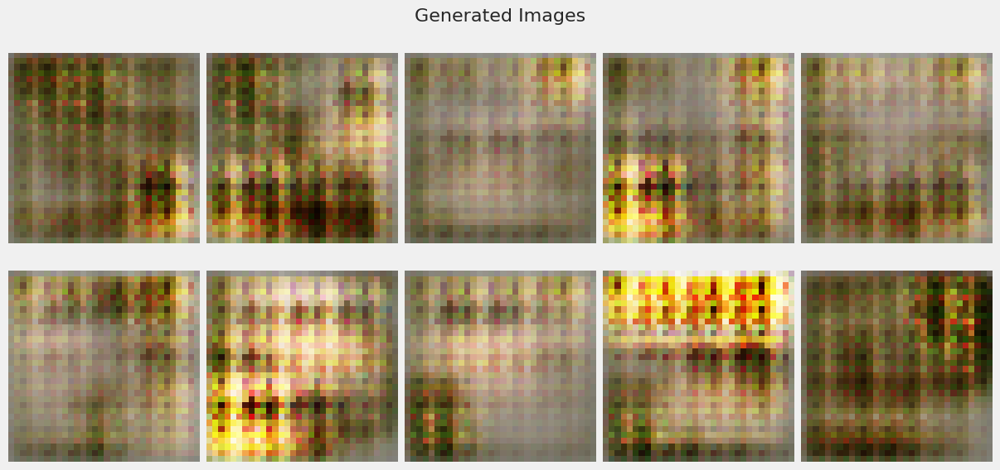

782/782 [==============================] - 20s 22ms/step - d_real_loss: 0.2901 - d_fake_loss: 0.3007 - g_loss: 3.6374 - d_acc: 0.8971 - d_realO: 0.1560 - d_fakeO: 0.8265
Epoch 2/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.3821 - d_fake_loss: 0.2903 - g_loss: 2.8356 - d_acc: 0.8616 - d_realO: 0.2362 - d_fakeO: 0.7663
Epoch 3/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.3422 - d_fake_loss: 0.2843 - g_loss: 3.1493 - d_acc: 0.8736 - d_realO: 0.1977 - d_fakeO: 0.7999
Epoch 4/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.3336 - d_fake_loss: 0.2765 - g_loss: 3.3977 - d_acc: 0.8723 - d_realO: 0.1974 - d_fakeO: 0.8055
Epoch 5/100
782/782 [==============================] - 17s 21ms/step - d_real_loss: 0.3405 - d_fake_loss: 0.2851 - g_loss: 3.2466 - d_acc: 0.8660 - d_realO: 0.2035 - d_fakeO: 0.7968
Epoch 6/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.3762 - d_fake_lo

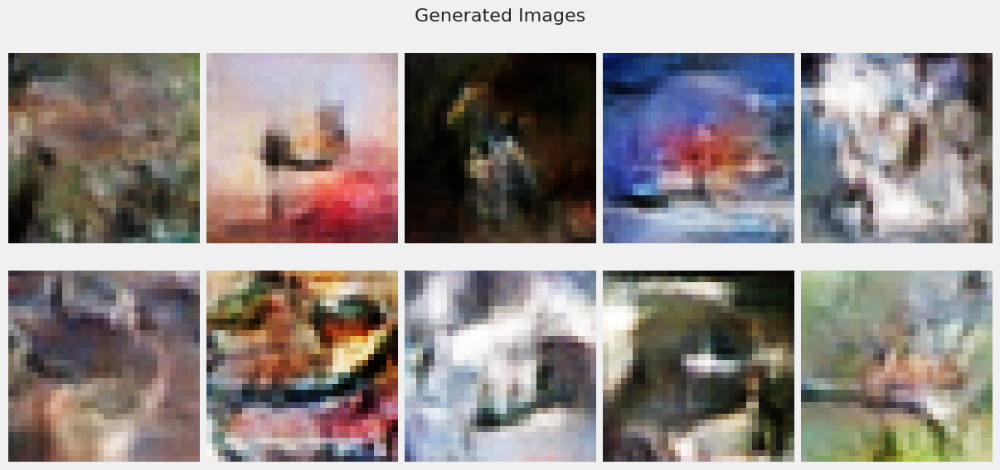

782/782 [==============================] - 18s 22ms/step - d_real_loss: 0.5024 - d_fake_loss: 0.4466 - g_loss: 1.8020 - d_acc: 0.7677 - d_realO: 0.3248 - d_fakeO: 0.6756
Epoch 12/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.5291 - d_fake_loss: 0.4828 - g_loss: 1.6424 - d_acc: 0.7488 - d_realO: 0.3461 - d_fakeO: 0.6551
Epoch 13/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.5424 - d_fake_loss: 0.4996 - g_loss: 1.5738 - d_acc: 0.7379 - d_realO: 0.3539 - d_fakeO: 0.6459
Epoch 14/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.5537 - d_fake_loss: 0.5051 - g_loss: 1.5439 - d_acc: 0.7297 - d_realO: 0.3580 - d_fakeO: 0.6424
Epoch 15/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.5535 - d_fake_loss: 0.5110 - g_loss: 1.5284 - d_acc: 0.7279 - d_realO: 0.3582 - d_fakeO: 0.6418
Epoch 16/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.5497 - d_fa

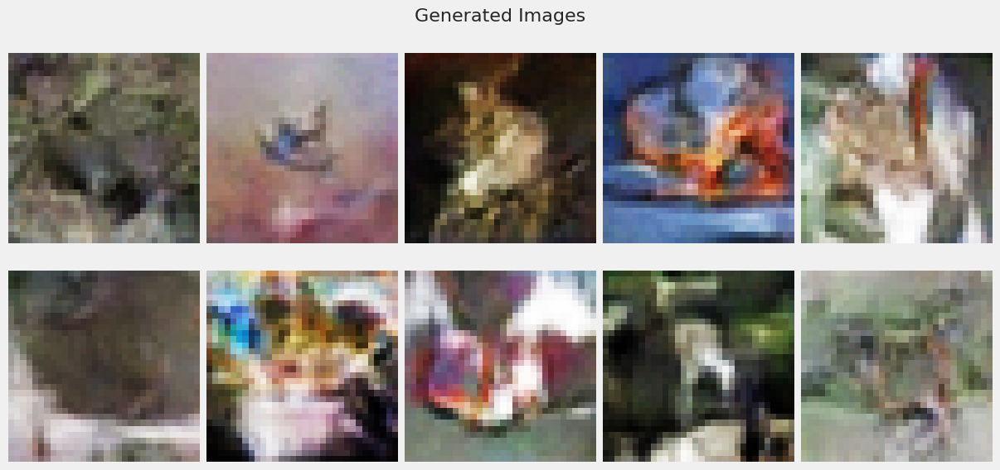

782/782 [==============================] - 17s 22ms/step - d_real_loss: 0.5209 - d_fake_loss: 0.4672 - g_loss: 1.6481 - d_acc: 0.7551 - d_realO: 0.3325 - d_fakeO: 0.6674
Epoch 22/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.5167 - d_fake_loss: 0.4648 - g_loss: 1.6681 - d_acc: 0.7591 - d_realO: 0.3284 - d_fakeO: 0.6720
Epoch 23/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.5104 - d_fake_loss: 0.4559 - g_loss: 1.6968 - d_acc: 0.7649 - d_realO: 0.3215 - d_fakeO: 0.6787
Epoch 24/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.5064 - d_fake_loss: 0.4657 - g_loss: 1.7376 - d_acc: 0.7670 - d_realO: 0.3140 - d_fakeO: 0.6866
Epoch 25/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.5123 - d_fake_loss: 0.4872 - g_loss: 1.7506 - d_acc: 0.7620 - d_realO: 0.3157 - d_fakeO: 0.6845
Epoch 26/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.4721 - d_fa

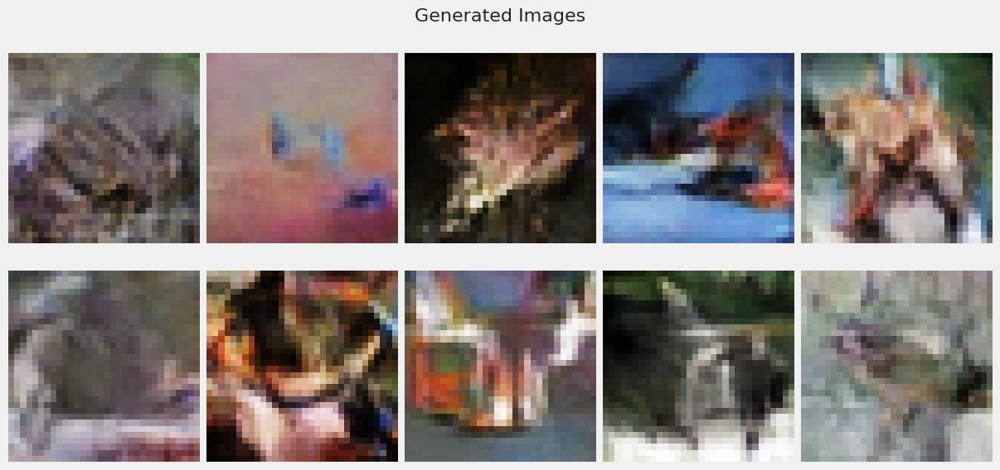

782/782 [==============================] - 17s 22ms/step - d_real_loss: 0.4189 - d_fake_loss: 0.3845 - g_loss: 2.1481 - d_acc: 0.8150 - d_realO: 0.2624 - d_fakeO: 0.7375
Epoch 32/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.3926 - d_fake_loss: 0.3578 - g_loss: 2.2477 - d_acc: 0.8310 - d_realO: 0.2488 - d_fakeO: 0.7508
Epoch 33/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.3887 - d_fake_loss: 0.3565 - g_loss: 2.3207 - d_acc: 0.8320 - d_realO: 0.2431 - d_fakeO: 0.7564
Epoch 34/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.3839 - d_fake_loss: 0.3631 - g_loss: 2.3980 - d_acc: 0.8346 - d_realO: 0.2333 - d_fakeO: 0.7665
Epoch 35/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.3558 - d_fake_loss: 0.3284 - g_loss: 2.5234 - d_acc: 0.8495 - d_realO: 0.2224 - d_fakeO: 0.7772
Epoch 36/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.3405 - d_fa

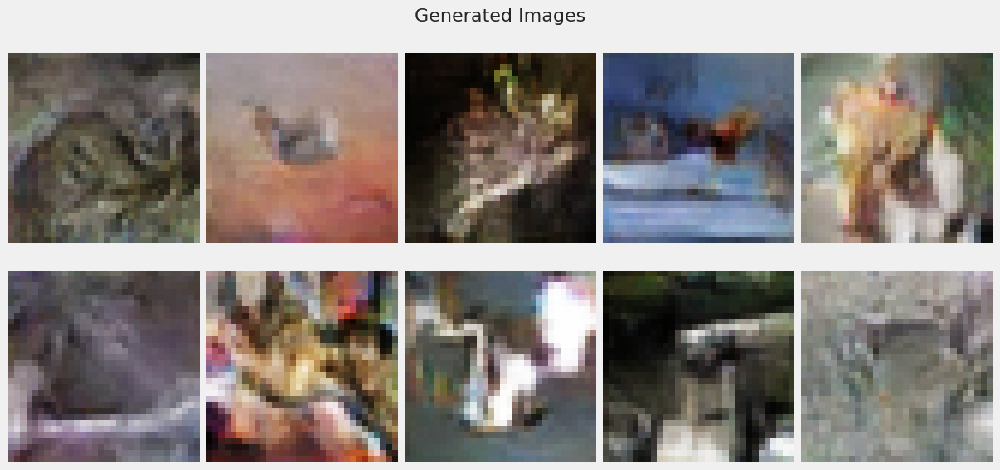

782/782 [==============================] - 18s 22ms/step - d_real_loss: 0.2758 - d_fake_loss: 0.2667 - g_loss: 2.9638 - d_acc: 0.8900 - d_realO: 0.1769 - d_fakeO: 0.8228
Epoch 42/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.2660 - d_fake_loss: 0.2563 - g_loss: 3.1532 - d_acc: 0.8924 - d_realO: 0.1689 - d_fakeO: 0.8308
Epoch 43/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.2570 - d_fake_loss: 0.2588 - g_loss: 3.3058 - d_acc: 0.8939 - d_realO: 0.1627 - d_fakeO: 0.8365
Epoch 44/100
782/782 [==============================] - 17s 21ms/step - d_real_loss: 0.2470 - d_fake_loss: 0.2443 - g_loss: 3.4192 - d_acc: 0.9013 - d_realO: 0.1516 - d_fakeO: 0.8481
Epoch 45/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.2385 - d_fake_loss: 0.2448 - g_loss: 3.5801 - d_acc: 0.9033 - d_realO: 0.1478 - d_fakeO: 0.8514
Epoch 46/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.2292 - d_fa

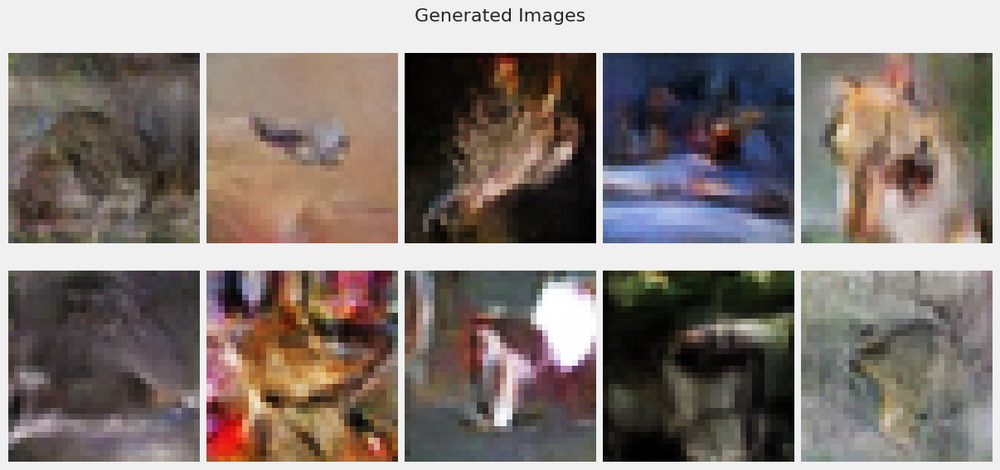

782/782 [==============================] - 18s 22ms/step - d_real_loss: 0.1865 - d_fake_loss: 0.2017 - g_loss: 4.1769 - d_acc: 0.9242 - d_realO: 0.1177 - d_fakeO: 0.8814
Epoch 52/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.1861 - d_fake_loss: 0.1982 - g_loss: 4.3084 - d_acc: 0.9255 - d_realO: 0.1143 - d_fakeO: 0.8854
Epoch 53/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.1926 - d_fake_loss: 0.2295 - g_loss: 4.3717 - d_acc: 0.9208 - d_realO: 0.1143 - d_fakeO: 0.8852
Epoch 54/100
782/782 [==============================] - 17s 21ms/step - d_real_loss: 0.1598 - d_fake_loss: 0.1765 - g_loss: 4.4744 - d_acc: 0.9373 - d_realO: 0.1047 - d_fakeO: 0.8948
Epoch 55/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.1673 - d_fake_loss: 0.1887 - g_loss: 4.6397 - d_acc: 0.9334 - d_realO: 0.1159 - d_fakeO: 0.8832
Epoch 56/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.1561 - d_fa

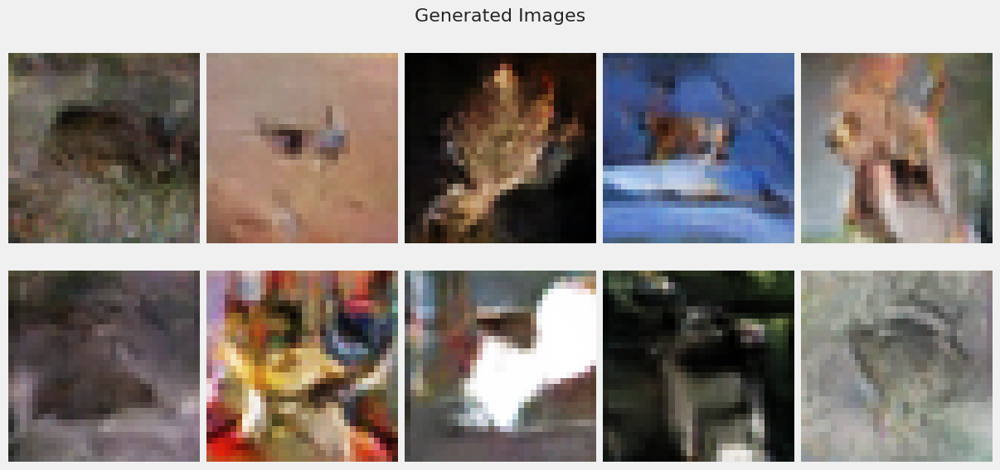

782/782 [==============================] - 18s 22ms/step - d_real_loss: 0.1447 - d_fake_loss: 0.1682 - g_loss: 5.0754 - d_acc: 0.9412 - d_realO: 0.0902 - d_fakeO: 0.9091
Epoch 62/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.1541 - d_fake_loss: 0.1769 - g_loss: 5.1682 - d_acc: 0.9408 - d_realO: 0.0963 - d_fakeO: 0.9033
Epoch 63/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.1325 - d_fake_loss: 0.1547 - g_loss: 5.0920 - d_acc: 0.9474 - d_realO: 0.0860 - d_fakeO: 0.9135
Epoch 64/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.1387 - d_fake_loss: 0.1670 - g_loss: 5.2273 - d_acc: 0.9429 - d_realO: 0.0879 - d_fakeO: 0.9117
Epoch 65/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.1352 - d_fake_loss: 0.1610 - g_loss: 5.3288 - d_acc: 0.9447 - d_realO: 0.0856 - d_fakeO: 0.9142
Epoch 66/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.1277 - d_fa

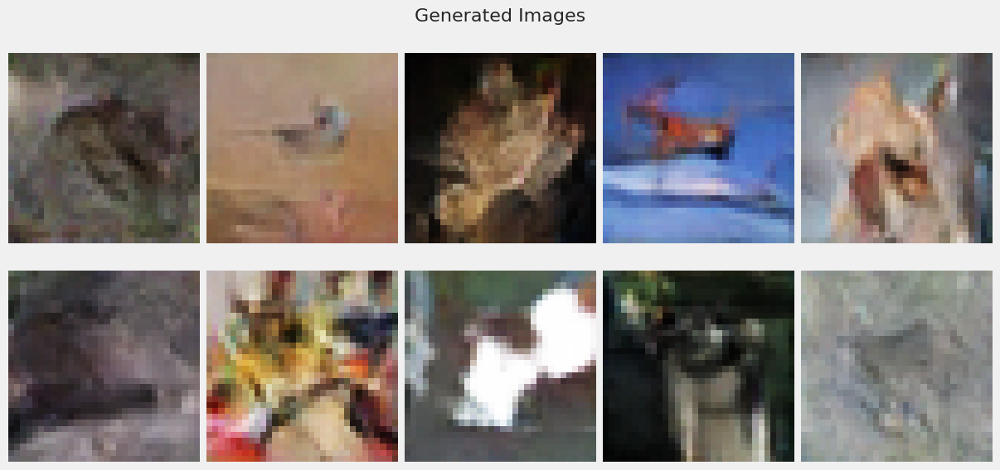

782/782 [==============================] - 18s 23ms/step - d_real_loss: 0.2160 - d_fake_loss: 0.3101 - g_loss: 5.4059 - d_acc: 0.9188 - d_realO: 0.0862 - d_fakeO: 0.9135
Epoch 72/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.1259 - d_fake_loss: 0.1527 - g_loss: 5.6097 - d_acc: 0.9491 - d_realO: 0.0806 - d_fakeO: 0.9190
Epoch 73/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.1232 - d_fake_loss: 0.1518 - g_loss: 5.6751 - d_acc: 0.9495 - d_realO: 0.0782 - d_fakeO: 0.9214
Epoch 74/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.1308 - d_fake_loss: 0.1635 - g_loss: 5.7102 - d_acc: 0.9459 - d_realO: 0.0810 - d_fakeO: 0.9187
Epoch 75/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.1259 - d_fake_loss: 0.1546 - g_loss: 5.7529 - d_acc: 0.9484 - d_realO: 0.0779 - d_fakeO: 0.9217
Epoch 76/100
782/782 [==============================] - 16s 20ms/step - d_real_loss: 0.1197 - d_fa

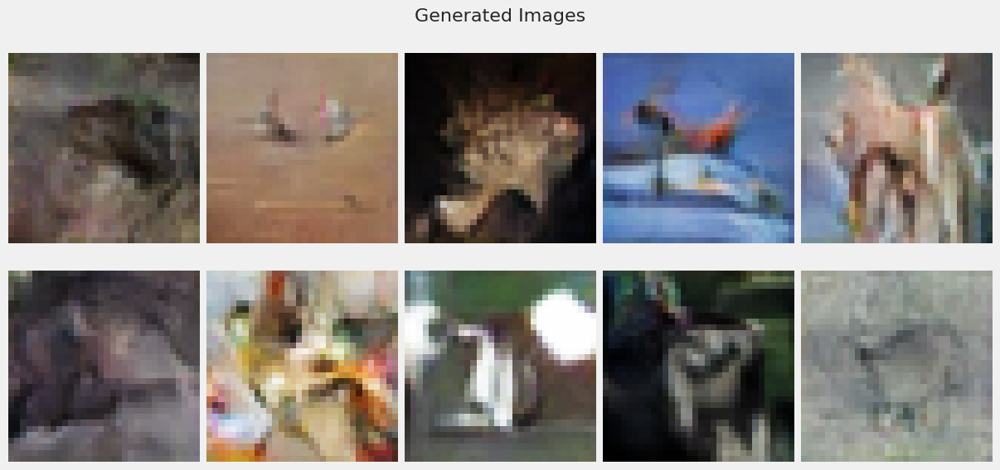

782/782 [==============================] - 18s 23ms/step - d_real_loss: 0.1277 - d_fake_loss: 0.1577 - g_loss: 6.0480 - d_acc: 0.9477 - d_realO: 0.0745 - d_fakeO: 0.9249
Epoch 82/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.2119 - d_fake_loss: 0.2833 - g_loss: 5.9264 - d_acc: 0.9274 - d_realO: 0.0748 - d_fakeO: 0.9251
Epoch 83/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.1064 - d_fake_loss: 0.1345 - g_loss: 6.0927 - d_acc: 0.9563 - d_realO: 0.0711 - d_fakeO: 0.9288
Epoch 84/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.1175 - d_fake_loss: 0.1491 - g_loss: 6.1386 - d_acc: 0.9510 - d_realO: 0.0718 - d_fakeO: 0.9276
Epoch 85/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.1327 - d_fake_loss: 0.1672 - g_loss: 6.1697 - d_acc: 0.9471 - d_realO: 0.0709 - d_fakeO: 0.9289
Epoch 86/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.1111 - d_fa

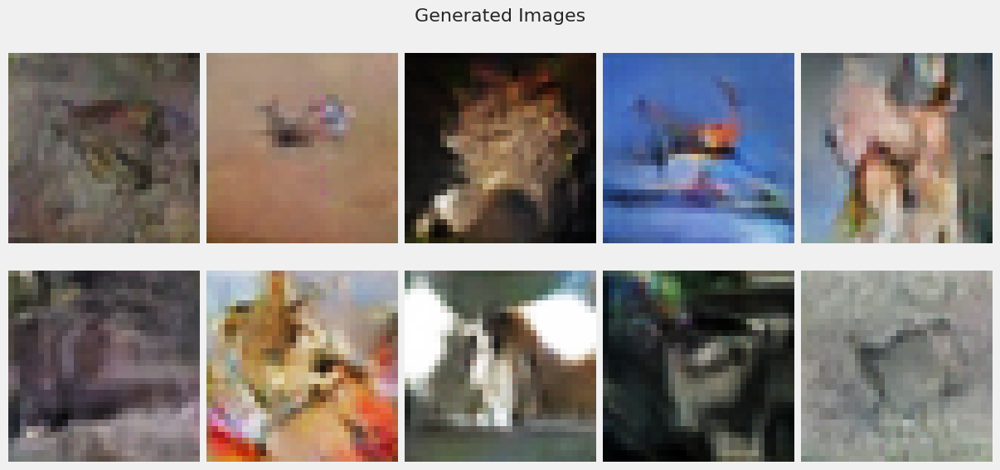

782/782 [==============================] - 18s 22ms/step - d_real_loss: 0.1123 - d_fake_loss: 0.1389 - g_loss: 6.2757 - d_acc: 0.9526 - d_realO: 0.0684 - d_fakeO: 0.9314
Epoch 92/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.1111 - d_fake_loss: 0.1444 - g_loss: 6.3317 - d_acc: 0.9535 - d_realO: 0.0690 - d_fakeO: 0.9303
Epoch 93/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.1163 - d_fake_loss: 0.1423 - g_loss: 6.4412 - d_acc: 0.9526 - d_realO: 0.0693 - d_fakeO: 0.9306
Epoch 94/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.1109 - d_fake_loss: 0.1367 - g_loss: 6.4056 - d_acc: 0.9547 - d_realO: 0.0668 - d_fakeO: 0.9329
Epoch 95/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.1091 - d_fake_loss: 0.1373 - g_loss: 6.4748 - d_acc: 0.9558 - d_realO: 0.0668 - d_fakeO: 0.9330
Epoch 96/100
782/782 [==============================] - 16s 21ms/step - d_real_loss: 0.1066 - d_fa

In [61]:
gan_4 = train_gan(discriminator_dcgan4, generator_dcgan4, noise, 'Baseline DCGAN 4', dataset, 100, callbacks=callbacks)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Looking at the accuracy, we can see that the discriminator ended with a  95% accuracy while it may not be the best, it did show that it is not able to fully determine real and fake as it started from 0.6
- No Model Collapse


</div>

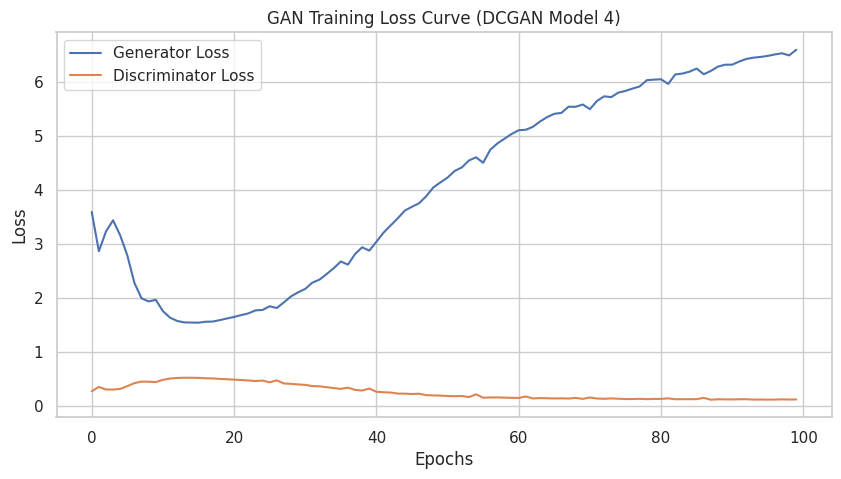

In [62]:
gan_history_4 = gan_4[0].history
generator = gan_4[1].generator  
gan_history_4['d_loss'] = [(real_loss + fake_loss) / 2 for real_loss, fake_loss in zip(gan_history_4['d_real_loss'], gan_history_4['d_fake_loss'])]
evaluator = Evaluation(generator, latent_dim, 512, 10000, 1024)
evaluator.plot_loss_curve(gan_history_4, title='GAN Training Loss Curve (DCGAN Model 4)')

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Discriminator loss
    - For the discriminator loss, it starts relatively low and rises quickly and continues to increase steadily as the epochs increases
- Generator loss
    - For the generator loss, it increases with a spike and drops and proceeded to increase slowly


</div>

In [63]:
tf.keras.backend.clear_session()
K.clear_session()
scores1 = evaluator.compute_metrics(x_train)
print('FID Score:', scores1[0])
print('KID Score:', scores1[1])

None
313/313 [==============================] - 1s 3ms/step
FID Score: 61.77129860890003
KID Score: 0.047135170994074826


<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- FID Score of 62
- KID Score is 0.047
    
It is not too good, let us see if we can improve

</div>

2/2 [==============================] - 1s 23ms/step


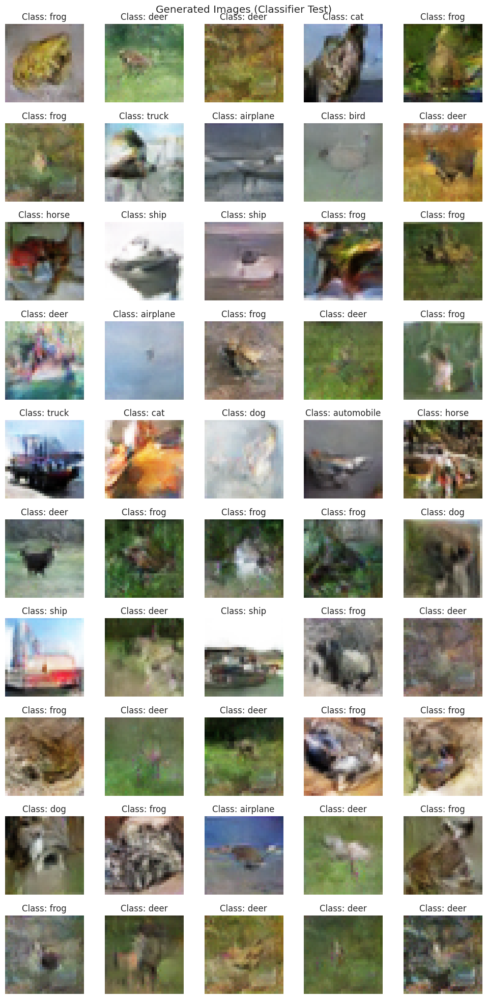

In [64]:
latent_dim = 128  
num_images = 50  
noise = tf.random.normal([num_images, latent_dim])
generated_images = generator.predict(noise)
generated_images = (generated_images + 1) / 2
generated_images = generated_images * 255
generated_images = np.clip(generated_images, 0, 255).astype('uint8')
generated_images_resized = tf.image.resize(generated_images, [224, 224]).numpy().astype('uint8')
predictions = model_c.predict(generated_images_resized)
predicted_classes = np.argmax(predictions, axis=-1)
num_columns = 5
num_rows = num_images // num_columns + (num_images % num_columns > 0)
fig, axes = plt.subplots(num_rows, num_columns, figsize=(num_columns * 2, num_rows * 2))
fig.suptitle('Generated Images (Classifier Test)')
for i, ax in enumerate(axes.flatten()):
    if i >= num_images:
        break
    ax.imshow(generated_images[i])
    ax.set_title(f'Class: {class_labels[predicted_classes[i]]}')
    ax.axis('off')
plt.tight_layout()
plt.show()

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Generally, we can tell most of the animal images like deer, dog but cars and ships images are not poroduced

</div>

4/4 [==============================] - 0s 7ms/step


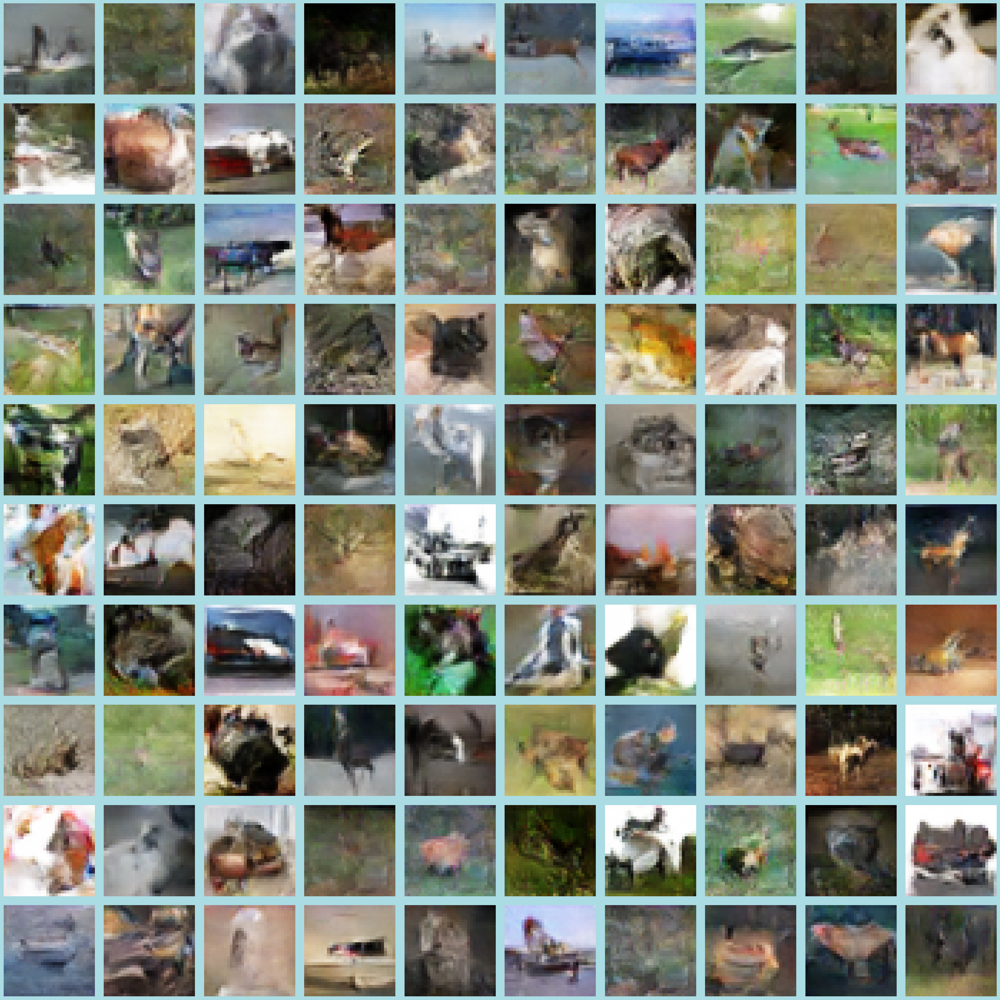

4/4 [==============================] - 0s 3ms/step


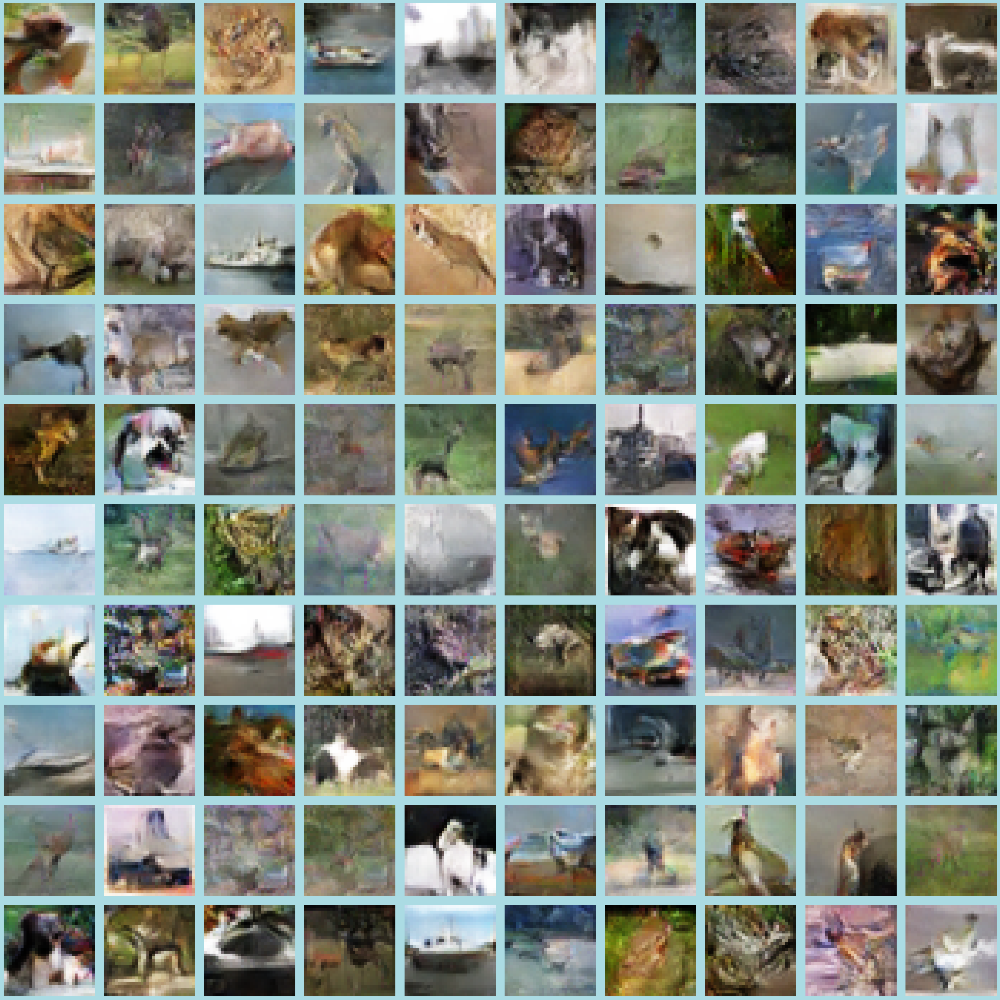

4/4 [==============================] - 0s 3ms/step


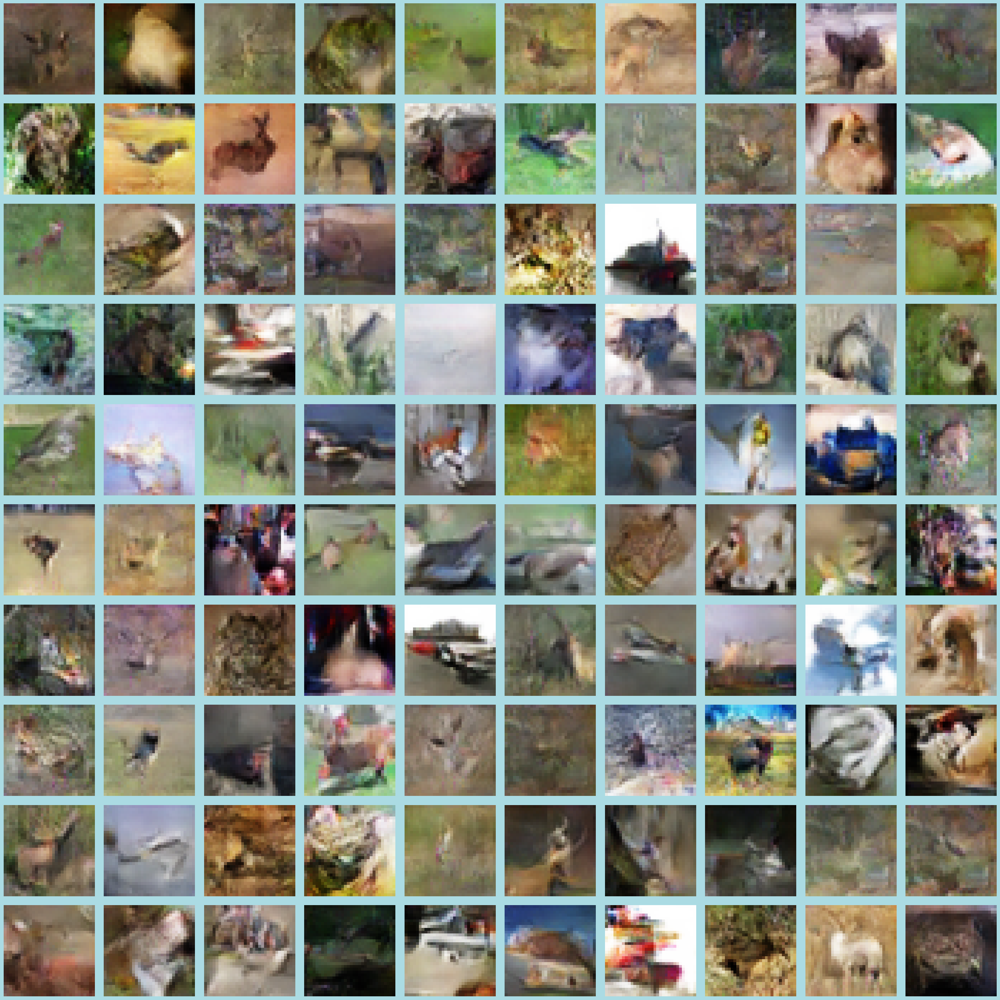

4/4 [==============================] - 0s 3ms/step


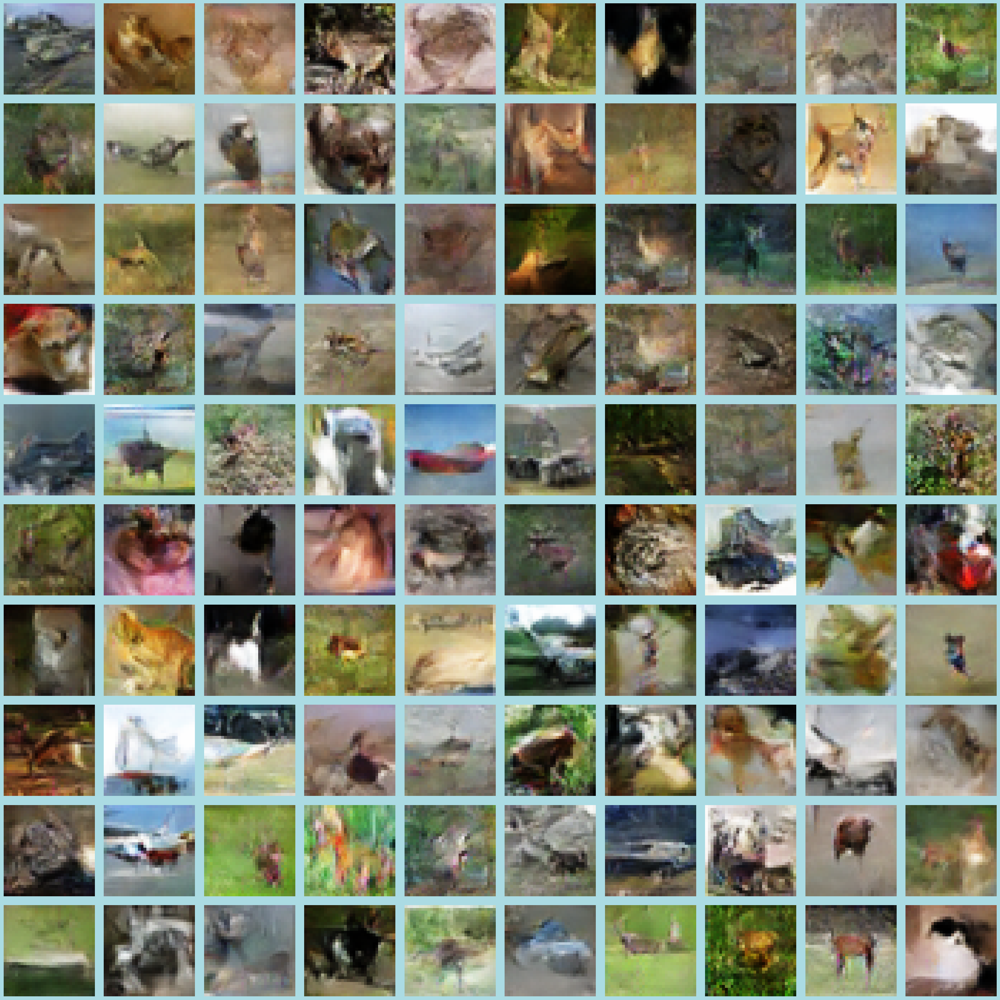

4/4 [==============================] - 0s 3ms/step


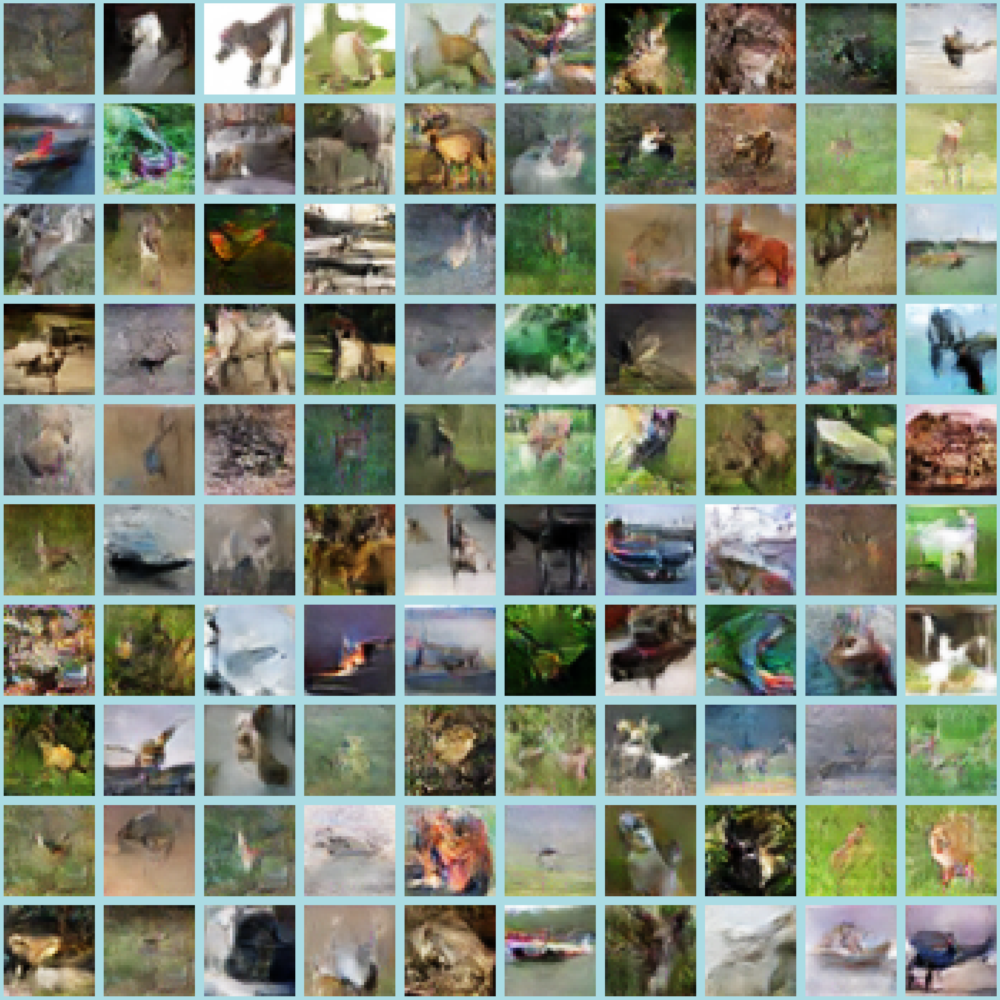

4/4 [==============================] - 0s 3ms/step


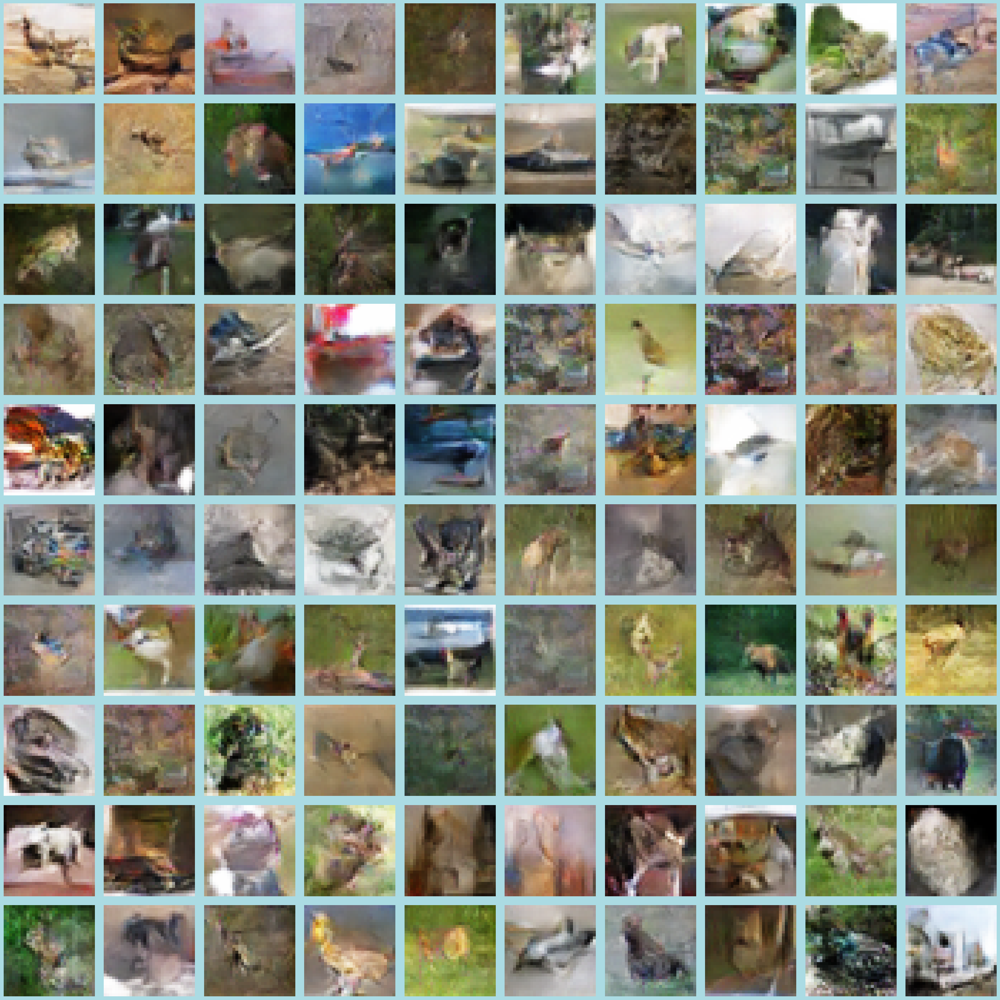

4/4 [==============================] - 0s 4ms/step


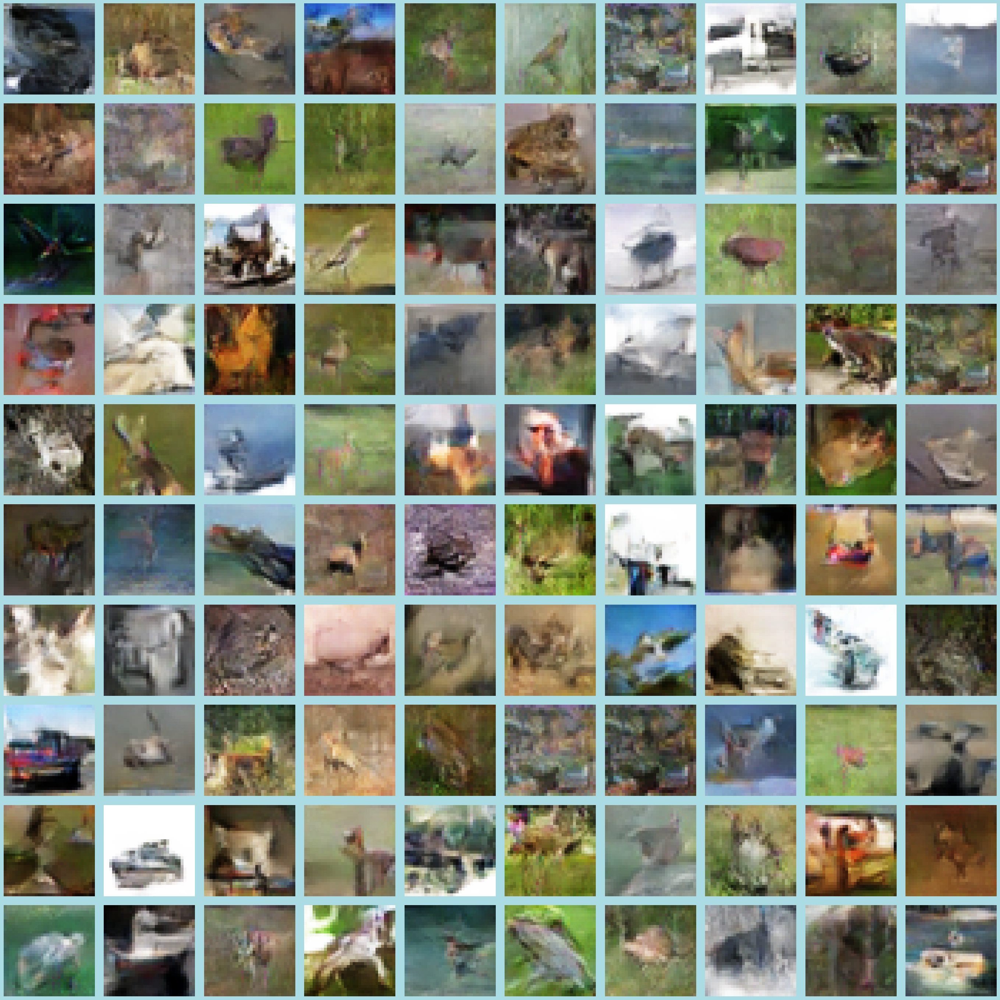

4/4 [==============================] - 0s 3ms/step


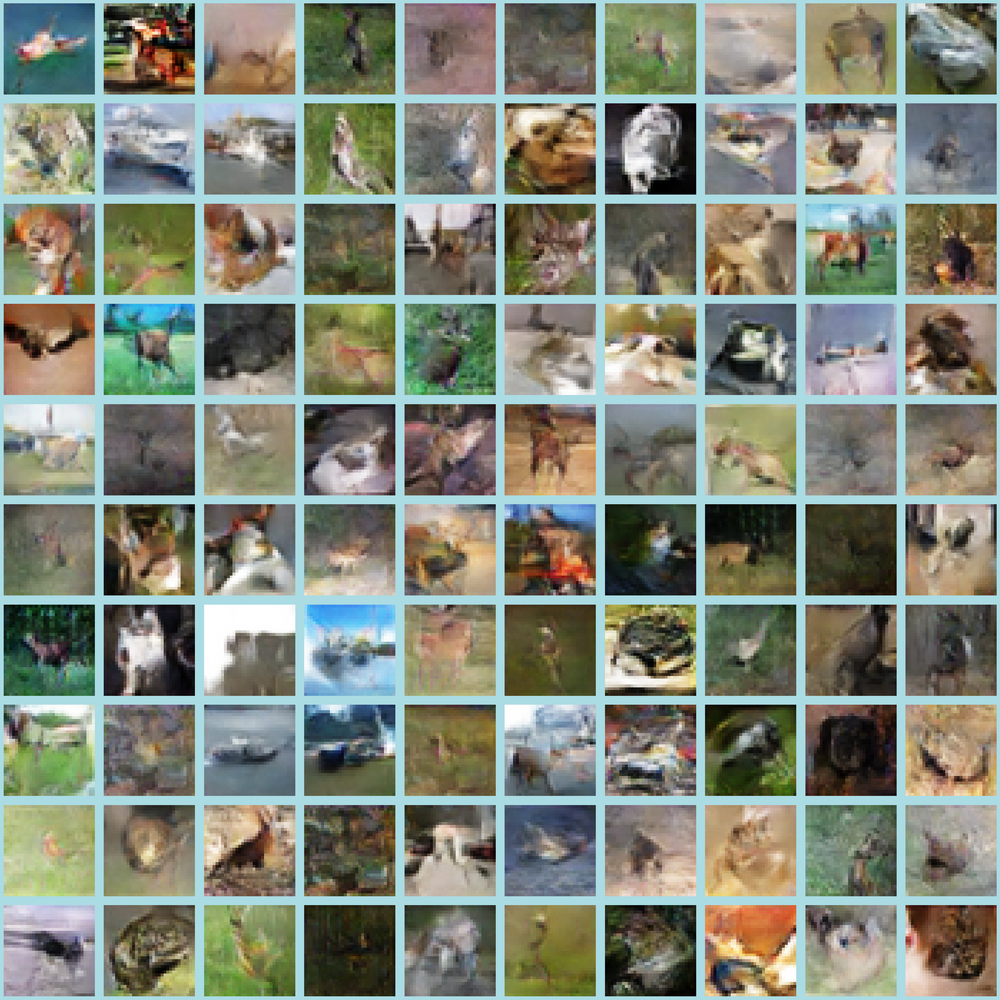

4/4 [==============================] - 0s 2ms/step


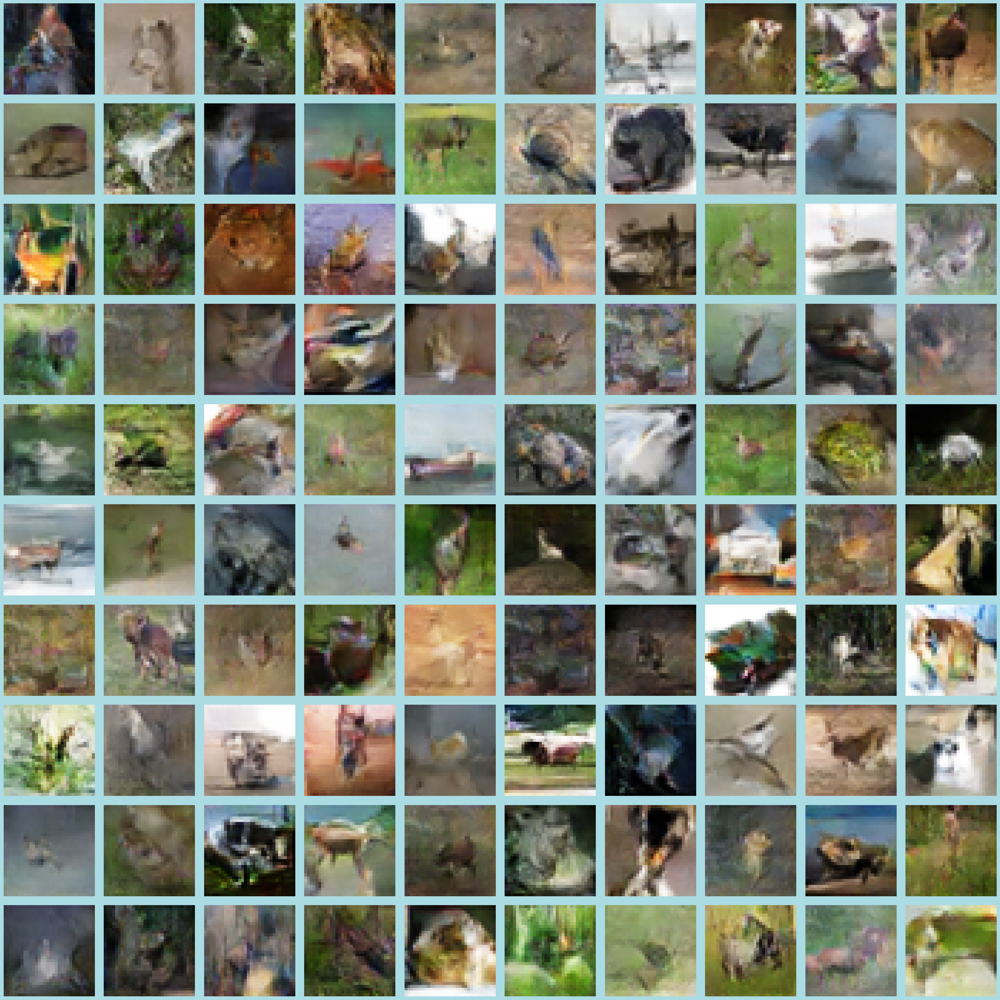

4/4 [==============================] - 0s 3ms/step


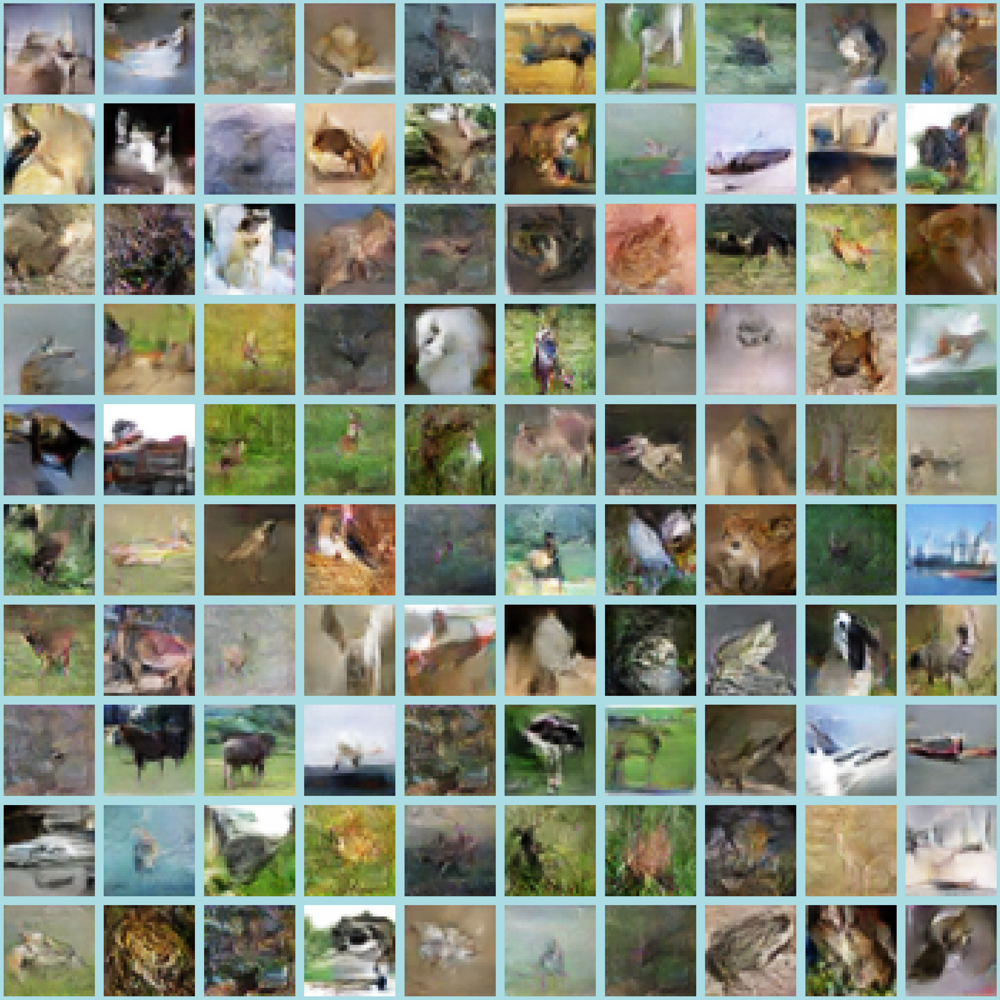

In [65]:
generate_1000(generator)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- 1000 images provided similar idea compared to comparing it with a classifier

</div>

#### Storing the scores

In [66]:
new_row = {'Model':'Baseline DCGAN 4', 'FID':scores1[0], 'KID': scores1[1], 'd_loss':gan_history_4['d_loss'][-1], 'g_loss':gan_history_4['g_loss'][-1] }
new_df = pd.DataFrame([new_row])
full_scores = pd.concat([full_scores, new_df], ignore_index=True)
full_scores

,Model,FID,KID,d_loss,g_loss
0,Baseline DCGAN 1,53.235623,0.039666,0.229398,3.687913
1,Baseline DCGAN 2,54.338184,0.041610,0.275021,3.177531
2,Baseline DCGAN 3,47.789308,0.030753,0.683071,0.757343
3,Baseline DCGAN 4,61.771299,0.047135,0.123955,6.587285


### Fifth Model

##### Generator

__Key Difference__
1. Addition of separate upsample block to set the use of batch normlisation, activation depending on the situation

__Key Ideas__

1. **Input and Dense Layer**:
    - **Input**: 128
    - **Dense Layer**: 
        - **Units**: 2 * 2 * 512
        - **Use Bias**: False

2. **Activation and Reshape Layer**:
    - **LeakyReLU**:
        - **Alpha**: 0.2
    - **Reshape**:
        - **New Shape**: Reshapes the output of the Dense layer into a 2x2x512 tensor, preparing it for the convolutional operations.

3. **Upsampling Blocks**:
    - The model uses a custom `upsample_block` function for upsampling, which includes:
        - **Upsampling**:
            - **Size**: Doubles the dimensions of the feature maps.
        - **Conv2D**:
            - **Filters**:(128, 64, 64, and 3 for the final block).
            - **Kernel Size**: (3, 3) for all blocks.
            - **Strides**: (1, 1) for all blocks.
            - **Padding**: 'same'
            - **Use Bias**: False.
        - **BatchNormalization**: Applied if `use_bn` is True.
        - **Activation**: LeakyReLU with alpha 0.2 for intermediate blocks, and tanh for the final block.
        - **Dropout**: Applied if `use_dropout` is True, with a rate of `drop_value`.



In [67]:
def upsample_block(x,filters,activation,
    kernel_size=(3, 3),
    strides=(1, 1),
    up_size=(2, 2),
    padding="same",
    use_bn=False,
    use_bias=True,
    use_dropout=False,
    drop_value=0.3,
):
    x = UpSampling2D(up_size)(x)
    x = Conv2D(
        filters, kernel_size, strides=strides, padding=padding, use_bias=use_bias
    )(x)

    if use_bn:
        x = BatchNormalization()(x)

    if activation:
        x = activation(x)
    if use_dropout:
        x = Dropout(drop_value)(x)
    return x


def get_generator_model():
    noise = Input(shape=(128,))
    x = Dense(2 * 2 * 512, use_bias=False)(noise)
    x = LeakyReLU(0.2)(x)

    x = Reshape((2, 2, 512))(x)
    x = upsample_block(
        x,
        128,
        LeakyReLU(0.2),
        strides=(1, 1),
        use_bias=False,
        use_bn=True,
        padding="same",
        use_dropout=False,
    )
    x = upsample_block(
        x,
        64,
        LeakyReLU(0.2),
        strides=(1, 1),
        use_bias=False,
        use_bn=True,
        padding="same",
        use_dropout=False,
    )
    x = upsample_block(
        x,
        64,
        LeakyReLU(0.2),
        strides=(1, 1),
        use_bias=False,
        use_bn=True,
        padding="same",
        use_dropout=False,
    )
    x = upsample_block(
        x, 3, Activation("tanh"), strides=(1, 1), use_bias=False, use_bn=True
    )

    g_model = Model(noise, x, name="generator")
    return g_model




##### Discriminator
__Key Ideas__

1. **Input Layer and Convolutional Layers**:
    - **Conv2D (First Layer)**:
        - **Filters**: 64
        - **Kernel Size**: (3,3), captures spatial features.
        - **Strides**: (2,2),
        - **Padding**: 'same'
        - **Input Shape**: `in_shape` (the shape of the input images).
    - **LeakyReLU**:
        - **Alpha**: 0.2

    - **Conv2D (Second Layer)**:
        - **Filters**: 128
        - **Kernel Size**: (3,3)
        - **Strides**: (2,2),  reduces the spatial dimensions to half
        - **Padding**: 'same'
    - **LeakyReLU**:
        - **Alpha**: 0.2

2. **Flattening and Output Layer**:
    - **Flatten**: Transforms the 2D feature maps into a 1D feature vector, preparing it for the dense output layer.
    - **Dense**:
        - **Units**: 1, the output layer for binary classification.
        - **Activation**: 'sigmoid'



In [68]:
def build_discriminator(in_shape=(32, 32, 3)):
    model = Sequential()
    # Downsample to 16x16
    model.add(Conv2D(64, (3,3), strides=(2,2), padding='same', input_shape=in_shape))
    model.add(LeakyReLU(alpha=0.2))
    # Downsample to 8x8
    model.add(Conv2D(128, (3,3), strides=(2,2), padding='same'))
    model.add(LeakyReLU(alpha=0.2))
    # Flatten and output layer
    model.add(Flatten())
    model.add(Dense(1, activation='sigmoid'))
    # Compile model
    model.compile(loss='binary_crossentropy', optimizer=Adam(lr=0.0002, beta_1=0.5), metrics=['accuracy'])
    return model

#### Creating Checkpoint

In [69]:
callbacks = [ImageGenerationCallback(num_img=10, noise=128, vmin=-1, vmax=1), ModelCheckpointCallback(model_dir='baselineDCGAN-5')]

#### Training

In [70]:
discriminator_dcgan5 = build_discriminator((32,32,3))
noise_dim = 128
generator_dcgan5 =  get_generator_model()

In [71]:
tf.keras.backend.clear_session()
K.clear_session()

Epoch 1/100
782/782 [==============================] - ETA: 0s - d_real_loss: 0.4452 - d_fake_loss: 0.5542 - g_loss: 2.0126 - d_acc: 0.7363 - d_realO: 0.3490 - d_fakeO: 0.6196

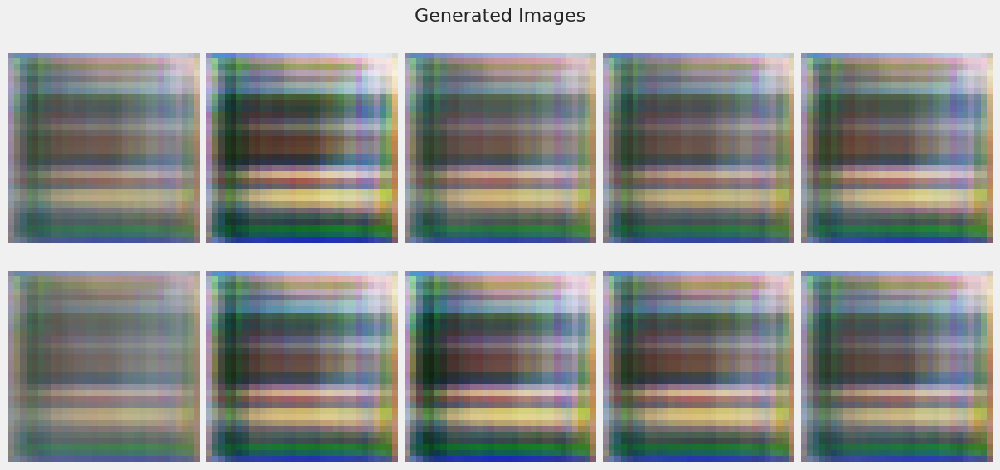

782/782 [==============================] - 15s 17ms/step - d_real_loss: 0.4452 - d_fake_loss: 0.5542 - g_loss: 2.0121 - d_acc: 0.7363 - d_realO: 0.3489 - d_fakeO: 0.6196
Epoch 2/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.5413 - d_fake_loss: 0.5135 - g_loss: 1.5627 - d_acc: 0.7282 - d_realO: 0.2425 - d_fakeO: 0.7760
Epoch 3/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.0083 - d_fake_loss: 0.0028 - g_loss: 6.0191 - d_acc: 0.9989 - d_realO: 0.0042 - d_fakeO: 0.9978
Epoch 4/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.0023 - d_fake_loss: 8.3712e-04 - g_loss: 7.5053 - d_acc: 0.9997 - d_realO: 0.0011 - d_fakeO: 0.9993
Epoch 5/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.0056 - d_fake_loss: 0.0010 - g_loss: 8.3154 - d_acc: 0.9993 - d_realO: 0.0021 - d_fakeO: 0.9988
Epoch 6/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.0015 - d_fak

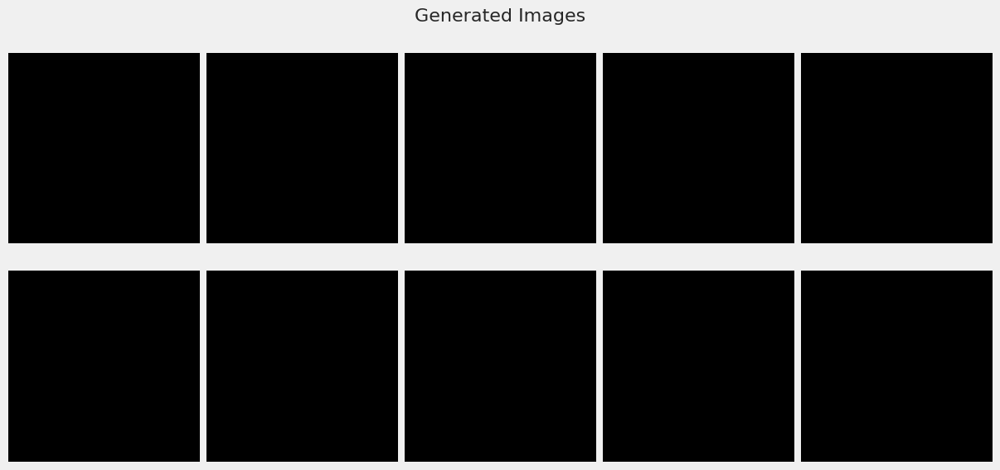

782/782 [==============================] - 13s 17ms/step - d_real_loss: 0.0015 - d_fake_loss: 0.0710 - g_loss: 9.9107 - d_acc: 0.9994 - d_realO: 0.0020 - d_fakeO: 0.9945
Epoch 12/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.0089 - d_fake_loss: 0.0020 - g_loss: 6.3175 - d_acc: 0.9985 - d_realO: 0.0034 - d_fakeO: 0.9983
Epoch 13/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.0018 - d_fake_loss: 0.0010 - g_loss: 7.2689 - d_acc: 0.9997 - d_realO: 0.0011 - d_fakeO: 0.9992
Epoch 14/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 7.8619e-04 - d_fake_loss: 3.8416e-04 - g_loss: 8.1841 - d_acc: 0.9999 - d_realO: 5.6986e-04 - d_fakeO: 0.9996
Epoch 15/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 5.5946e-04 - d_fake_loss: 2.3348e-04 - g_loss: 9.2224 - d_acc: 0.9999 - d_realO: 3.7304e-04 - d_fakeO: 0.9997
Epoch 16/100
782/782 [==============================] - 12s 15ms/step - d_

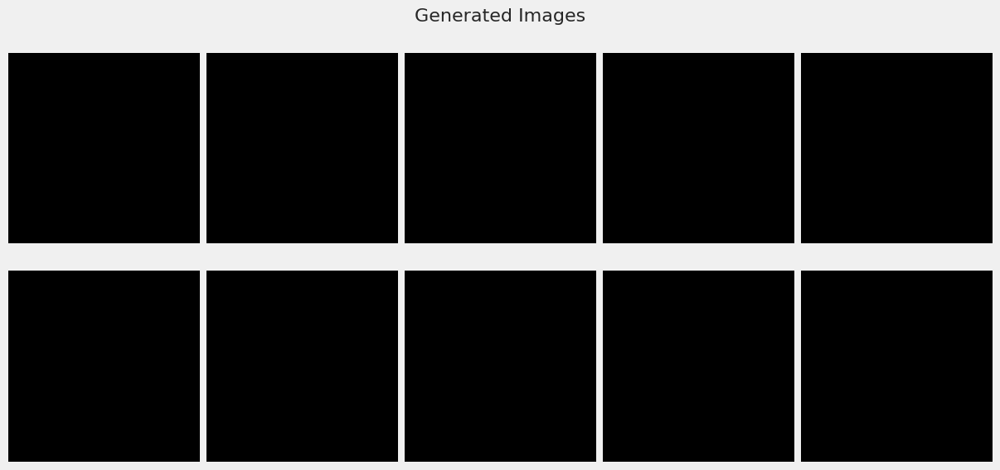

782/782 [==============================] - 13s 17ms/step - d_real_loss: 3.0215e-04 - d_fake_loss: 8.3962e-05 - g_loss: 11.4613 - d_acc: 1.0000 - d_realO: 2.6669e-04 - d_fakeO: 0.9998
Epoch 22/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 6.4550e-04 - d_fake_loss: 7.6054e-05 - g_loss: 13.8729 - d_acc: 1.0000 - d_realO: 3.0154e-04 - d_fakeO: 0.9998
Epoch 23/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 5.8492e-04 - d_fake_loss: 8.4427e-05 - g_loss: 13.0219 - d_acc: 1.0000 - d_realO: 4.2206e-04 - d_fakeO: 0.9996
Epoch 24/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 2.4732e-04 - d_fake_loss: 7.2532e-05 - g_loss: 10.2954 - d_acc: 1.0000 - d_realO: 1.6774e-04 - d_fakeO: 0.9999
Epoch 25/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.0021 - d_fake_loss: 3.7845e-04 - g_loss: 12.6694 - d_acc: 0.9999 - d_realO: 4.7859e-04 - d_fakeO: 0.9994
Epoch 26/100
782/782 [===============

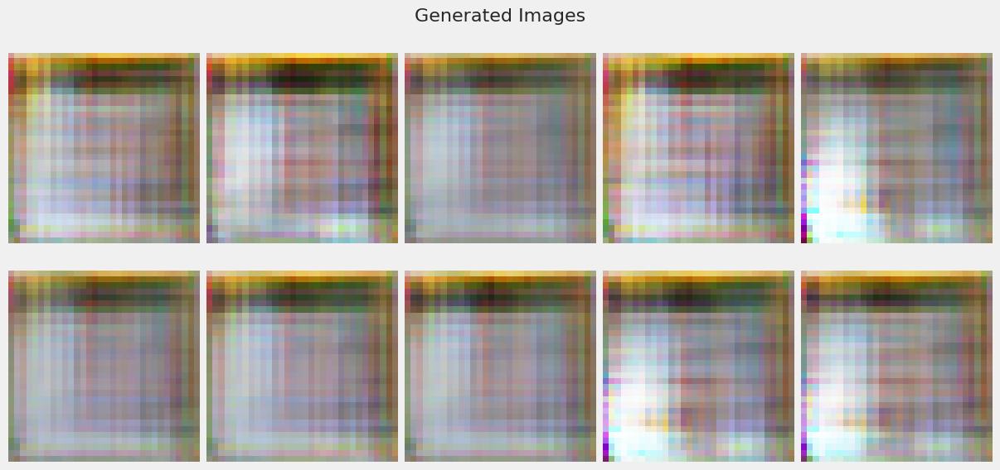

782/782 [==============================] - 13s 17ms/step - d_real_loss: 0.5409 - d_fake_loss: 0.6752 - g_loss: 9.1250 - d_acc: 0.9323 - d_realO: 0.1895 - d_fakeO: 0.8279
Epoch 32/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 1.6205 - d_fake_loss: 1.1944 - g_loss: 0.9669 - d_acc: 0.2935 - d_realO: 0.5360 - d_fakeO: 0.4311
Epoch 33/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6326 - d_fake_loss: 0.5023 - g_loss: 2.0113 - d_acc: 0.6885 - d_realO: 0.2126 - d_fakeO: 0.7945
Epoch 34/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.2444 - d_fake_loss: 0.2058 - g_loss: 4.2088 - d_acc: 0.8957 - d_realO: 0.2805 - d_fakeO: 0.7129
Epoch 35/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6546 - d_fake_loss: 0.5426 - g_loss: 1.5412 - d_acc: 0.7319 - d_realO: 0.3813 - d_fakeO: 0.6145
Epoch 36/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.8505 - d_fa

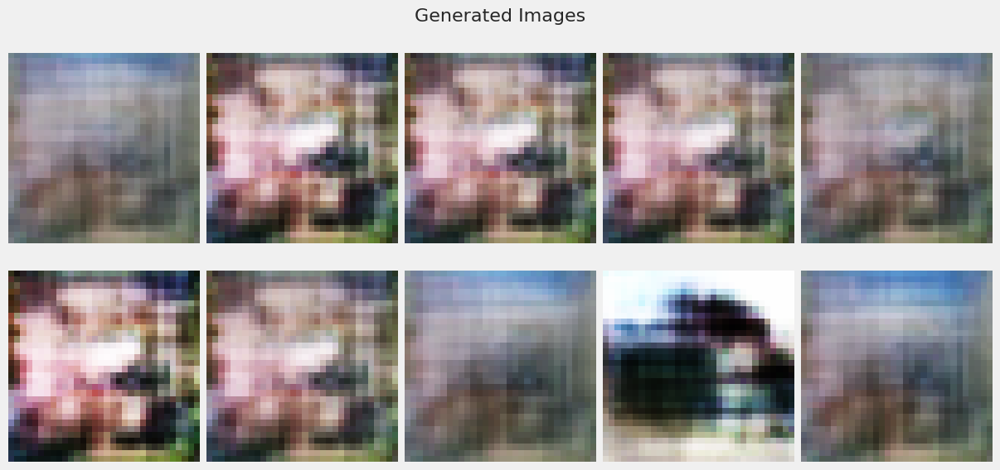

782/782 [==============================] - 13s 16ms/step - d_real_loss: 0.6968 - d_fake_loss: 0.6511 - g_loss: 1.0641 - d_acc: 0.5826 - d_realO: 0.4574 - d_fakeO: 0.5412
Epoch 42/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.7432 - d_fake_loss: 0.6971 - g_loss: 0.9669 - d_acc: 0.5241 - d_realO: 0.4888 - d_fakeO: 0.5122
Epoch 43/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.7039 - d_fake_loss: 0.6752 - g_loss: 0.9541 - d_acc: 0.5656 - d_realO: 0.4725 - d_fakeO: 0.5263
Epoch 44/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.7049 - d_fake_loss: 0.6846 - g_loss: 0.9079 - d_acc: 0.5467 - d_realO: 0.4787 - d_fakeO: 0.5206
Epoch 45/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.7013 - d_fake_loss: 0.6834 - g_loss: 0.8664 - d_acc: 0.5226 - d_realO: 0.4829 - d_fakeO: 0.5138
Epoch 46/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6866 - d_fa

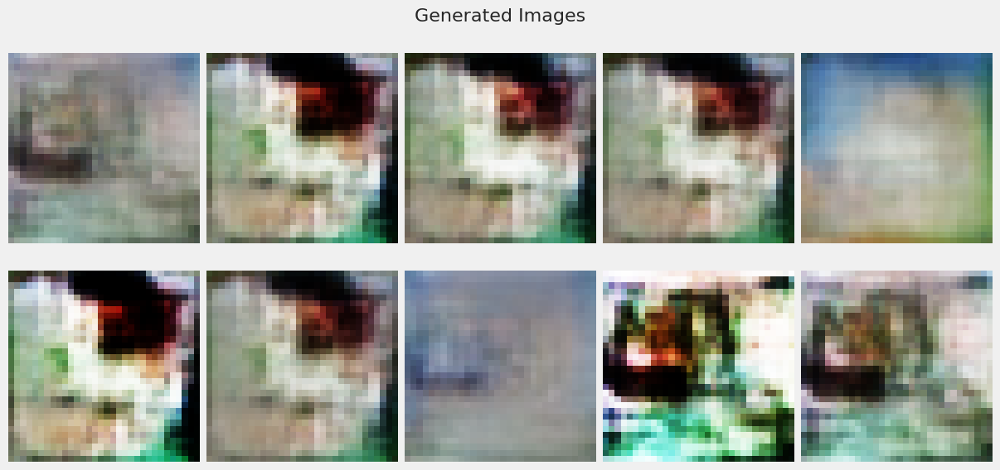

782/782 [==============================] - 13s 17ms/step - d_real_loss: 0.6923 - d_fake_loss: 0.6791 - g_loss: 0.8410 - d_acc: 0.5295 - d_realO: 0.4850 - d_fakeO: 0.5147
Epoch 52/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6889 - d_fake_loss: 0.6934 - g_loss: 0.8320 - d_acc: 0.5312 - d_realO: 0.4853 - d_fakeO: 0.5115
Epoch 53/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6844 - d_fake_loss: 0.6719 - g_loss: 0.8393 - d_acc: 0.5470 - d_realO: 0.4838 - d_fakeO: 0.5169
Epoch 54/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6814 - d_fake_loss: 0.6761 - g_loss: 0.8355 - d_acc: 0.5425 - d_realO: 0.4817 - d_fakeO: 0.5170
Epoch 55/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6936 - d_fake_loss: 0.6820 - g_loss: 0.8285 - d_acc: 0.5208 - d_realO: 0.4890 - d_fakeO: 0.5111
Epoch 56/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6819 - d_fa

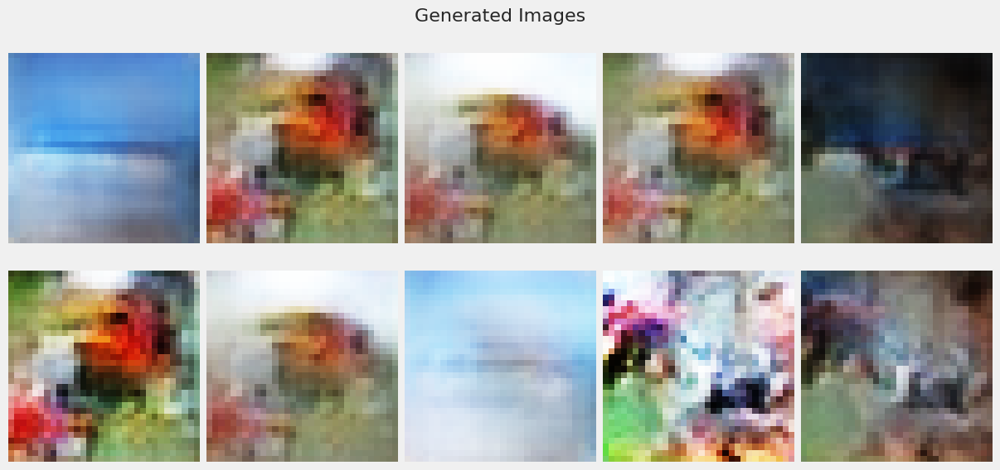

782/782 [==============================] - 13s 17ms/step - d_real_loss: 0.6889 - d_fake_loss: 0.6758 - g_loss: 0.8528 - d_acc: 0.5371 - d_realO: 0.4832 - d_fakeO: 0.5168
Epoch 62/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6790 - d_fake_loss: 0.6754 - g_loss: 0.8334 - d_acc: 0.5489 - d_realO: 0.4814 - d_fakeO: 0.5162
Epoch 63/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6932 - d_fake_loss: 0.6818 - g_loss: 0.8169 - d_acc: 0.5248 - d_realO: 0.4830 - d_fakeO: 0.5157
Epoch 64/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6796 - d_fake_loss: 0.6731 - g_loss: 0.8402 - d_acc: 0.5433 - d_realO: 0.4769 - d_fakeO: 0.5211
Epoch 65/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6818 - d_fake_loss: 0.6655 - g_loss: 0.8721 - d_acc: 0.5575 - d_realO: 0.4773 - d_fakeO: 0.5224
Epoch 66/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6782 - d_fa

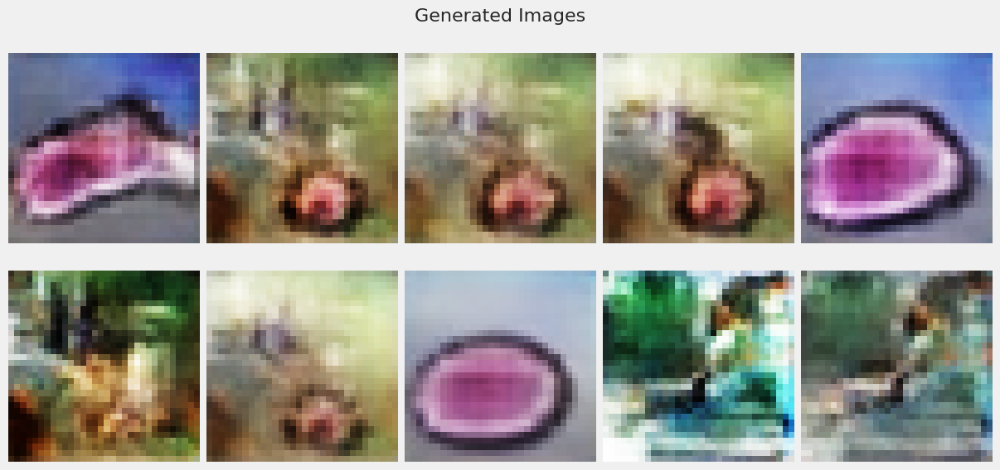

782/782 [==============================] - 13s 17ms/step - d_real_loss: 0.6910 - d_fake_loss: 0.6799 - g_loss: 0.8358 - d_acc: 0.5278 - d_realO: 0.4815 - d_fakeO: 0.5166
Epoch 72/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6899 - d_fake_loss: 0.6667 - g_loss: 0.8426 - d_acc: 0.5573 - d_realO: 0.4815 - d_fakeO: 0.5191
Epoch 73/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6711 - d_fake_loss: 0.6496 - g_loss: 0.8818 - d_acc: 0.5817 - d_realO: 0.4703 - d_fakeO: 0.5293
Epoch 74/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6835 - d_fake_loss: 0.6662 - g_loss: 0.8468 - d_acc: 0.5541 - d_realO: 0.4800 - d_fakeO: 0.5209
Epoch 75/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6873 - d_fake_loss: 0.6724 - g_loss: 0.8379 - d_acc: 0.5471 - d_realO: 0.4843 - d_fakeO: 0.5161
Epoch 76/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6979 - d_fa

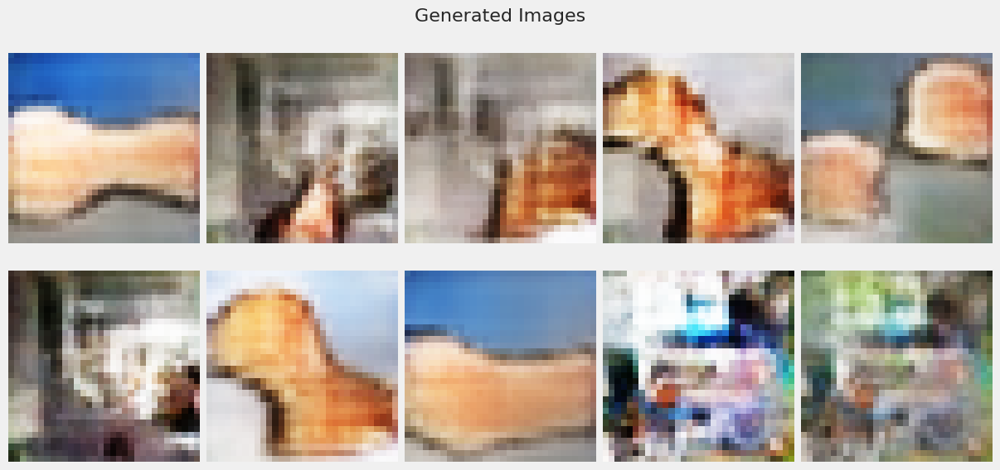

782/782 [==============================] - 13s 17ms/step - d_real_loss: 0.6854 - d_fake_loss: 0.6684 - g_loss: 0.8393 - d_acc: 0.5524 - d_realO: 0.4809 - d_fakeO: 0.5192
Epoch 82/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6856 - d_fake_loss: 0.6699 - g_loss: 0.8379 - d_acc: 0.5474 - d_realO: 0.4831 - d_fakeO: 0.5185
Epoch 83/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6937 - d_fake_loss: 0.6801 - g_loss: 0.8243 - d_acc: 0.5328 - d_realO: 0.4889 - d_fakeO: 0.5115
Epoch 84/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6824 - d_fake_loss: 0.6693 - g_loss: 0.8434 - d_acc: 0.5570 - d_realO: 0.4806 - d_fakeO: 0.5190
Epoch 85/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6846 - d_fake_loss: 0.6707 - g_loss: 0.8334 - d_acc: 0.5541 - d_realO: 0.4860 - d_fakeO: 0.5140
Epoch 86/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6869 - d_fa

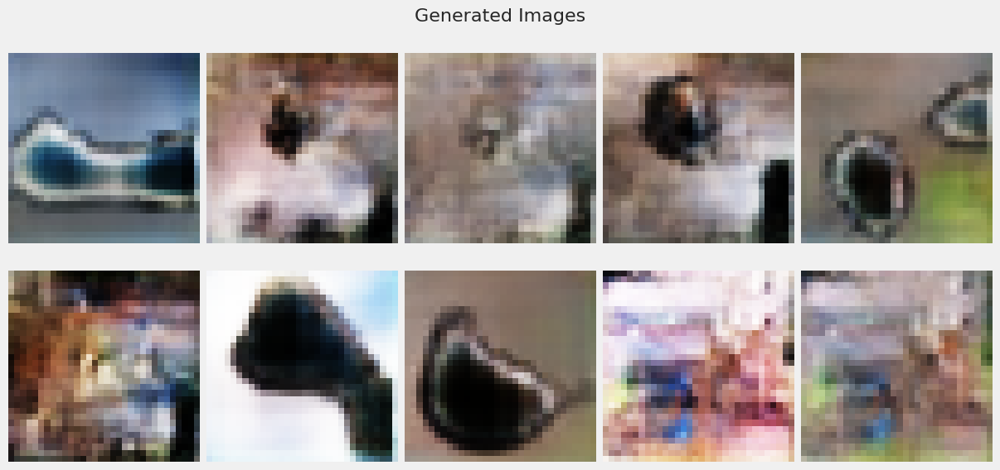

782/782 [==============================] - 13s 17ms/step - d_real_loss: 0.6882 - d_fake_loss: 0.6798 - g_loss: 0.8301 - d_acc: 0.5410 - d_realO: 0.4839 - d_fakeO: 0.5152
Epoch 92/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6725 - d_fake_loss: 0.6673 - g_loss: 0.8489 - d_acc: 0.5756 - d_realO: 0.4807 - d_fakeO: 0.5192
Epoch 93/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6837 - d_fake_loss: 0.6699 - g_loss: 0.8319 - d_acc: 0.5484 - d_realO: 0.4824 - d_fakeO: 0.5172
Epoch 94/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6747 - d_fake_loss: 0.6626 - g_loss: 0.8594 - d_acc: 0.5788 - d_realO: 0.4796 - d_fakeO: 0.5201
Epoch 95/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6854 - d_fake_loss: 0.6723 - g_loss: 0.8312 - d_acc: 0.5546 - d_realO: 0.4818 - d_fakeO: 0.5182
Epoch 96/100
782/782 [==============================] - 12s 15ms/step - d_real_loss: 0.6844 - d_fa

In [72]:
gan_5 = train_gan(discriminator_dcgan5, generator_dcgan5, noise, 'Baseline DCGAN 5', dataset, 100, callbacks=callbacks)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Looking at the accuracy, we can see that the discriminator ended with a  56% accuracy wwhich is pretty good
- No Model Collapse


</div>

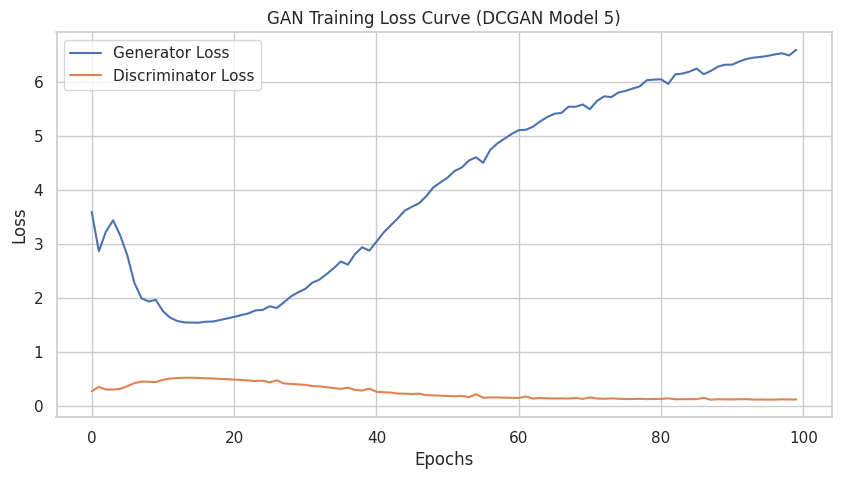

In [73]:
gan_history_4 = gan_4[0].history
generator = gan_4[1].generator  
gan_history_4['d_loss'] = [(real_loss + fake_loss) / 2 for real_loss, fake_loss in zip(gan_history_4['d_real_loss'], gan_history_4['d_fake_loss'])]
evaluator = Evaluation(generator, latent_dim, 512, 10000, 1024)
evaluator.plot_loss_curve(gan_history_4, title='GAN Training Loss Curve (DCGAN Model 5)')

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Discriminator loss
    - For the discriminator loss, it starts relatively low and rises quickly and continues to increase steadily as the epochs increases
- Generator loss
    - For the generator loss, it increases with a spike and drops and proceeded to increase slowly


</div>

In [74]:
tf.keras.backend.clear_session()
K.clear_session()
scores1 = evaluator.compute_metrics(x_train)
print('FID Score:', scores1[0])
print('KID Score:', scores1[1])

None
313/313 [==============================] - 1s 3ms/step
FID Score: 62.49949908043084
KID Score: 0.04777943029231757


<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- FID Score of 62 
- KID Score is 0.04
    
Both are not too good, showing this did not work

</div>

2/2 [==============================] - 1s 18ms/step


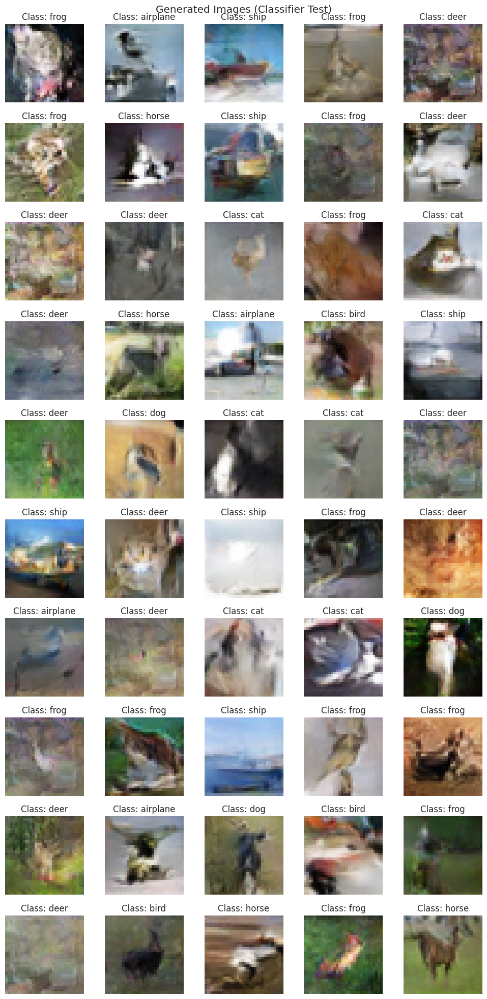

In [75]:
latent_dim = 128  
num_images = 50  
noise = tf.random.normal([num_images, latent_dim])
generated_images = generator.predict(noise)
generated_images = (generated_images + 1) / 2
generated_images = generated_images * 255
generated_images = np.clip(generated_images, 0, 255).astype('uint8')
generated_images_resized = tf.image.resize(generated_images, [224, 224]).numpy().astype('uint8')
predictions = model_c.predict(generated_images_resized)
predicted_classes = np.argmax(predictions, axis=-1)
num_columns = 5
num_rows = num_images // num_columns + (num_images % num_columns > 0)
fig, axes = plt.subplots(num_rows, num_columns, figsize=(num_columns * 2, num_rows * 2))
fig.suptitle('Generated Images (Classifier Test)')
for i, ax in enumerate(axes.flatten()):
    if i >= num_images:
        break
    ax.imshow(generated_images[i])
    ax.set_title(f'Class: {class_labels[predicted_classes[i]]}')
    ax.axis('off')
plt.tight_layout()
plt.show()

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- Generally, we can tell most of the animal images like deer, dog but cars and ships images are not poroduced

</div>

4/4 [==============================] - 0s 3ms/step


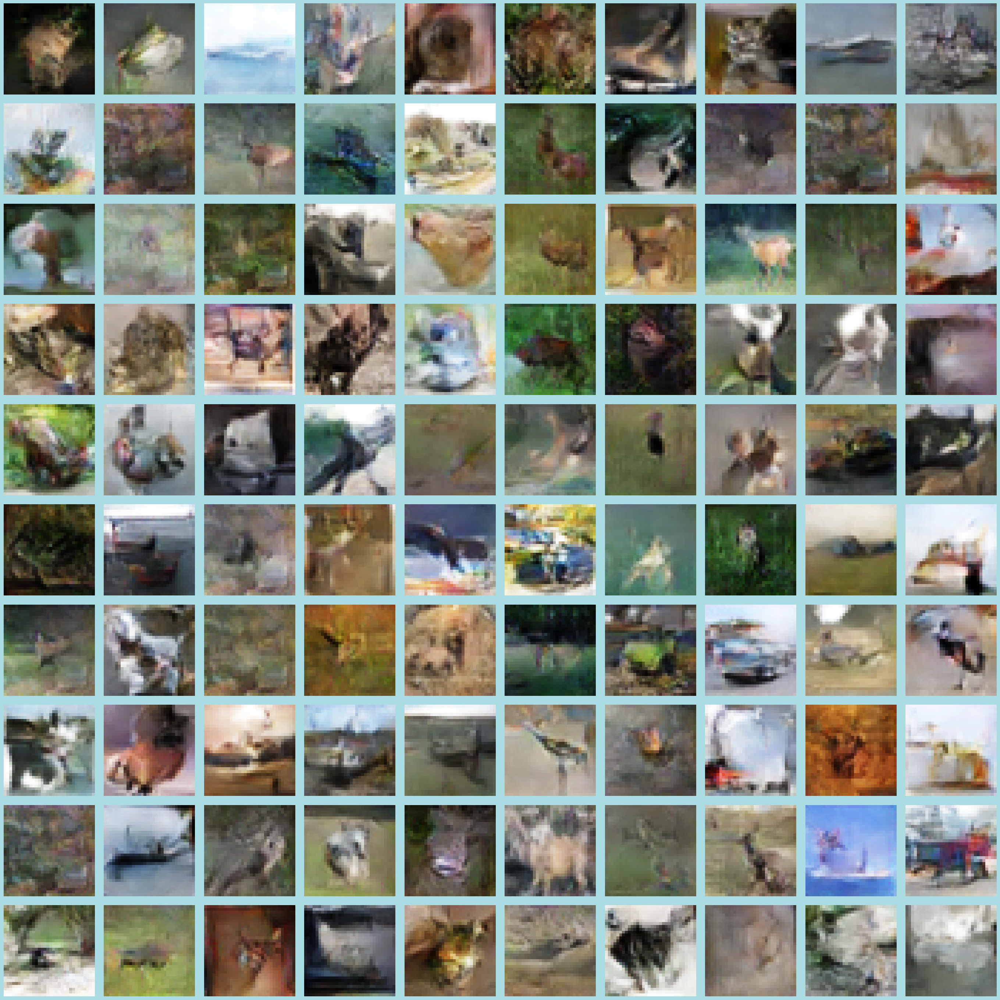

4/4 [==============================] - 0s 3ms/step


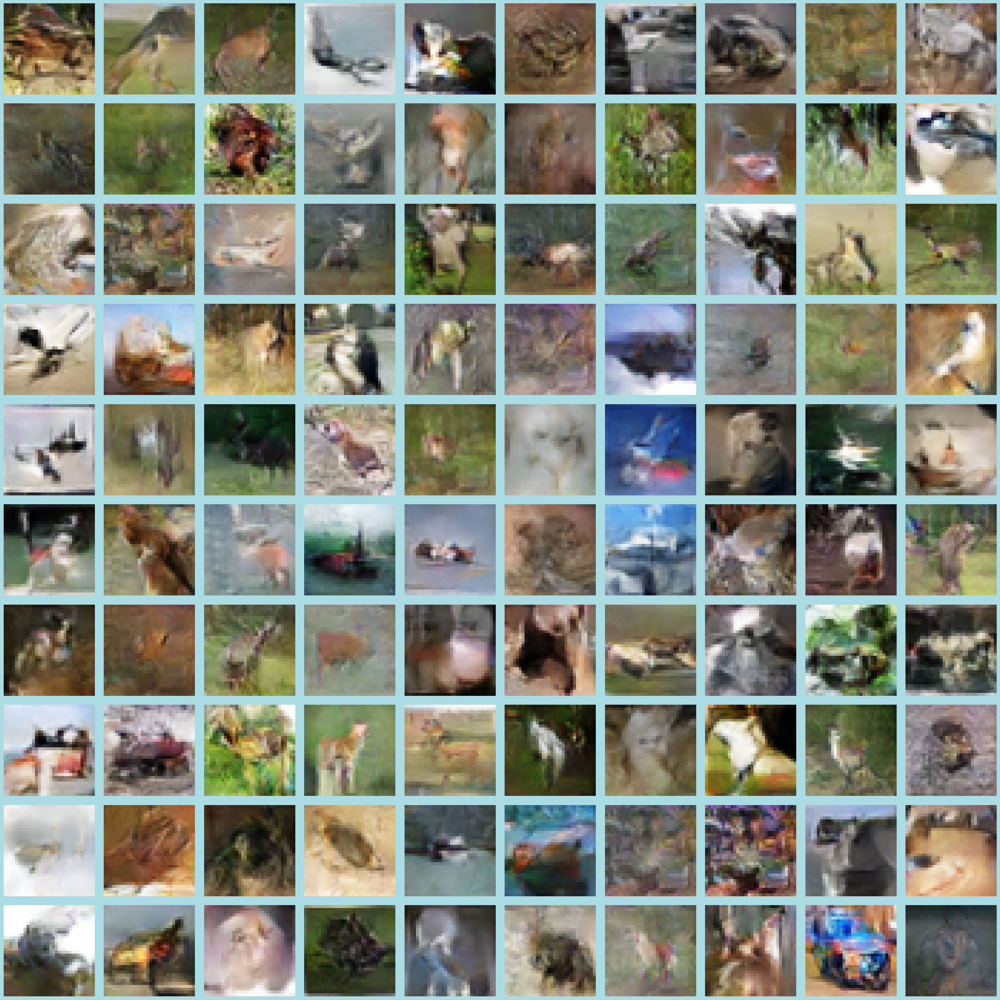

4/4 [==============================] - 0s 3ms/step


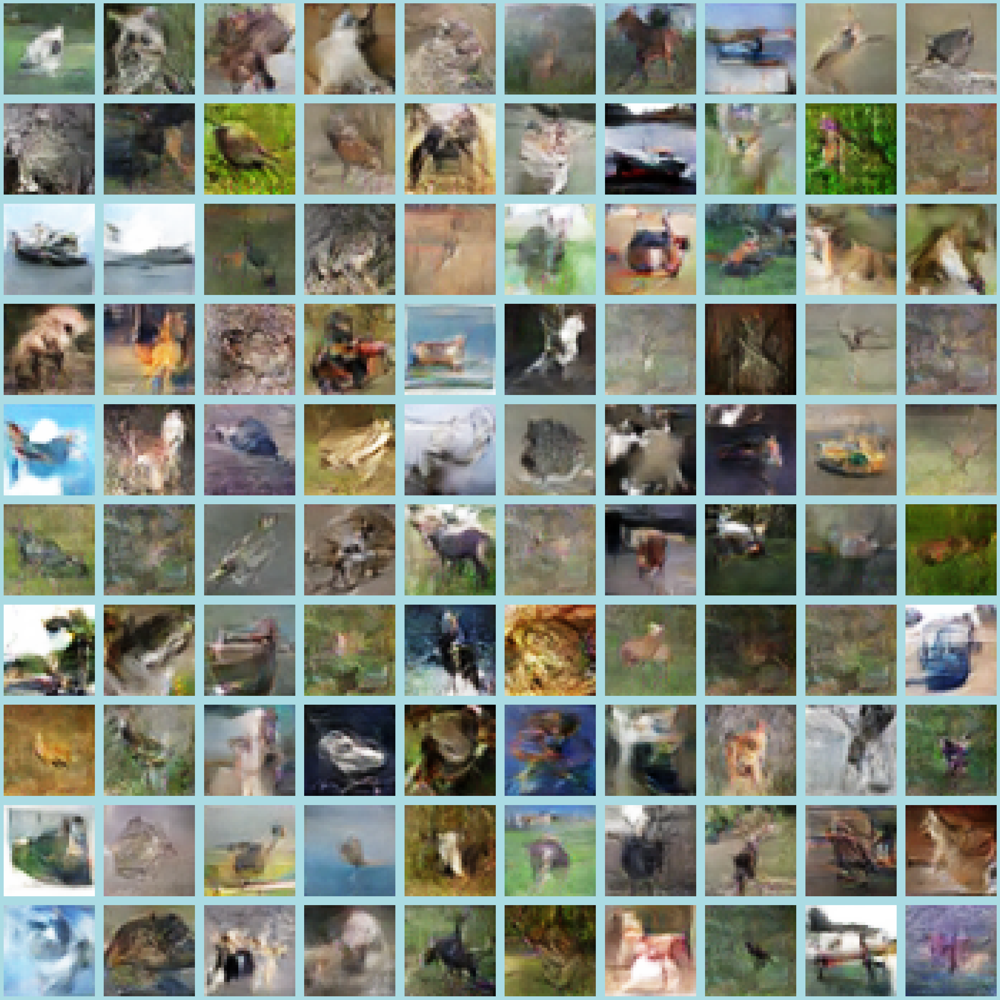

4/4 [==============================] - 0s 3ms/step


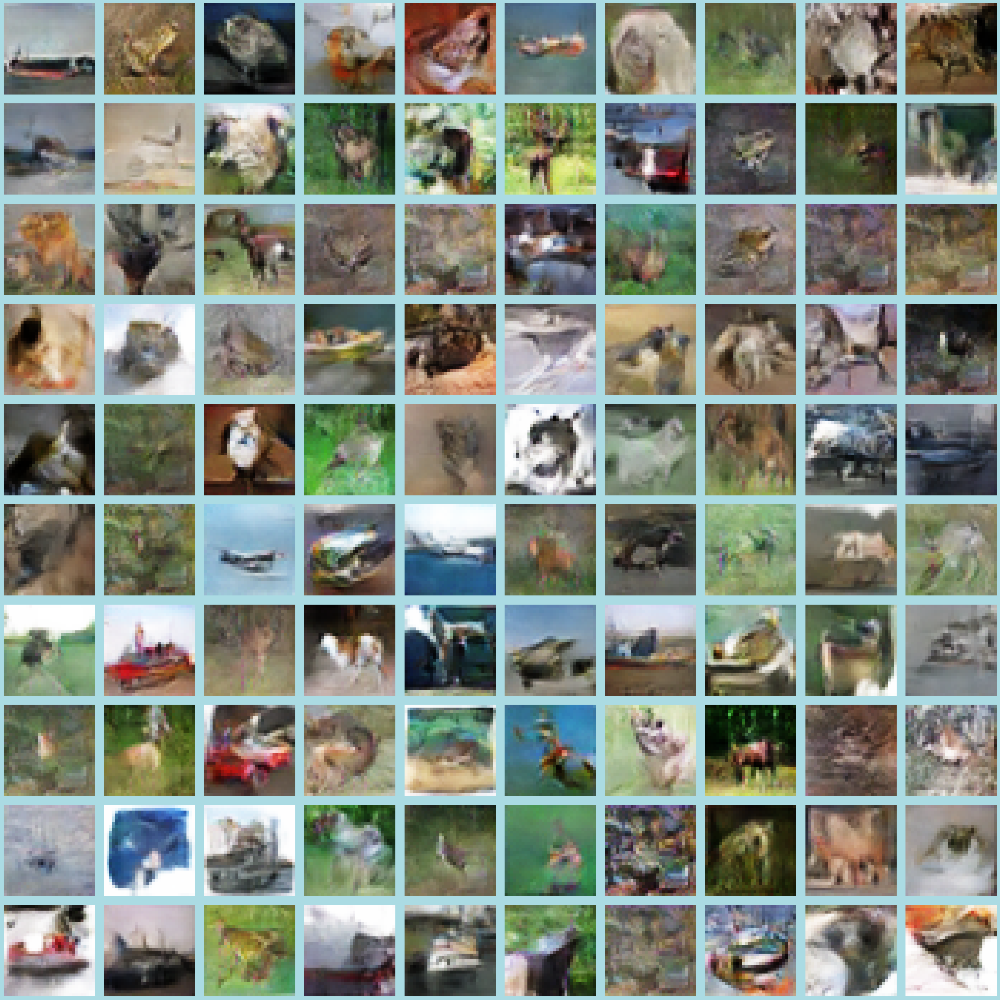

4/4 [==============================] - 0s 3ms/step


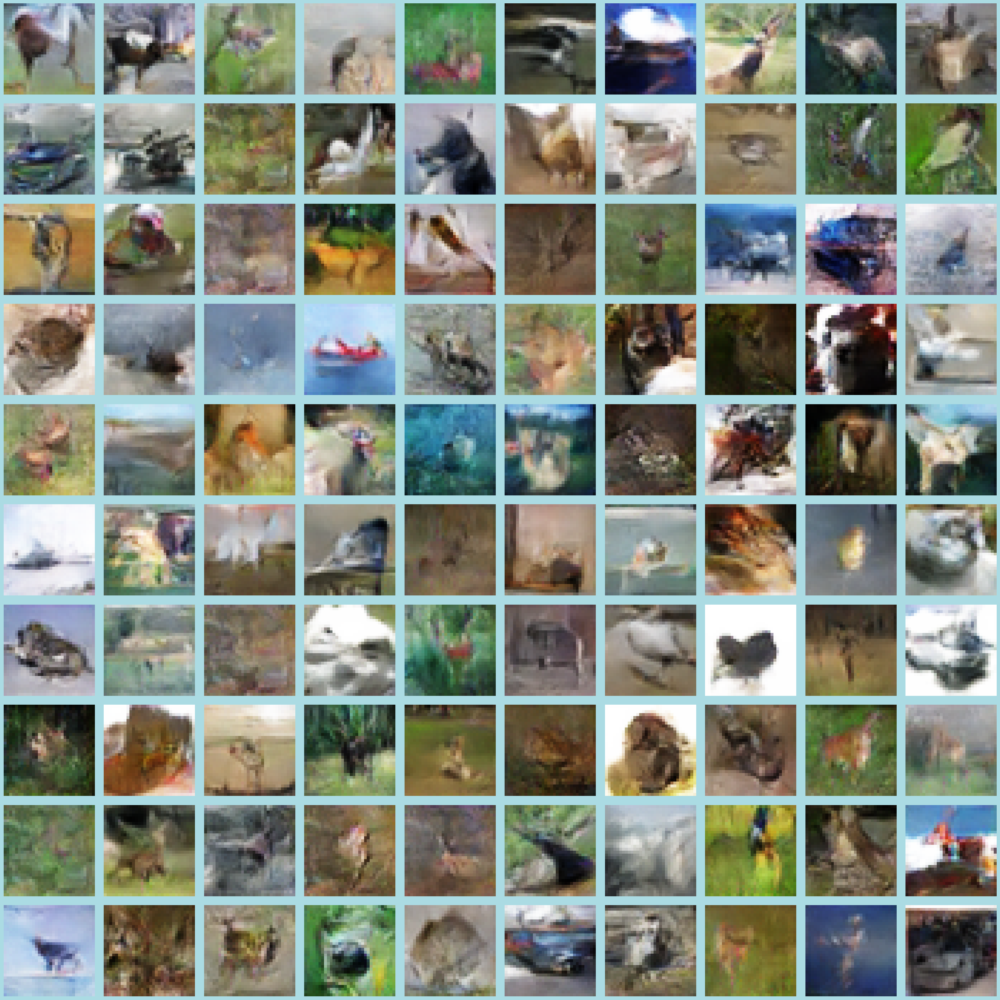

4/4 [==============================] - 0s 3ms/step


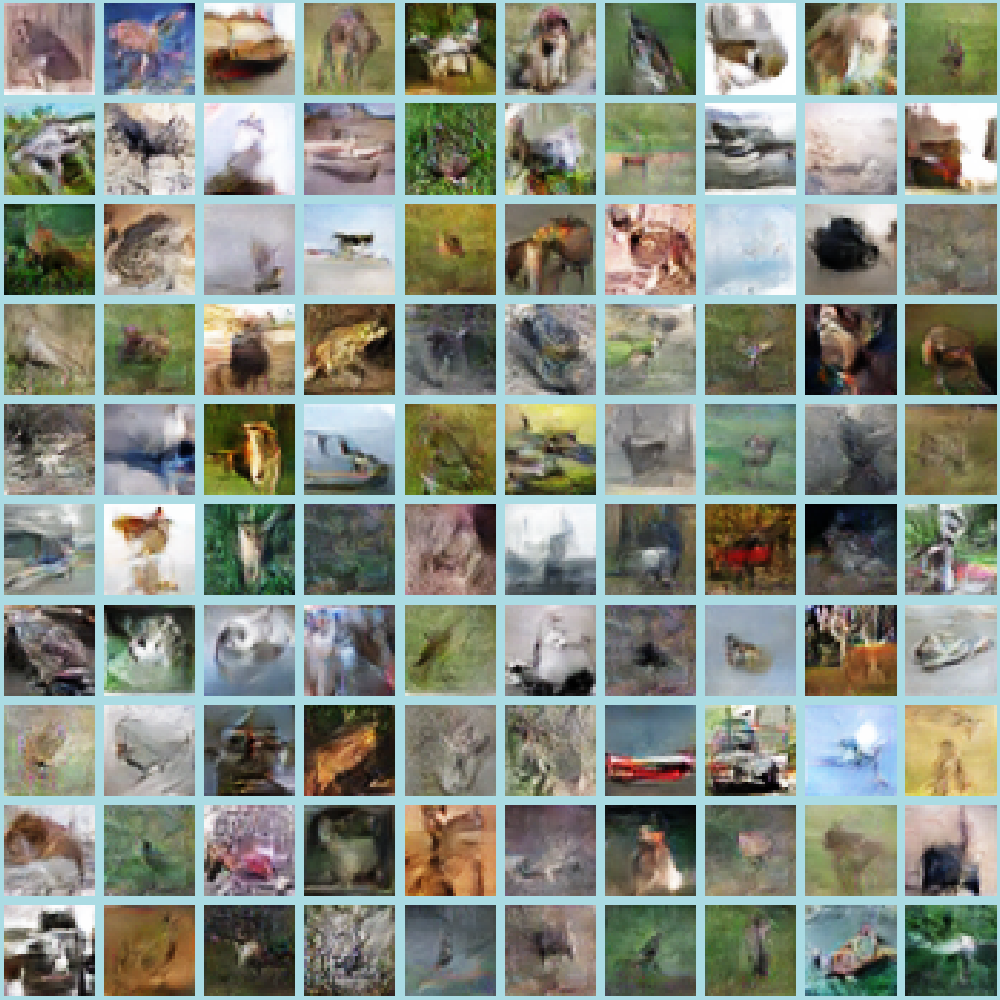

4/4 [==============================] - 0s 3ms/step


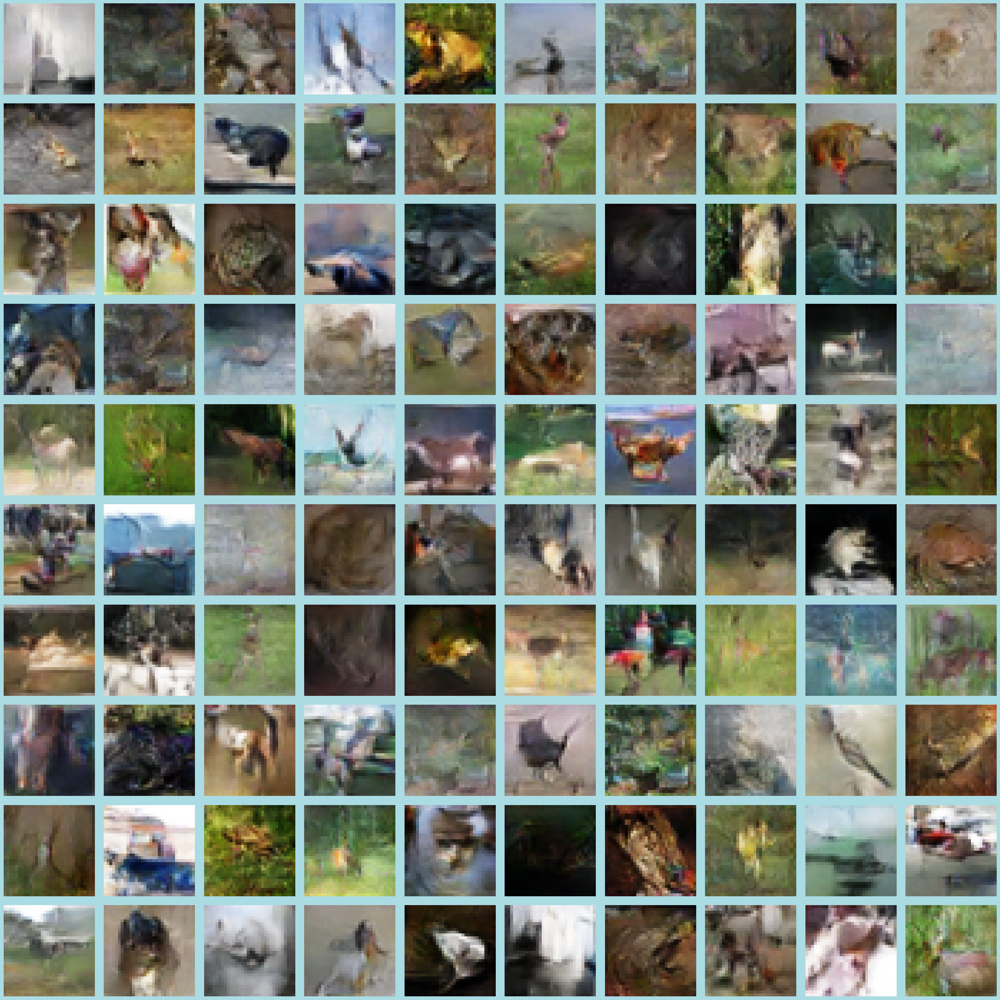

4/4 [==============================] - 0s 3ms/step


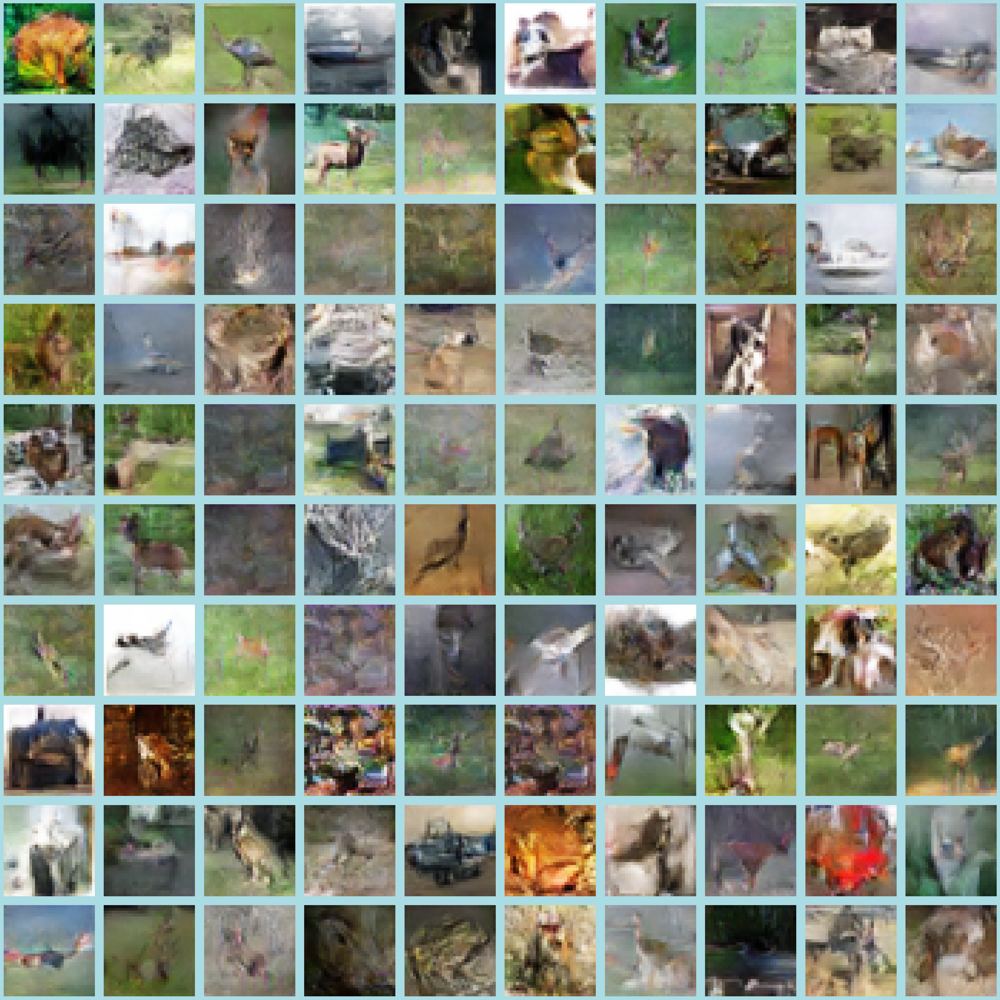

4/4 [==============================] - 0s 4ms/step


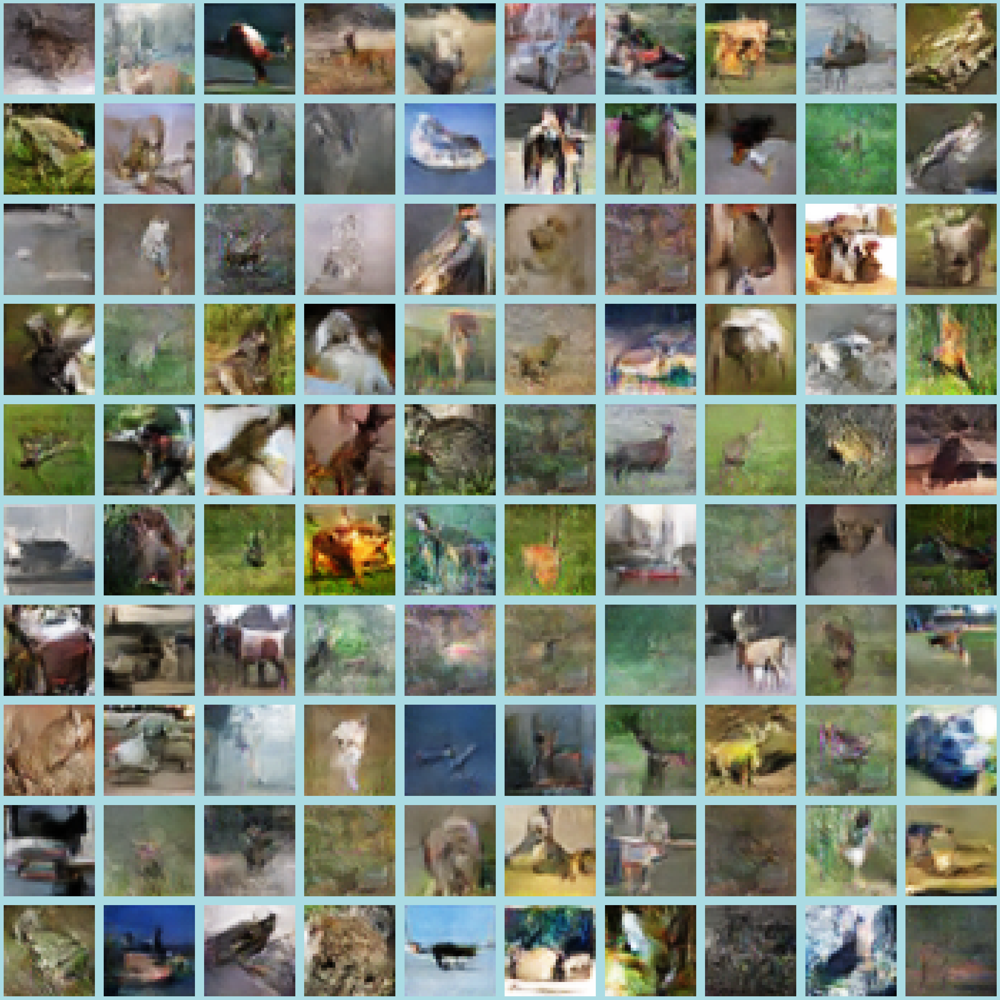

4/4 [==============================] - 0s 4ms/step


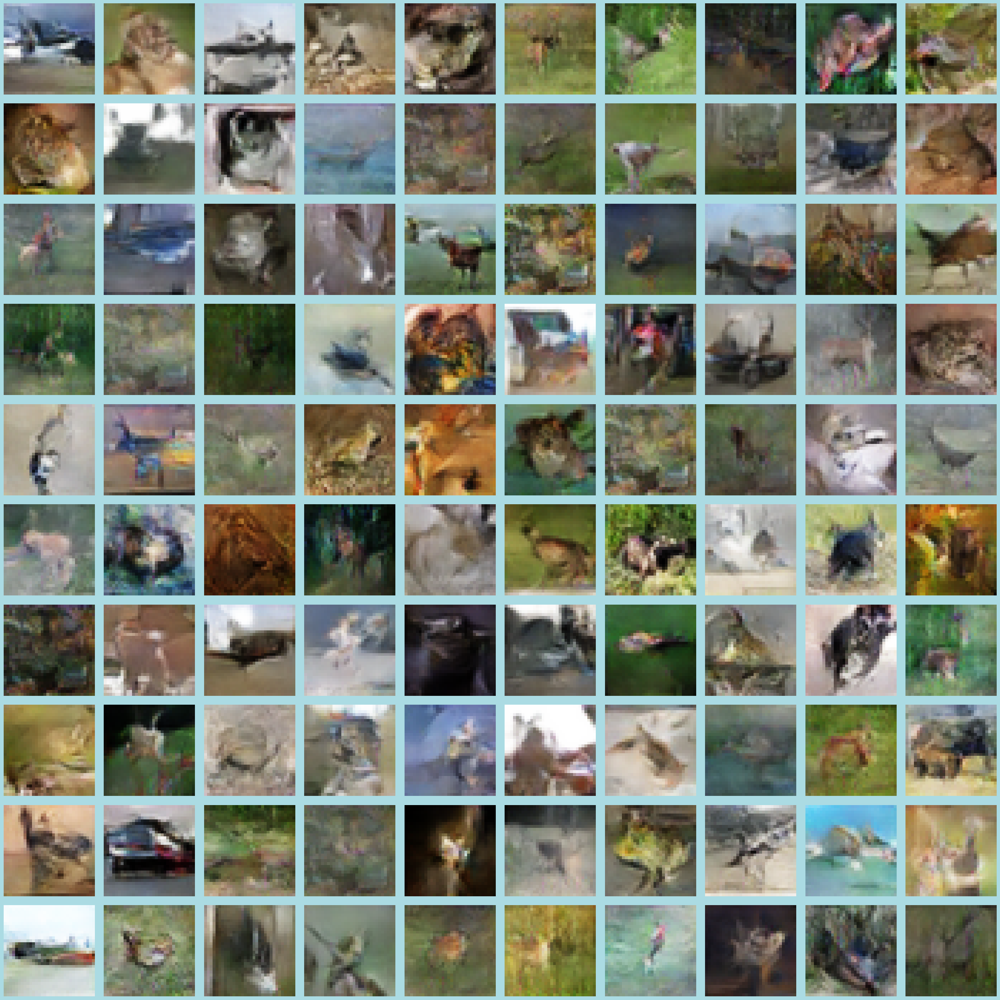

In [76]:
generate_1000(generator)

<div class="alert alert-block" style="background-color:#a7c6d6; padding: 10px; border: 3px solid lightblue; border-radius: 5px; color:black">
<u><b><i>Things Observed</i></b></u>
<ul>

- 1000 images provided similar idea compared to comparing it with a classifier

</div>

#### Storing the scores

In [77]:
new_row = {'Model':'Baseline DCGAN 5', 'FID':scores1[0], 'KID': scores1[1], 'd_loss':gan_history_4['d_loss'][-1], 'g_loss':gan_history_4['g_loss'][-1] }
new_df = pd.DataFrame([new_row])
full_scores = pd.concat([full_scores, new_df], ignore_index=True)
full_scores

,Model,FID,KID,d_loss,g_loss
0,Baseline DCGAN 1,53.235623,0.039666,0.229398,3.687913
1,Baseline DCGAN 2,54.338184,0.041610,0.275021,3.177531
2,Baseline DCGAN 3,47.789308,0.030753,0.683071,0.757343
3,Baseline DCGAN 4,61.771299,0.047135,0.123955,6.587285
4,Baseline DCGAN 5,62.499499,0.047779,0.123955,6.587285


### __Best DCGAN Model__

1. Best Model is the DCGAN 3 of FID 47

### Store All Results

In [78]:
full_scores.to_csv('full_scores1.csv')